# Genomic Scan Plots

In [1]:
library(data.table)
library(tidyverse)
library(foreach)
library(gridExtra)
# library(patchwork)
library(viridis)
setwd('~/snap_hap_repHZ/genome_scans/')
source('~/snap_hap_repHZ/genome_scans/_scripts/functions_genomescans.R')
plot_theme <- theme_bw() + theme(panel.grid = element_blank())

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.4.4     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::between()     masks data.table::between()
✖ dplyr::filter()      masks stats::filter()
✖ dplyr::first()       masks data.table::first()
✖ lubridate::hour()    masks data.table::hour()
✖ lubridate::isoweek() masks data.table::isoweek()
✖ dplyr::lag()         masks stats::lag()
✖ dplyr::last()        masks data.table::last()
✖ lubridate::mday()    masks data.table::mday()
✖ lubridate::minute()  masks data.table::minute()
✖ lubridate::month()   masks data.table::month()
✖ lubridate::quarter() masks data.table::quarter()
✖ lubridate::second()  masks data.table::second()
✖ purrr::transpose()   masks data.table::transpose()
✖ lubridate::wday() 

## Functions

In [2]:
modify_for_ManhattanPlot = function(dat){
    dat %>% 
        # Compute chromosome size
        group_by(scaffold) %>% summarise(chromLength = max(end)) %>% 
    
        # Calculate cumulative position of each chromosome
        mutate(total = cumsum(chromLength)-chromLength) %>% select(-chromLength) %>%
    
        # Add this info to the initial dataset
        left_join(dat, ., by=c("scaffold"="scaffold")) %>%
    
        # Add a cumulative position of each SNP
        arrange(scaffold, end) %>%
        mutate(midCum = mid+total)
}

In [3]:
axis_for_ManhattanPlot = function(modified_dat, col1, col2){
    modified_dat %>%
        group_by(scaffold) %>% summarize(chromCenter = (max(midCum, na.rm=T) + min(midCum, na.rm=T))/2) %>%
        mutate(col = rep(c(col1, col2), 4))
}

In [4]:
## -----
loess.smooth.weights = function(position, value, sites, span, family){
    y.loess <- loess(value ~ position, span = span, weights = sites, family=family)
    y.predict <- predict(y.loess, position)
    y.predict
}

## Read files & modify

In [5]:
AvePla_w10KBs10KB = foreach(chrom=c(1:8), .combine=rbind) %do% {
    file=paste0('./AvePla/Ave-Pla_Chr',chrom,'_byPos_w10000_s10000.csv.gz')
    dat = fread(file)
    return(dat)
}

AvePlaFRYe_w10KBs10KB = foreach(chrom=c(1:8), .combine=rbind) %do% {
    file=paste0('./AvePla-FRYe/AveFR-AveY-PlaFR-PlaY_Chr',chrom,'_byPos_w10000_s10000.csv.gz')
    dat = fread(file)
    return(dat)
}

AvePlaFRYe_w3KBs300b = foreach(chrom=c(1:8), .combine=rbind) %do% {
    file=paste0('./AvePla-FRYe/AveFR-AveY-PlaFR-PlaY_Chr',chrom,'_byPos_w3000_s300.csv.gz')
    dat = fread(file)
    return(dat)
}

Warning message in fread(file):
“Discarded single-line footer: <<160613,Chr1,48183601,48186600,48185458,58,0.2361,0.3>>”
Warning message in fread(file):
“Discarded single-line footer: <<162496,Chr2,48748501,48751500,48749933,38,0.1879,0.1587,0.1441,0.1893,0.1879,0.1681,0.1903,0.1668,0.1907,0.1679,0.041,0.0065,0.0045,0.0>>”
Warning message in fread(file):
“Discarded single-line footer: <<186043,Chr3,55812601,55815600,55814724,53,0.3632,0.1607,0.2268,0.1775,0.3306,0.>>”
Warning message in fread(file):
“Discarded single-line footer: <<165142,Chr5,49542301,49545300,4954>>”


In [6]:
AvePla_w10KBs10KB = modify_for_ManhattanPlot(AvePla_w10KBs10KB)
AvePlaFRYe_w10KBs10KB = modify_for_ManhattanPlot(AvePlaFRYe_w10KBs10KB)
AvePlaFRYe_w3KBs300b = modify_for_ManhattanPlot(AvePlaFRYe_w3KBs300b)

In [7]:
# axisToPlot = axis_for_ManhattanPlot(AvePlaFRYe_w10KBs10KB, 'grey10','grey80')
axisToPlot = axis_for_ManhattanPlot(AvePlaFRYe_w10KBs10KB, 'grey10','grey80')

In [8]:
# str(AvePla_w10KBs10KB)
str(AvePlaFRYe_w10KBs10KB)
# str(AvePlaFRYe_w3KBs300b)

Classes ‘data.table’ and 'data.frame':	50881 obs. of  24 variables:
 $ windowID       : int  1 2 3 4 5 6 7 8 9 10 ...
 $ scaffold       : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ start          : int  1 10001 20001 30001 40001 50001 60001 70001 80001 90001 ...
 $ end            : int  10000 20000 30000 40000 50000 60000 70000 80000 90000 100000 ...
 $ mid            : num  7311 15387 24812 31845 NaN ...
 $ sites          : int  118 126 227 53 0 20 209 199 219 152 ...
 $ pi_AveFR       : num  0.278 0.233 0.228 0.257 NaN ...
 $ pi_AveY        : num  0.324 0.23 0.221 0.278 NaN ...
 $ pi_PlaFR       : num  0.287 0.202 0.22 0.225 NaN ...
 $ pi_PlaY        : num  0.28 0.234 0.252 0.192 NaN ...
 $ dxy_AveFR_AveY : num  0.309 0.236 0.234 0.274 NaN ...
 $ dxy_AveFR_PlaFR: num  0.281 0.224 0.227 0.244 NaN ...
 $ dxy_AveFR_PlaY : num  0.281 0.238 0.247 0.242 NaN ...
 $ dxy_AveY_PlaFR : num  0.313 0.233 0.232 0.259 NaN ...
 $ dxy_AveY_PlaY  : num  0.315 0.248 0.257 0.252 NaN ...
 $ dxy_PlaFR_PlaY :

In [9]:
AvePlaFRYe_w10KBs10KB[scaffold=='Chr1'][1]$total
AvePlaFRYe_w10KBs10KB[scaffold=='Chr2'][1]$total
AvePlaFRYe_w10KBs10KB[scaffold=='Chr3'][1]$total
AvePlaFRYe_w10KBs10KB[scaffold=='Chr4'][1]$total
AvePlaFRYe_w10KBs10KB[scaffold=='Chr5'][1]$total
AvePlaFRYe_w10KBs10KB[scaffold=='Chr6'][1]$total
AvePlaFRYe_w10KBs10KB[scaffold=='Chr7'][1]$total
AvePlaFRYe_w10KBs10KB[scaffold=='Chr8'][1]$total

[1] 0

[1] 71920000

[1] 149040000

[1] 214260000

[1] 269150000

[1] 340140000

[1] 395840000

[1] 451400000

In [10]:
# str(axisToPlot)
print(axisToPlot)

# A tibble: 8 × 3
  scaffold chromCenter col   
  <chr>          <dbl> <chr> 
1 Chr1       35959973  grey10
2 Chr2      110481039  grey80
3 Chr3      181659543  grey10
4 Chr4      241702345  grey80
5 Chr5      304644325  grey10
6 Chr6      367995190. grey80
7 Chr7      423619885  grey10
8 Chr8      480104466. grey80


## General stats

In [54]:
str(AvePlaFRYe_w10KBs10KB)

Classes ‘data.table’ and 'data.frame':	50881 obs. of  24 variables:
 $ windowID       : int  1 2 3 4 5 6 7 8 9 10 ...
 $ scaffold       : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ start          : int  1 10001 20001 30001 40001 50001 60001 70001 80001 90001 ...
 $ end            : int  10000 20000 30000 40000 50000 60000 70000 80000 90000 100000 ...
 $ mid            : num  7311 15387 24812 31845 NaN ...
 $ sites          : int  118 126 227 53 0 20 209 199 219 152 ...
 $ pi_AveFR       : num  0.278 0.233 0.228 0.257 NaN ...
 $ pi_AveY        : num  0.324 0.23 0.221 0.278 NaN ...
 $ pi_PlaFR       : num  0.287 0.202 0.22 0.225 NaN ...
 $ pi_PlaY        : num  0.28 0.234 0.252 0.192 NaN ...
 $ dxy_AveFR_AveY : num  0.309 0.236 0.234 0.274 NaN ...
 $ dxy_AveFR_PlaFR: num  0.281 0.224 0.227 0.244 NaN ...
 $ dxy_AveFR_PlaY : num  0.281 0.238 0.247 0.242 NaN ...
 $ dxy_AveY_PlaFR : num  0.313 0.233 0.232 0.259 NaN ...
 $ dxy_AveY_PlaY  : num  0.315 0.248 0.257 0.252 NaN ...
 $ dxy_PlaFR_PlaY :

In [70]:
datFst = AvePlaFRYe_w10KBs10KB[sites>=20] %>% head(15)
datFst$Fst_AveFR_AveY

windowID,scaffold,start,end,mid,sites,pi_AveFR,pi_AveY,pi_PlaFR,pi_PlaY,⋯,dxy_AveY_PlaY,dxy_PlaFR_PlaY,Fst_AveFR_AveY,Fst_AveFR_PlaFR,Fst_AveFR_PlaY,Fst_AveY_PlaFR,Fst_AveY_PlaY,Fst_PlaFR_PlaY,total,midCum
<int>,<chr>,<int>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<dbl>
1,Chr1,1,10000,7311,118,0.2783,0.3238,0.2873,0.2800,⋯,0.3150,0.2821,0.0130,-0.0040,0.0024,0.0116,0.0214,-0.0029,0,7311
2,Chr1,10001,20000,15387,126,0.2331,0.2298,0.2019,0.2337,⋯,0.2476,0.2203,0.0092,0.0140,0.0105,0.0386,0.0334,0.0057,0,15387
3,Chr1,20001,30000,24812,227,0.2277,0.2208,0.2203,0.2515,⋯,0.2571,0.2380,0.0206,0.0057,0.0161,0.0265,0.0432,0.0045,0,24812
4,Chr1,30001,40000,31845,53,0.2572,0.2778,0.2251,0.1916,⋯,0.2516,0.2114,0.0124,0.0055,0.0382,0.0142,0.0350,0.0074,0,31845
6,Chr1,50001,60000,57606,20,0.3011,0.2844,0.2328,0.2207,⋯,0.3143,0.2333,0.0333,-0.0038,0.0083,0.0486,0.1098,0.0145,0,57606
7,Chr1,60001,70000,65124,209,0.2465,0.2783,0.1790,0.1038,⋯,0.2420,0.1439,0.0225,0.0134,0.0505,0.0626,0.1178,0.0090,0,65124
8,Chr1,70001,80000,75659,199,0.2562,0.2952,0.1779,0.1429,⋯,0.2834,0.1655,0.0388,0.0220,0.0512,0.0857,0.1284,0.0159,0,75659
9,Chr1,80001,90000,85702,219,0.3590,0.3787,0.3362,0.3214,⋯,0.3959,0.3332,0.0044,0.0184,0.0464,0.0362,0.0621,0.0067,0,85702
10,Chr1,90001,100000,95445,152,0.3873,0.3658,0.3489,0.3528,⋯,0.3928,0.3538,0.0059,0.0045,0.0176,0.0286,0.0450,0.0042,0,95445


### Simple stats

In [55]:
nrow(AvePlaFRYe_w10KBs10KB)
nrow(AvePlaFRYe_w10KBs10KB[sites >= 20])

[1] 50881

[1] 47375

In [15]:
## PlaM vs PlaY
median(AvePlaFRYe_w10KBs10KB$Fst_PlaFR_PlaY, na.rm=T)
sd(AvePlaFRYe_w10KBs10KB$Fst_PlaFR_PlaY, na.rm=T)

# summary(AvePlaFRYe_w10KBs10KB$Fst_PlaFR_PlaY, na.rm=T)
per99 = quantile(AvePlaFRYe_w10KBs10KB$Fst_PlaFR_PlaY, na.rm=T, probs=0.99)
per99
nrow(AvePlaFRYe_w10KBs10KB[Fst_PlaFR_PlaY >= 0.0474])

[1] 0.0083

[1] 0.0105946

99% 
0.0474

[1] 494

[1] 34

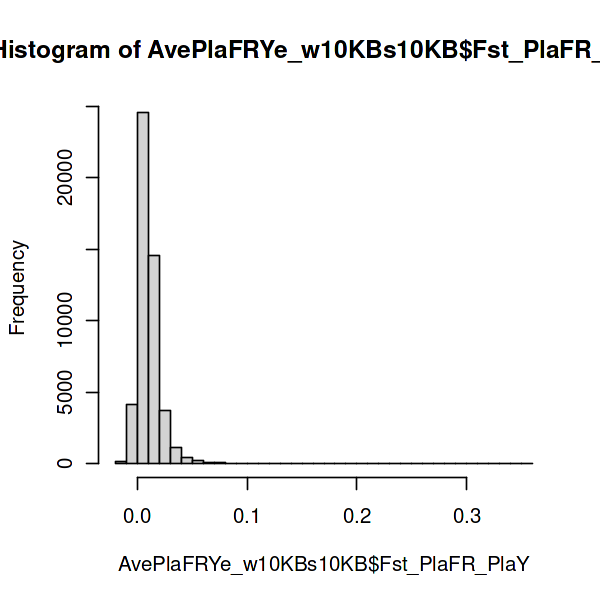

In [16]:
options(repr.plot.width=5, repr.plot.height=5)
hist(AvePlaFRYe_w10KBs10KB$Fst_PlaFR_PlaY, breaks=50)
sum(AvePlaFRYe_w10KBs10KB$Fst_PlaFR_PlaY>0.1, na.rm=T)

In [17]:
## AveM vs AveY
median(AvePlaFRYe_w10KBs10KB$Fst_AveFR_AveY, na.rm=T)
sd(AvePlaFRYe_w10KBs10KB$Fst_AveFR_AveY, na.rm=T)

# summary(AvePlaFRYe_w10KBs10KB$Fst_AveFR_AveY, na.rm=T)
per99 = quantile(AvePlaFRYe_w10KBs10KB$Fst_AveFR_AveY, na.rm=T, probs=0.99)
nrow(AvePlaFRYe_w10KBs10KB[Fst_AveFR_AveY >= per99])

[1] 0.0281

[1] 0.06483734

[1] 491

[1] 5014

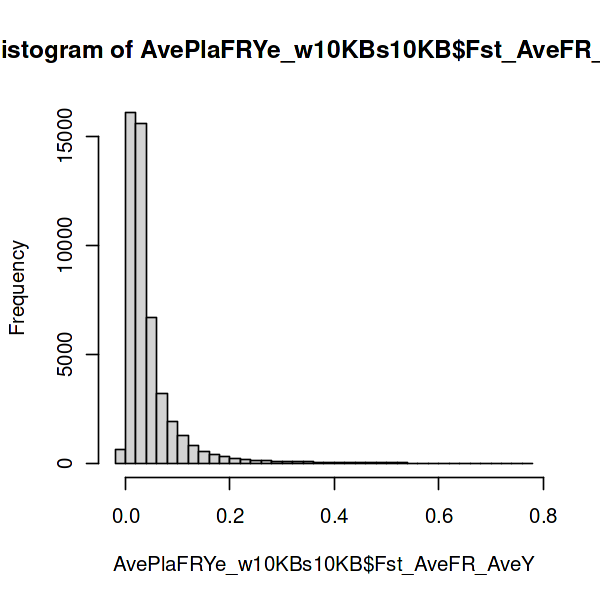

In [18]:
options(repr.plot.width=5, repr.plot.height=5)
hist(AvePlaFRYe_w10KBs10KB$Fst_AveFR_AveY, breaks=50)
sum(AvePlaFRYe_w10KBs10KB$Fst_AveFR_AveY>0.1, na.rm=T)

In [18]:
sum(AvePlaFRYe_w10KBs10KB$Fst_AveFR_AveY > AvePlaFRYe_w10KBs10KB$Fst_PlaFR_PlaY, na.rm=T)

[1] 42574

### mean whole genome Fst from 10-kb estimates

In [67]:
## Estimates with all windows
datFst = AvePlaFRYe_w10KBs10KB

mean(datFst$Fst_AveFR_AveY, na.rm=T) %>% signif(4)
mean(datFst$Fst_AveFR_PlaFR, na.rm=T) %>% signif(4)
mean(datFst$Fst_AveFR_PlaY, na.rm=T) %>% signif(4)
mean(datFst$Fst_AveY_PlaFR, na.rm=T) %>% signif(4)
mean(datFst$Fst_AveY_PlaY, na.rm=T) %>% signif(4)
mean(datFst$Fst_PlaFR_PlaY, na.rm=T) %>% signif(4)

[1] 0.04782

[1] 0.0286

[1] 0.03066

[1] 0.06643

[1] 0.06757

[1] 0.0102

In [68]:
## Estimates with all windows
datFst = AvePlaFRYe_w10KBs10KB[sites >= 20]

mean(datFst$Fst_AveFR_AveY, na.rm=T) %>% signif(4)
mean(datFst$Fst_AveFR_PlaFR, na.rm=T) %>% signif(4)
mean(datFst$Fst_AveFR_PlaY, na.rm=T) %>% signif(4)
mean(datFst$Fst_AveY_PlaFR, na.rm=T) %>% signif(4)
mean(datFst$Fst_AveY_PlaY, na.rm=T) %>% signif(4)
mean(datFst$Fst_PlaFR_PlaY, na.rm=T) %>% signif(4)

[1] 0.04848

[1] 0.02888

[1] 0.03095

[1] 0.06748

[1] 0.06861

[1] 0.01026

### Correlation between popgen params

In [19]:
## Correlations between Fst landscape
cor(AvePlaFRYe_w10KBs10KB[sites>=20][,c(22,17,18,21,20,19)], use="na.or.complete", method="spearman")

,Fst_PlaFR_PlaY,Fst_AveFR_AveY,Fst_AveFR_PlaFR,Fst_AveY_PlaY,Fst_AveY_PlaFR,Fst_AveFR_PlaY
Fst_PlaFR_PlaY,1.00000000,0.03692362,0.1140399,0.06947503,0.06638771,0.1608218
Fst_AveFR_AveY,0.03692362,1.00000000,0.1941850,0.63243743,0.63647376,0.2415578
Fst_AveFR_PlaFR,0.11403988,0.19418499,1.0000000,0.24065726,0.31407051,0.6679203
Fst_AveY_PlaY,0.06947503,0.63243743,0.2406573,1.00000000,0.86200552,0.3817855
Fst_AveY_PlaFR,0.06638771,0.63647376,0.3140705,0.86200552,1.00000000,0.2877336
Fst_AveFR_PlaY,0.16082177,0.24155780,0.6679203,0.38178549,0.28773364,1.0000000


In [20]:
## Correlations within pi
cor(AvePlaFRYe_w10KBs10KB[sites>=20][,c(9,10,7,8)], use="na.or.complete", method="spearman")

,pi_PlaFR,pi_PlaY,pi_AveFR,pi_AveY
pi_PlaFR,1.0000000,0.8915529,0.6632899,0.3235160
pi_PlaY,0.8915529,1.0000000,0.6403077,0.3100241
pi_AveFR,0.6632899,0.6403077,1.0000000,0.4651266
pi_AveY,0.3235160,0.3100241,0.4651266,1.0000000


In [21]:
## Correlations between Fst and pi
cor(AvePlaFRYe_w10KBs10KB[sites>=20][,c(7:22)], use="na.or.complete", method="spearman")

,pi_AveFR,pi_AveY,pi_PlaFR,pi_PlaY,dxy_AveFR_AveY,dxy_AveFR_PlaFR,dxy_AveFR_PlaY,dxy_AveY_PlaFR,dxy_AveY_PlaY,dxy_PlaFR_PlaY,Fst_AveFR_AveY,Fst_AveFR_PlaFR,Fst_AveFR_PlaY,Fst_AveY_PlaFR,Fst_AveY_PlaY,Fst_PlaFR_PlaY
pi_AveFR,1.0000000000,0.465126613,0.66328986,0.640307673,0.72721575,0.894880039,0.88525191,0.63147163,0.62604091,0.66917069,-0.07074960,0.02312797,0.042469191,-0.0001218037,0.002834011,-0.009857194
pi_AveY,0.4651266134,1.000000000,0.32351604,0.310024108,0.76861326,0.422314067,0.41491331,0.73266140,0.72872351,0.32402746,0.09980861,-0.02948926,-0.007847894,0.1526353306,0.156931035,-0.037472872
pi_PlaFR,0.6632898622,0.323516045,1.00000000,0.891552877,0.41868924,0.877850255,0.83747912,0.52754172,0.49711696,0.96934465,-0.17474080,-0.17478572,-0.116006613,-0.2781264089,-0.236840460,-0.016373632
pi_PlaY,0.6403076729,0.310024108,0.89155288,1.000000000,0.39225605,0.818139883,0.86710658,0.47348240,0.51501314,0.96834366,-0.19187865,-0.13260851,-0.171120288,-0.2606975283,-0.291543777,-0.007419082
dxy_AveFR_AveY,0.7272157533,0.768613259,0.41868924,0.392256053,1.00000000,0.619463609,0.61182854,0.91913057,0.90950123,0.41920742,0.36309532,0.06668218,0.110072476,0.3530050396,0.353834978,-0.018659344
dxy_AveFR_PlaFR,0.8948800387,0.422314067,0.87785025,0.818139883,0.61946361,1.000000000,0.96821253,0.63582084,0.61569143,0.87148628,-0.10717897,0.07689057,0.075460281,-0.0983905867,-0.087555750,0.006183241
dxy_AveFR_PlaY,0.8852519087,0.414913308,0.83747912,0.867106584,0.61182854,0.968212528,1.00000000,0.61358921,0.63614060,0.87775511,-0.10789289,0.06532630,0.098880279,-0.0930554433,-0.090952208,0.023256563
dxy_AveY_PlaFR,0.6314716334,0.732661395,0.52754172,0.473482401,0.91913057,0.635820843,0.61358921,1.00000000,0.97094036,0.51657127,0.33036152,0.05756182,0.100279447,0.4089963899,0.400339906,-0.020545277
dxy_AveY_PlaY,0.6260409077,0.728723508,0.49711696,0.515013140,0.90950123,0.615691434,0.63614060,0.97094036,1.00000000,0.52192800,0.32234809,0.05604228,0.107907378,0.3915378839,0.411587803,-0.012958673
dxy_PlaFR_PlaY,0.6691706855,0.324027458,0.96934465,0.968343658,0.41920742,0.871486282,0.87775511,0.51657127,0.52192800,1.00000000,-0.18050892,-0.14775148,-0.133134485,-0.2669345276,-0.261305108,0.045930954


## Top 1% and 5% windows 

In [23]:
summary(AvePlaFRYe_w10KBs10KB$sites)
sum(AvePlaFRYe_w10KBs10KB$sites < 20)
nrow(AvePlaFRYe_w10KBs10KB)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    0.0   119.0   210.0   226.7   315.0  1117.0 

[1] 3506

[1] 50881

In [24]:
colsToPlot = c('Fst_AveFR_AveY', 'Fst_PlaFR_PlaY', 'Fst_AveFR_PlaFR', 'Fst_AveY_PlaY', 'Fst_AveFR_PlaY', 'Fst_AveY_PlaFR')
FstToPlot = AvePlaFRYe_w10KBs10KB[sites >= 20][, ..colsToPlot]

In [25]:
str(FstToPlot)

Classes ‘data.table’ and 'data.frame':	47375 obs. of  6 variables:
 $ Fst_AveFR_AveY : num  0.013 0.0092 0.0206 0.0124 0.0333 0.0225 0.0388 0.0044 0.0059 0.0072 ...
 $ Fst_PlaFR_PlaY : num  -0.0029 0.0057 0.0045 0.0074 0.0145 0.009 0.0159 0.0067 0.0042 0.0153 ...
 $ Fst_AveFR_PlaFR: num  -0.004 0.014 0.0057 0.0055 -0.0038 0.0134 0.022 0.0184 0.0045 0.0086 ...
 $ Fst_AveY_PlaY  : num  0.0214 0.0334 0.0432 0.035 0.1098 ...
 $ Fst_AveFR_PlaY : num  0.0024 0.0105 0.0161 0.0382 0.0083 0.0505 0.0512 0.0464 0.0176 0.0326 ...
 $ Fst_AveY_PlaFR : num  0.0116 0.0386 0.0265 0.0142 0.0486 0.0626 0.0857 0.0362 0.0286 0.0129 ...
 - attr(*, ".internal.selfref")=<externalptr> 


Warning message in geom_boxplot(width = 0.05, outlier.shape = 1, position_dodge2 = 0.1, :
“Ignoring unknown parameters: `position_dodge2`”
Warning message:
“Removed 12 rows containing non-finite values (`stat_ydensity()`).”
Warning message:
“Removed 12 rows containing non-finite values (`stat_boxplot()`).”
Warning message:
“Removed 35 rows containing missing values (`geom_violin()`).”


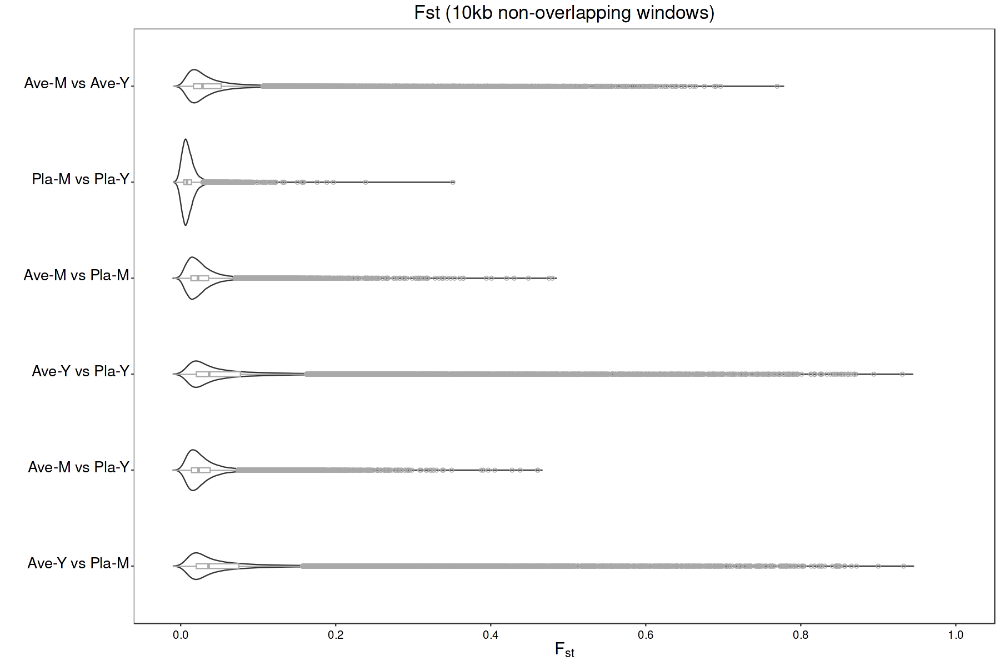

In [26]:
options(repr.plot.width=15, repr.plot.height=10)

fstHistPlot = FstToPlot %>%   
    # gather data from wide-format
    gather(key="Populations", value="Fst") %>% 

    # Reorder Population levels for plotting
    mutate(Populations = fct_relevel(Populations, colsToPlot)) %>%
    # mutate(Populations = factor(Populations, levels=colsToPlot)) %>%
    
    # ggplot violin+boxplot
    ggplot(aes(x=Fst, y=fct_rev(Populations))) + #geom_jitter(height = 0, width = 0.1) +
        geom_violin(scale='count', trim=FALSE) +
        geom_boxplot(width = 0.05, outlier.shape=1, position_dodge2=0.1, col='darkgrey') +
        plot_theme + 
        labs(x=expression(F[st]), y='', title='Fst (10kb non-overlapping windows)') +
        scale_x_continuous(limits=c(-0.01,1), breaks=seq(0,1,0.2)) +        
        scale_y_discrete(labels = c('Ave-Y vs Pla-M', 'Ave-M vs Pla-Y', 'Ave-Y vs Pla-Y', 'Ave-M vs Pla-M', 'Pla-M vs Pla-Y', 'Ave-M vs Ave-Y')) +
        theme(legend.position = "none", 
              plot.title = element_text(hjust = 0.5, size=20), 
              axis.title = element_text(size = 18),
              axis.text.y = element_text(size = 16, vjust = 0.2, color = 'black'),
              axis.text.x = element_text(size = 12, vjust = 0.2, color = 'black'))

fstHistPlot

In [1088]:
ggsave(fstHistPlot, filename='_figures/fst_boxplots.pdf', width = 12, height = 7)

Warning message:
“Removed 12 rows containing non-finite values (`stat_ydensity()`).”
Warning message:
“Removed 12 rows containing non-finite values (`stat_boxplot()`).”
Warning message:
“Removed 35 rows containing missing values (`geom_violin()`).”


In [1089]:
cat('Quantiles\n')
quantile(FstToPlot$Fst_PlaFR_PlaY, probs = c(0.5,0.95,0.99))
quantile(FstToPlot$Fst_AveFR_AveY, probs = c(0.5,0.95,0.99))
quantile(FstToPlot$Fst_AveFR_PlaFR, probs = c(0.5,0.95,0.99))
quantile(FstToPlot$Fst_AveY_PlaY, probs = c(0.5,0.95,0.99))
quantile(FstToPlot$Fst_AveFR_PlaY, probs = c(0.5,0.95,0.99))
quantile(FstToPlot$Fst_AveY_PlaFR, probs = c(0.5,0.95,0.99))

Quantiles


50%    95%    99% 
0.0084 0.0273 0.0453

50%    95%    99% 
0.0284 0.1584 0.3652

50%     95%     99% 
0.02220 0.07470 0.13123

50%     95%     99% 
0.03650 0.23153 0.51320

50%    95%    99% 
0.0233 0.0823 0.1467

50%     95%     99% 
0.03620 0.22873 0.50433

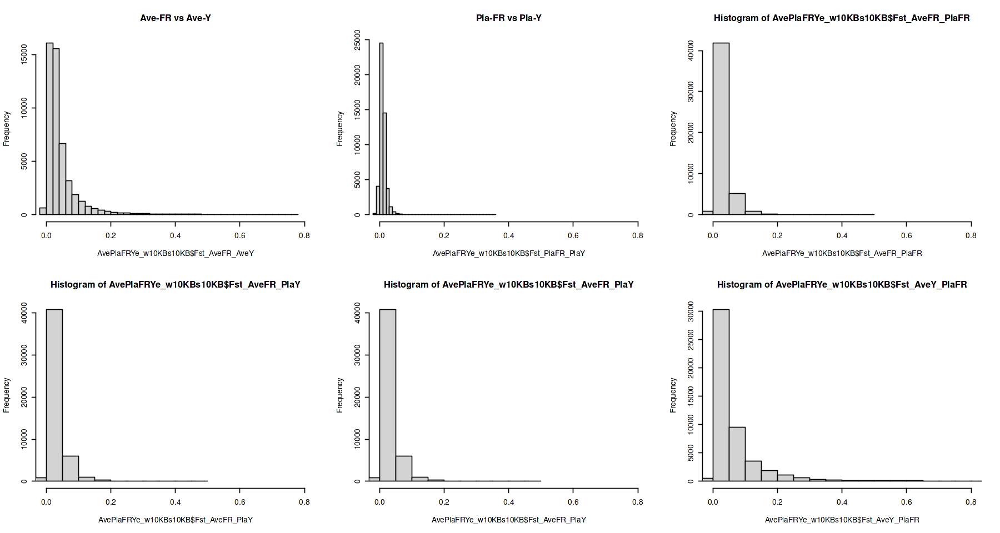

In [34]:
options(repr.plot.width=15,repr.plot.height=8)

par(mfrow=c(2,3))
hist(AvePlaFRYe_w10KBs10KB$Fst_AveFR_AveY, breaks=50, xlim=c(0,0.8), main='Ave-FR vs Ave-Y')
hist(AvePlaFRYe_w10KBs10KB$Fst_PlaFR_PlaY, breaks=50, xlim=c(0,0.8), main='Pla-FR vs Pla-Y')
hist(AvePlaFRYe_w10KBs10KB$Fst_AveFR_PlaFR, xlim=c(0,0.8))
hist(AvePlaFRYe_w10KBs10KB$Fst_AveFR_PlaY, xlim=c(0,0.8))
hist(AvePlaFRYe_w10KBs10KB$Fst_AveFR_PlaY, xlim=c(0,0.8))
hist(AvePlaFRYe_w10KBs10KB$Fst_AveY_PlaFR, xlim=c(0,0.8))

## Avg Fst from vcftools

In [56]:
Ave_Pla = fread('./AvePla/Ave-Pla.site.weir.fst')
AveFR_AveY = fread('./AvePla-FRYe/AveFR-AveY.site.weir.fst')
AveFR_PlaFR = fread('./AvePla-FRYe/AveFR-PlaFR.site.weir.fst')
AveFR_PlaY = fread('./AvePla-FRYe/AveFR-PlaY.site.weir.fst')
AveY_PlaFR = fread('./AvePla-FRYe/AveY-PlaFR.site.weir.fst')
AveY_PlaY = fread('./AvePla-FRYe/AveY-PlaY.site.weir.fst')
PlaFR_PlaY = fread('./AvePla-FRYe/PlaFR-PlaY.site.weir.fst')

In [57]:
cat('Mean Fst values: \n')
cat('\nAve - Pla:',signif(mean(Ave_Pla$WEIR_AND_COCKERHAM_FST, na.rm=T), 4))
cat('\nAveFR - AveY:',signif(mean(AveFR_AveY$WEIR_AND_COCKERHAM_FST, na.rm=T), 4))
cat('\nAveFR - PlaFR:',signif(mean(AveFR_PlaFR$WEIR_AND_COCKERHAM_FST, na.rm=T), 4))
cat('\nAveFR - PlaY:',signif(mean(AveFR_PlaY$WEIR_AND_COCKERHAM_FST, na.rm=T), 4))
cat('\nAveY - PlaFR:',signif(mean(AveY_PlaFR$WEIR_AND_COCKERHAM_FST, na.rm=T), 4))
cat('\nAveY - PlaY:',signif(mean(AveY_PlaY$WEIR_AND_COCKERHAM_FST, na.rm=T), 4))
cat('\nPlaFR - PlaY:',signif(mean(PlaFR_PlaY$WEIR_AND_COCKERHAM_FST, na.rm=T), 4))

Mean Fst values: 

Ave - Pla: 0.04026
AveFR - AveY: 0.04799
AveFR - PlaFR: 0.02679
AveFR - PlaY: 0.02897
AveY - PlaFR: 0.06531
AveY - PlaY: 0.06616
PlaFR - PlaY: 0.002561

## Plots

### Fst

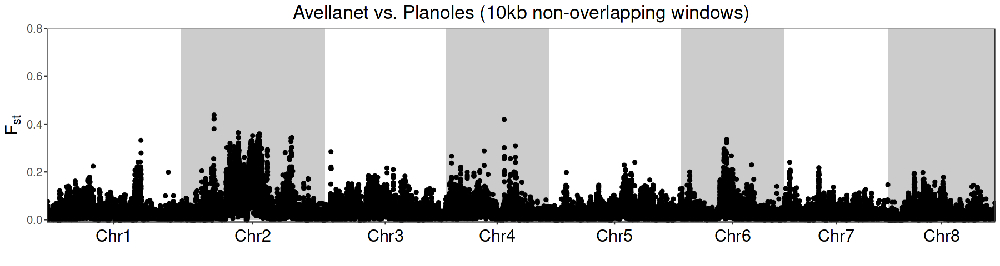

In [26]:
options(repr.plot.width=15, repr.plot.height=4)

fst_Ave_Pla = ggplot(AvePla_w10KBs10KB[sites >= 20], aes(x=midCum, y=Fst_Ave_Pla)) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = 0, ymax = 0.8, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = 0, ymax = 0.8, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = 0, ymax = 0.8, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = 0, ymax = 0.8, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    geom_point(alpha=1, size=1.5, pch=19) +

    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,0.8)) +
    labs(x='', y=expression(F[st]), title='Avellanet vs. Planoles (10kb non-overlapping windows)') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
fst_Ave_Pla

Warning message:
“Removed 1 rows containing missing values (`geom_point()`).”


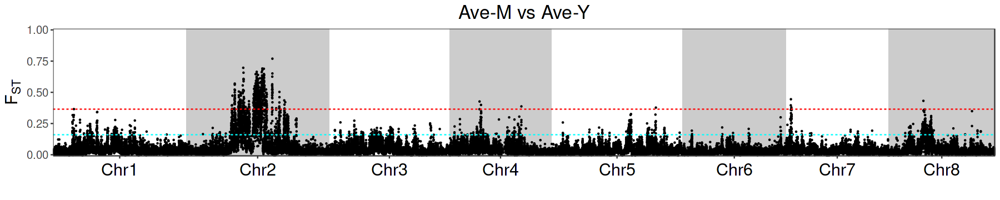

In [27]:
options(repr.plot.width=15, repr.plot.height=3)
per95 = 0.1584
per99 = 0.3652

fst_AveFR_AveY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 20], aes(x=midCum, y=Fst_AveFR_AveY)) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    geom_point(alpha=1, size=0.5, pch=20) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_AveY >= per95 & sites >= 10], aes(x=midCum, y=Fst_AveFR_AveY), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_AveY >= per99 & sites >= 10], aes(x=midCum, y=Fst_AveFR_AveY), size=1.5, pch=19, col='red') + # 99 percentile
    # geom_line(lwd=0.3) +
    geom_hline(yintercept = c(per95, per99), col=c('cyan','red'), lty=2) +
    
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression(F[ST]), title='Ave-M vs Ave-Y') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
fst_AveFR_AveY

Warning message:
“Removed 5 rows containing missing values (`geom_point()`).”


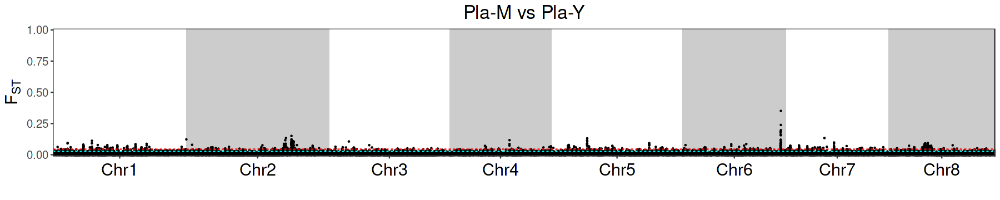

In [28]:
options(repr.plot.width=15, repr.plot.height=3)
per95=0.0273
per99=0.0453

fst_PlaFR_PlaY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 20], aes(x=midCum, y=Fst_PlaFR_PlaY)) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    geom_point(alpha=1, size=0.5, pch=20) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_PlaFR_PlaY >= per95 & sites >= 10], aes(x=midCum, y=Fst_PlaFR_PlaY), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_PlaFR_PlaY >= per99 & sites >= 10], aes(x=midCum, y=Fst_PlaFR_PlaY), size=1.5, pch=19, col='red') + # 99 percentile
    # geom_line(lwd=0.3) +
    geom_hline(yintercept = c(per95, per99), col=c('cyan','red'), lty=2) +

    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression(F[ST]), title='Pla-M vs Pla-Y') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
fst_PlaFR_PlaY

Warning message:
“Removed 1 rows containing missing values (`geom_point()`).”


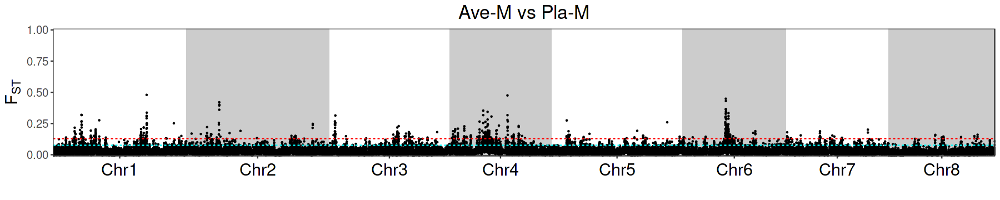

In [29]:
options(repr.plot.width=15, repr.plot.height=3)
per95 = 0.0747
per99 = 0.1312

fst_AveFR_PlaFR = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 20], aes(x=midCum, y=Fst_AveFR_PlaFR)) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    geom_point(alpha=1, size=0.5, pch=20) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_PlaFR >= per95], aes(x=midCum, y=Fst_AveFR_PlaFR), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_PlaFR >= per99], aes(x=midCum, y=Fst_AveFR_PlaFR), size=1.5, pch=19, col='red') + # 99 percentile
    # geom_line(lwd=0.3) +
    geom_hline(yintercept = c(per95, per99), col=c('cyan','red'), lty=2) +
    
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression(F[ST]), title='Ave-M vs Pla-M') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
fst_AveFR_PlaFR

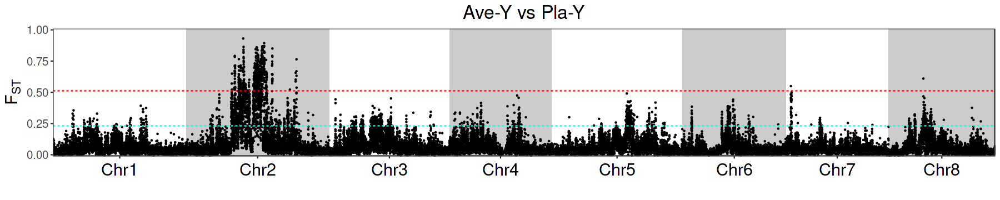

In [30]:
options(repr.plot.width=15, repr.plot.height=3)
per95 = 0.2315
per99 = 0.5132

fst_AveY_PlaY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 20], aes(x=midCum, y=Fst_AveY_PlaY)) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    geom_point(alpha=1, size=0.5, pch=20) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaY >= per95], aes(x=midCum, y=Fst_AveY_PlaY), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaY >= per99], aes(x=midCum, y=Fst_AveY_PlaY), size=1.5, pch=19, col='red') + # 99 percentile
    # geom_line(lwd=0.3) +
    geom_hline(yintercept = c(per95, per99), col=c('cyan','red'), lty=2) +
    
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression(F[ST]), title='Ave-Y vs Pla-Y') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
fst_AveY_PlaY

Warning message:
“Removed 3 rows containing missing values (`geom_point()`).”


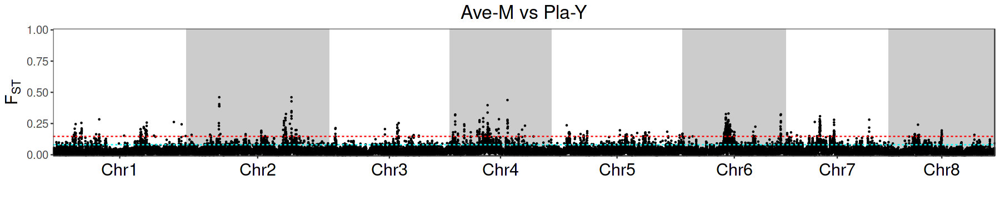

In [31]:
options(repr.plot.width=15, repr.plot.height=3)
per95 = 0.0823
per99 = 0.1467

fst_AveFR_PlaY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 20], aes(x=midCum, y=Fst_AveFR_PlaY)) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    geom_point(alpha=1, size=0.5, pch=20) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_PlaY >= per95], aes(x=midCum, y=Fst_AveFR_PlaY), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_PlaY >= per99], aes(x=midCum, y=Fst_AveFR_PlaY), size=1.5, pch=19, col='red') + # 99 percentile
    # geom_line(lwd=0.3) +
    geom_hline(yintercept = c(per95, per99), col=c('cyan','red'), lty=2) +
 
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression(F[ST]), title='Ave-M vs Pla-Y') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
fst_AveFR_PlaY

Warning message:
“Removed 2 rows containing missing values (`geom_point()`).”


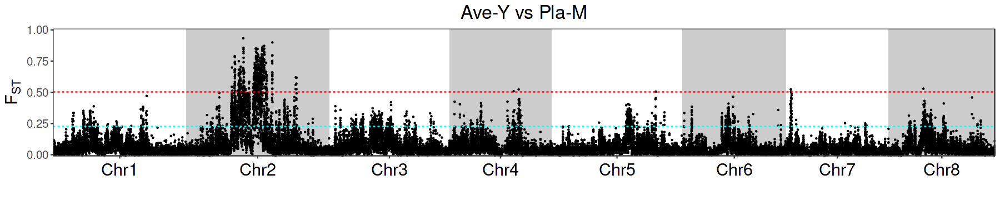

In [32]:
options(repr.plot.width=15, repr.plot.height=3)
per95 = 0.2287
per99 = 0.5043

fst_AveY_PlaFR = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 20], aes(x=midCum, y=Fst_AveY_PlaFR)) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    geom_point(alpha=1, size=0.5, pch=20) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaFR >= per95], aes(x=midCum, y=Fst_AveY_PlaFR), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaFR >= per99], aes(x=midCum, y=Fst_AveY_PlaFR), size=1.5, pch=19, col='red') + # 99 percentile
    # geom_line(lwd=0.3) +
    geom_hline(yintercept = c(per95, per99), col=c('cyan','red'), lty=2) +
     
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression(F[ST]), title='Ave-Y vs Pla-M') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
fst_AveY_PlaFR

Warning message:
“Removed 5 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 24 rows containing missing values or values outside the scale range
(`geom_point()`).”


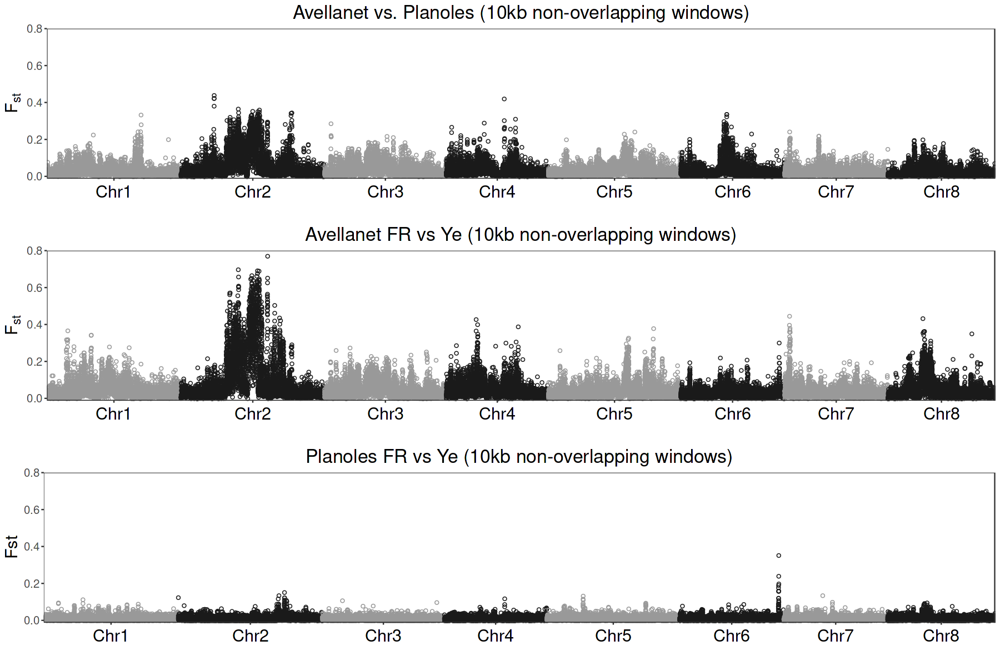

In [15]:
options(repr.plot.width=15,repr.plot.height=10)
grid.arrange(fst_Ave_Pla, fst_AveFR_AveY, fst_PlaFR_PlaY, nrow=3)

Warning message:
“Removed 6 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 5 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 4 rows containing missing values or values outside the scale range
(`geom_point()`).”


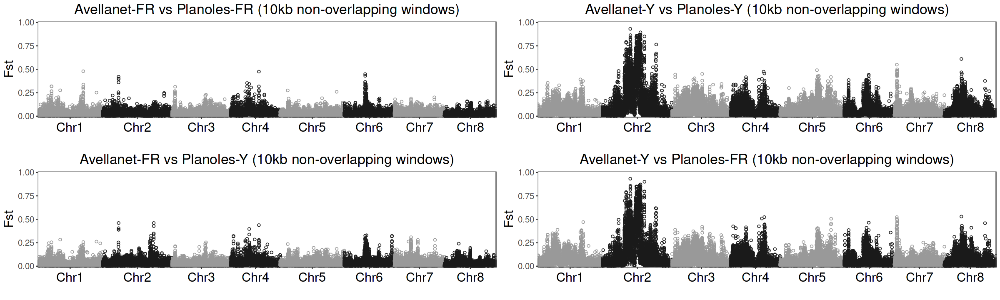

In [64]:
options(repr.plot.width=20,repr.plot.height=6)
grid.arrange(fst_AveFR_PlaFR, fst_AveY_PlaY, 
             fst_AveFR_PlaY, fst_AveY_PlaFR,
             nrow=2)

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 5 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 3 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”


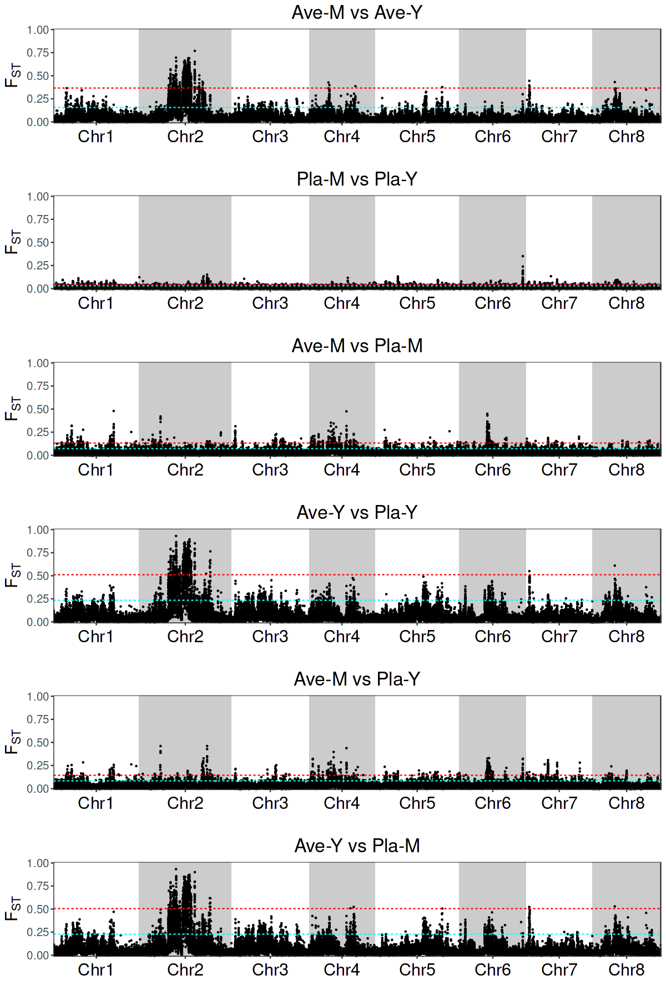

In [38]:
options(repr.plot.width=10, repr.plot.height=15)
grid.arrange(fst_AveFR_AveY, 
             fst_PlaFR_PlaY, 
             fst_AveFR_PlaFR, 
             fst_AveY_PlaY, 
             fst_AveFR_PlaY, 
             fst_AveY_PlaFR, 
             ncol=1)

Warning message:
“Removed 1 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 5 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 1 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 3 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values (`geom_point()`).”


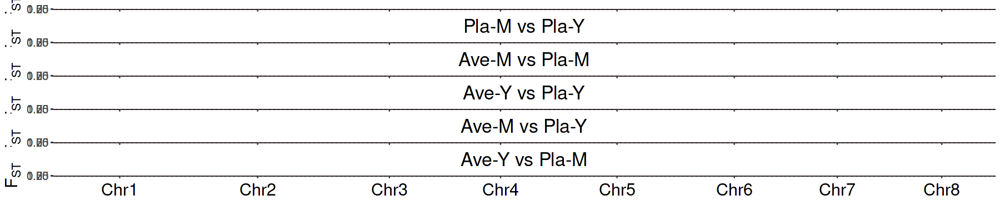

In [33]:
fst_gridPlot = grid.arrange(fst_AveFR_AveY, 
             fst_PlaFR_PlaY, 
             fst_AveFR_PlaFR, 
             fst_AveY_PlaY, 
             fst_AveFR_PlaY, 
             fst_AveY_PlaFR, 
             ncol=1)
ggsave(fst_gridPlot, filename='_figures/fst_AvePlaMY_dots.pdf', width=10, height=16)

In [34]:
## YELLOW
cremosa = c('Chr1', 821293, 1095277)
aurina = c('Chr2', 951685, 1153653)
flavia = c('Chr2', 53368062, 53569435)
sulf = c('Chr4', 38248572, 38450336)

## MAGENTA
rubia = c('Chr5', 6169966, 6372151)
rosel = c('Chr6', 52789323, 53162505)

In [35]:
str(AvePlaFRYe_w10KBs10KB)

Classes ‘data.table’ and 'data.frame':	50881 obs. of  24 variables:
 $ windowID       : int  1 2 3 4 5 6 7 8 9 10 ...
 $ scaffold       : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ start          : int  1 10001 20001 30001 40001 50001 60001 70001 80001 90001 ...
 $ end            : int  10000 20000 30000 40000 50000 60000 70000 80000 90000 100000 ...
 $ mid            : num  7311 15387 24812 31845 NaN ...
 $ sites          : int  118 126 227 53 0 20 209 199 219 152 ...
 $ pi_AveFR       : num  0.278 0.233 0.228 0.257 NaN ...
 $ pi_AveY        : num  0.324 0.23 0.221 0.278 NaN ...
 $ pi_PlaFR       : num  0.287 0.202 0.22 0.225 NaN ...
 $ pi_PlaY        : num  0.28 0.234 0.252 0.192 NaN ...
 $ dxy_AveFR_AveY : num  0.309 0.236 0.234 0.274 NaN ...
 $ dxy_AveFR_PlaFR: num  0.281 0.224 0.227 0.244 NaN ...
 $ dxy_AveFR_PlaY : num  0.281 0.238 0.247 0.242 NaN ...
 $ dxy_AveY_PlaFR : num  0.313 0.233 0.232 0.259 NaN ...
 $ dxy_AveY_PlaY  : num  0.315 0.248 0.257 0.252 NaN ...
 $ dxy_PlaFR_PlaY :

In [37]:
## YELLOW
cremosa = c('Chr1', 821293, 1095277)
aurina = c('Chr2', 951685, 1153653)
flavia = c('Chr2', 53368062, 53569435)
sulf = c('Chr4', 38248572, 38450336)

## MAGENTA
rubia = c('Chr5', 6169966, 6372151)
rosel = c('Chr6', 52789323, 53162505)
# roselPos = 

cremosaPos = AvePlaFRYe_w10KBs10KB[scaffold==cremosa[1] & start>=as.numeric(cremosa[2]) & end<=as.numeric(cremosa[3])]
aurinaPos = AvePlaFRYe_w10KBs10KB[scaffold==aurina[1] & start>=as.numeric(aurina[2]) & end<=as.numeric(aurina[3])]
flaviaPos = AvePlaFRYe_w10KBs10KB[scaffold==flavia[1] & start>=as.numeric(flavia[2]) & end<=as.numeric(flavia[3])]
sulfPos = AvePlaFRYe_w10KBs10KB[scaffold==sulf[1] & start>=as.numeric(sulf[2]) & end<=as.numeric(sulf[3])]
rubiaPos = AvePlaFRYe_w10KBs10KB[scaffold==rubia[1] & start>=as.numeric(rubia[2]) & end<=as.numeric(rubia[3])]
roselPos = AvePlaFRYe_w10KBs10KB[scaffold==rosel[1] & start>=as.numeric(rosel[2]) & end<=as.numeric(rosel[3])]

In [1281]:
sulfPos

windowID,scaffold,start,end,mid,sites,pi_AveFR,pi_AveY,pi_PlaFR,pi_PlaY,⋯,dxy_PlaFR_PlaY,Fst_AveFR_AveY,Fst_AveFR_PlaFR,Fst_AveFR_PlaY,Fst_AveY_PlaFR,Fst_AveY_PlaY,Fst_PlaFR_PlaY,total,midCum,chrom_start_end
<int>,<chr>,<int>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<dbl>,<chr>
3826,Chr4,38250001,38260000,NaN,0,NaN,NaN,NaN,NaN,⋯,NaN,NaN,NaN,NaN,NaN,NaN,NaN,214260000,NaN,Chr4_38250001_38260000
3827,Chr4,38260001,38270000,NaN,0,NaN,NaN,NaN,NaN,⋯,NaN,NaN,NaN,NaN,NaN,NaN,NaN,214260000,NaN,Chr4_38260001_38270000
3828,Chr4,38270001,38280000,NaN,0,NaN,NaN,NaN,NaN,⋯,NaN,NaN,NaN,NaN,NaN,NaN,NaN,214260000,NaN,Chr4_38270001_38280000
3829,Chr4,38280001,38290000,38285041,91,0.2000,0.2059,0.2035,0.1913,⋯,0.1997,0.0319,0.0211,0.0161,0.0348,0.0307,0.0059,214260000,252545041,Chr4_38280001_38290000
3830,Chr4,38290001,38300000,38294375,64,0.2496,0.1900,0.1888,0.2202,⋯,0.2080,0.0459,0.0334,0.0134,0.1158,0.0691,0.0087,214260000,252554375,Chr4_38290001_38300000
3831,Chr4,38300001,38310000,38304866,234,0.2826,0.1930,0.2565,0.2718,⋯,0.2689,0.0796,0.0230,0.0219,0.1224,0.0989,0.0090,214260000,252564866,Chr4_38300001_38310000
3832,Chr4,38310001,38320000,38316817,196,0.2829,0.1946,0.2363,0.2912,⋯,0.2715,0.0732,0.0769,0.0293,0.2000,0.1139,0.0146,214260000,252576817,Chr4_38310001_38320000
3833,Chr4,38320001,38330000,38326363,144,0.2438,0.2448,0.1920,0.2437,⋯,0.2269,0.0639,0.0651,0.0184,0.1240,0.0604,0.0205,214260000,252586363,Chr4_38320001_38330000
3834,Chr4,38330001,38340000,38336546,204,0.2461,0.2435,0.2015,0.2422,⋯,0.2297,0.0698,0.0420,0.0074,0.1306,0.0703,0.0176,214260000,252596546,Chr4_38330001_38340000


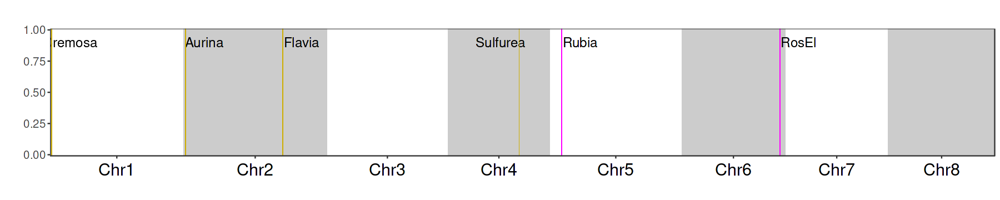

In [38]:
options(repr.plot.width=15, repr.plot.height=3)
per95 = 0.2287
per99 = 0.5043

colorGenes = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 20], aes(x=midCum, y=Fst_AveY_PlaFR)) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +

    annotate('text', x = rubiaPos$midCum[1]+1e7, y = 0.9, label = 'Rubia', size=5) +
    annotate("rect", xmin = rubiaPos$midCum[1], xmax = tail(rubiaPos$midCum,1), ymin = -0.01, ymax = 1.01, bg='magenta', alpha = 1, linewidth=5) +
    annotate('text', x = roselPos$midCum[1]+1e7, y = 0.9, label = 'RosEl', size=5) +
    annotate("rect", xmin = roselPos$midCum[1], xmax = tail(roselPos$midCum,1), ymin = -0.01, ymax = 1.01, bg='magenta', alpha = 1, linewidth=5) +

    annotate('text', x = cremosaPos$midCum[1]+1e7, y = 0.9, label = 'Cremosa', size=5 ) +
    annotate("rect", xmin = cremosaPos$midCum[1], xmax = tail(cremosaPos$midCum,1), ymin = -0.01, ymax = 1.01, bg='gold3', alpha = 1, linewidth=5) +
    annotate('text', x = aurinaPos$midCum[1]+1e7, y = 0.9, label = 'Aurina' , size=5) +
    annotate("rect", xmin = aurinaPos$midCum[1], xmax = tail(aurinaPos$midCum,1), ymin = -0.01, ymax = 1.01, bg='gold3', alpha = 1, linewidth=5) +
    annotate('text', x = flaviaPos$midCum[1]+1e7, y = 0.9, label = 'Flavia', size=5 ) +
    annotate("rect", xmin = flaviaPos$midCum[1], xmax = tail(flaviaPos$midCum,1), ymin = -0.01, ymax = 1.01, bg='gold3', alpha = 1, linewidth=5) +
    annotate('text', x = sulfPos$midCum[4]-1e7, y = 0.9, label = 'Sulfurea', size=5 ) +
    annotate("rect", xmin = sulfPos$midCum[4], xmax = tail(sulfPos$midCum,1), ymin = -0.01, ymax = 1.01, bg='gold3', alpha = 1, linewidth=5) +


    # # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    # geom_point(alpha=1, size=0.5, pch=20) +
    # # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaFR >= per95], aes(x=midCum, y=Fst_AveY_PlaFR), size=1.5, pch=19, col='blue') + # 95 percentile
    # # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaFR >= per99], aes(x=midCum, y=Fst_AveY_PlaFR), size=1.5, pch=19, col='red') + # 99 percentile
    # # geom_line(lwd=0.3) +
    # geom_hline(yintercept = c(per95, per99), col=c('cyan','red'), lty=2) +
     
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y='', title='') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
colorGenes

In [1314]:
ggsave(colorGenes, filename='_figures/colorGenes.pdf', width=10, height=3)

### misc: z-transformed Fst plots

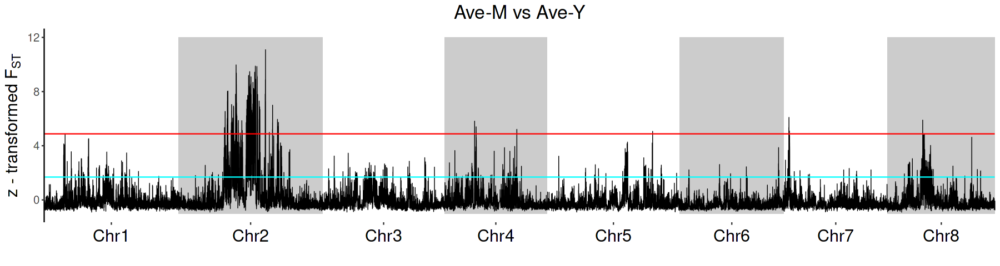

In [181]:
options(repr.plot.width=15, repr.plot.height=4)
per95 = 0.157
per99 = 0.3648
meanFst = mean(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveFR_AveY)
sdFst = sd(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveFR_AveY)
z_per95 = (per95-meanFst)/sdFst
z_per99 = (per99-meanFst)/sdFst
# max(scale(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveFR_AveY, center=T, scale=T))

fst_AveFR_AveY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=scale(Fst_AveFR_AveY, center=T, scale=T))) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -1, ymax = 12, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -1, ymax = 12, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -1, ymax = 12, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -1, ymax = 12, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    # geom_point(alpha=1, size=1, pch=1) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_AveY >= per95 & sites >= 10], aes(x=midCum, y=Fst_AveFR_AveY), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_AveY >= per99 & sites >= 10], aes(x=midCum, y=Fst_AveFR_AveY), size=1.5, pch=19, col='red') + # 99 percentile
    geom_line(lwd=0.3) +
    geom_hline(yintercept = c(z_per95, z_per99), col=c('cyan','red')) +
    
    # Axes and labels:
    # scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), labels = NULL, breaks = NULL) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    # scale_y_continuous(expand = c(0, 1), limits=c(-1,11)) +
    labs(x='', y=expression("z - transformed"~F[ST]), title='Ave-M vs Ave-Y') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.line.y = element_line(colour = "black"),
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black'),
          panel.border = element_blank()
          )
fst_AveFR_AveY

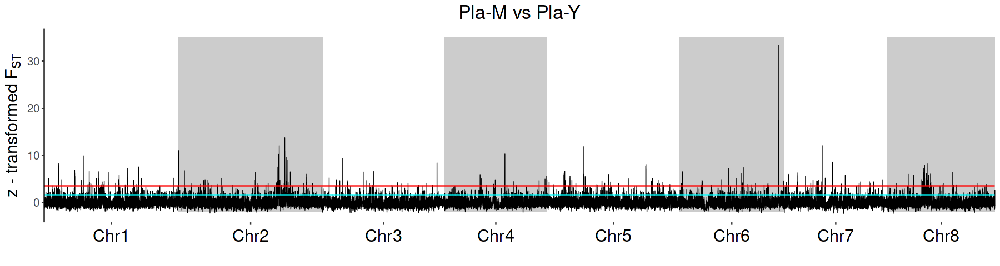

In [182]:
options(repr.plot.width=15, repr.plot.height=4)
per95=0.0274
per99=0.0459
meanFst = mean(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_PlaFR_PlaY)
sdFst = sd(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_PlaFR_PlaY)
z_per95 = (per95-meanFst)/sdFst
z_per99 = (per99-meanFst)/sdFst
# max(scale(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_PlaFR_PlaY, center=T, scale=T))

fst_PlaFR_PlaY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=scale(Fst_PlaFR_PlaY, center=TRUE, scale=TRUE))) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -2, ymax = 35, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -2, ymax = 35, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -2, ymax = 35, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -2, ymax = 35, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    # geom_point(alpha=1, size=1, pch=1) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_PlaFR_PlaY >= per95 & sites >= 10], aes(x=midCum, y=Fst_PlaFR_PlaY), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_PlaFR_PlaY >= per99 & sites >= 10], aes(x=midCum, y=Fst_PlaFR_PlaY), size=1.5, pch=19, col='red') + # 99 percentile
    geom_line(lwd=0.3) +
    geom_hline(yintercept = c(z_per95, z_per99), col=c('cyan','red')) +

    # Axes and labels:
    # scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), labels = NULL, breaks = NULL) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    # scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression("z - transformed"~F[ST]), title='Pla-M vs Pla-Y') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.line.y = element_line(colour = "black"),
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black'),
          panel.border = element_blank()
          )
fst_PlaFR_PlaY

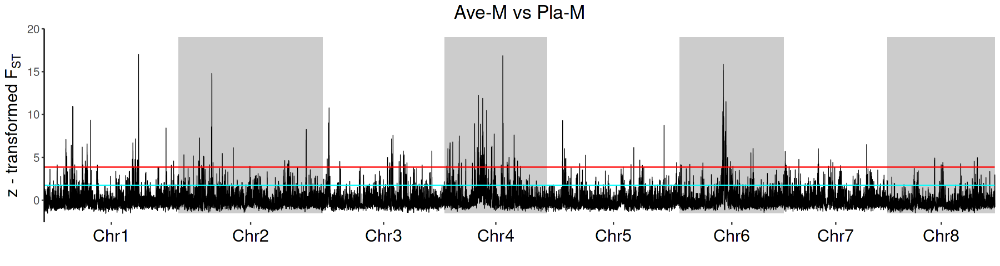

In [183]:
options(repr.plot.width=15, repr.plot.height=4)
per95 = 0.0746
per99 = 0.1307
meanFst = mean(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveFR_PlaFR)
sdFst = sd(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveFR_PlaFR)
z_per95 = (per95-meanFst)/sdFst
z_per99 = (per99-meanFst)/sdFst
# max(scale(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveFR_PlaFR, center=T, scale=T))

fst_AveFR_PlaFR = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=scale(Fst_AveFR_PlaFR, center=T, scale=T))) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -1.5, ymax = 19, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -1.5, ymax = 19, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -1.5, ymax = 19, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -1.5, ymax = 19, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    # geom_point(alpha=1, size=1, pch=1) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_PlaFR >= per95], aes(x=midCum, y=Fst_AveFR_PlaFR), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_PlaFR >= per99], aes(x=midCum, y=Fst_AveFR_PlaFR), size=1.5, pch=19, col='red') + # 99 percentile
    geom_line(lwd=0.3) +
    geom_hline(yintercept = c(z_per95, z_per99), col=c('cyan','red')) +
    
    # Axes and labels:
    # scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), labels = NULL, breaks = NULL) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    # scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression("z - transformed"~F[ST]), title='Ave-M vs Pla-M') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.line.y = element_line(colour = "black"),
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black'),
          panel.border = element_blank()
          )
fst_AveFR_PlaFR

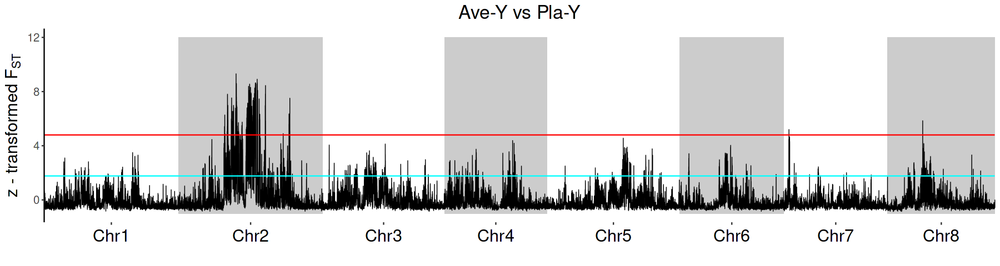

In [190]:
options(repr.plot.width=15, repr.plot.height=4)
per95 = 0.2307
per99 = 0.5126
meanFst = mean(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveY_PlaY)
sdFst = sd(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveY_PlaY)
z_per95 = (per95-meanFst)/sdFst
z_per99 = (per99-meanFst)/sdFst
# max(scale(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveY_PlaY, center=T, scale=T))

fst_AveY_PlaY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=scale(Fst_AveY_PlaY, scale=T, center=T))) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -1, ymax = 12, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -1, ymax = 12, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -1, ymax = 12, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -1, ymax = 12, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    # geom_point(alpha=1, size=1, pch=1) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaY >= per95], aes(x=midCum, y=Fst_AveY_PlaY), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaY >= per99], aes(x=midCum, y=Fst_AveY_PlaY), size=1.5, pch=19, col='red') + # 99 percentile
    geom_line(lwd=0.3) +
    geom_hline(yintercept = c(z_per95, z_per99), col=c('cyan','red')) +
    
    # Axes and labels:
    # scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), labels = NULL, breaks = NULL) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    # scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression("z - transformed"~F[ST]), title='Ave-Y vs Pla-Y') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.line.y = element_line(colour = "black"),
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black'),
          panel.border = element_blank()
          )
fst_AveY_PlaY

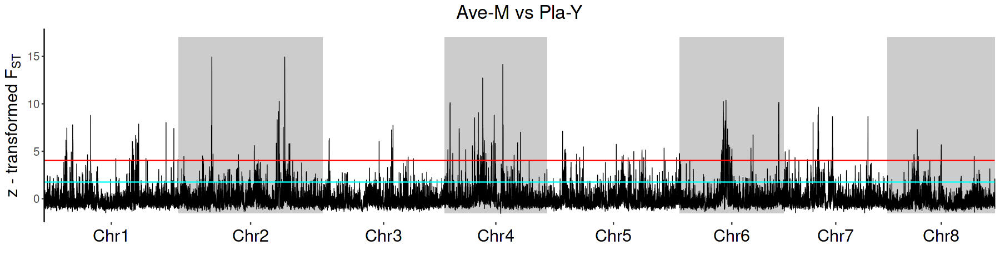

In [186]:
options(repr.plot.width=15, repr.plot.height=4)
per95 = 0.0822
per99 = 0.1464
meanFst = mean(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveFR_PlaY)
sdFst = sd(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveFR_PlaY)
z_per95 = (per95-meanFst)/sdFst
z_per99 = (per99-meanFst)/sdFst
# max(scale(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveFR_PlaY, center=T, scale=T))

fst_AveFR_PlaY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=scale(Fst_AveFR_PlaY, center=T, scale=T))) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -1.5, ymax = 17, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -1.5, ymax = 17, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -1.5, ymax = 17, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -1.5, ymax = 17, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    # geom_point(alpha=1, size=1, pch=1) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_PlaY >= per95], aes(x=midCum, y=Fst_AveFR_PlaY), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_PlaY >= per99], aes(x=midCum, y=Fst_AveFR_PlaY), size=1.5, pch=19, col='red') + # 99 percentile
    geom_line(lwd=0.3) +
    geom_hline(yintercept = c(z_per95, z_per99), col=c('cyan','red')) +
 
    # Axes and labels:
    # scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), labels = NULL, breaks = NULL) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    # scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression("z - transformed"~F[ST]), title='Ave-M vs Pla-Y') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.line.y = element_line(colour = "black"),
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black'),
          panel.border = element_blank()
          )
fst_AveFR_PlaY

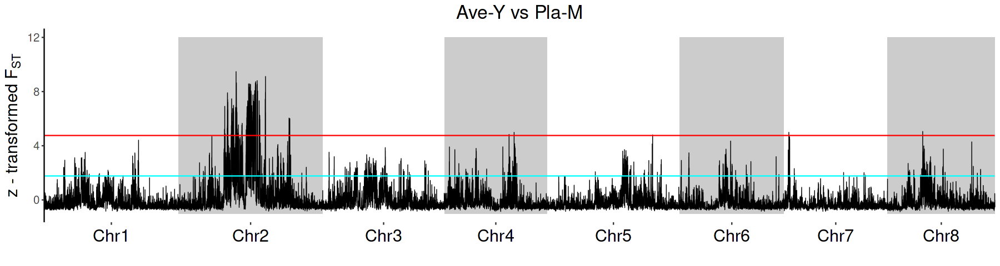

In [189]:
options(repr.plot.width=15, repr.plot.height=4)
per95 = 0.2273
per99 = 0.5022
meanFst = mean(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveY_PlaFR)
sdFst = sd(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveY_PlaFR)
z_per95 = (per95-meanFst)/sdFst
z_per99 = (per99-meanFst)/sdFst
# max(scale(AvePlaFRYe_w10KBs10KB[sites >= 10]$Fst_AveY_PlaFR, center=T, scale=T))

fst_AveY_PlaFR = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=scale(Fst_AveY_PlaFR, center=T, scale=T))) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -1, ymax = 12, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -1, ymax = 12, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -1, ymax = 12, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -1, ymax = 12, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    # geom_point(alpha=1, size=1, pch=1) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaFR >= per95], aes(x=midCum, y=Fst_AveY_PlaFR), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaFR >= per99], aes(x=midCum, y=Fst_AveY_PlaFR), size=1.5, pch=19, col='red') + # 99 percentile
    geom_line(lwd=0.3) +
    geom_hline(yintercept = c(z_per95, z_per99), col=c('cyan','red')) +
     
    # Axes and labels:
    # scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), labels = NULL, breaks = NULL) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    # scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression("z - transformed"~F[ST]), title='Ave-Y vs Pla-M') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.line.y = element_line(colour = "black"),
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black'),
          panel.border = element_blank()
          )
fst_AveY_PlaFR

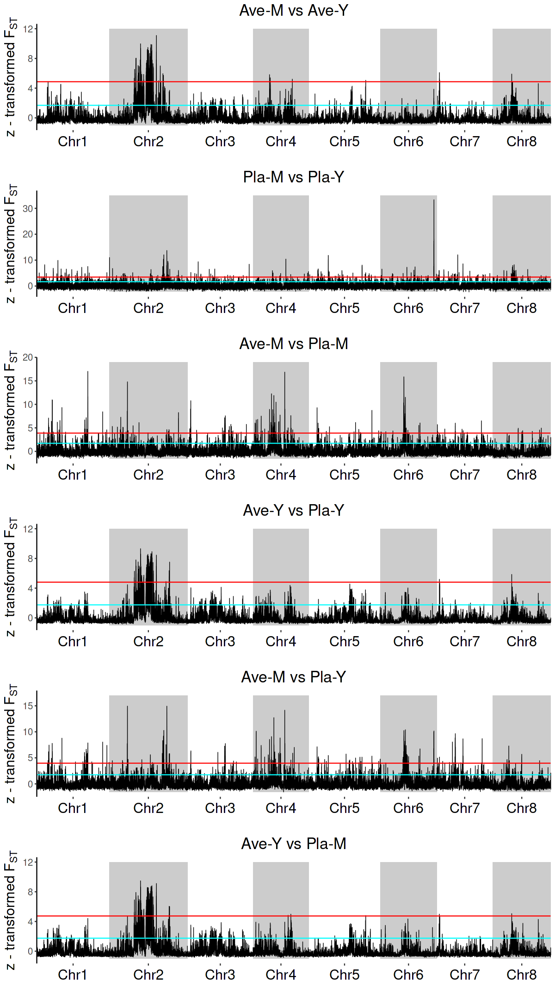

In [191]:
options(repr.plot.width=10, repr.plot.height=18)
grid.arrange(fst_AveFR_AveY, 
             fst_PlaFR_PlaY, 
             fst_AveFR_PlaFR, 
             fst_AveY_PlaY, 
             fst_AveFR_PlaY, 
             fst_AveY_PlaFR, 
             ncol=1)

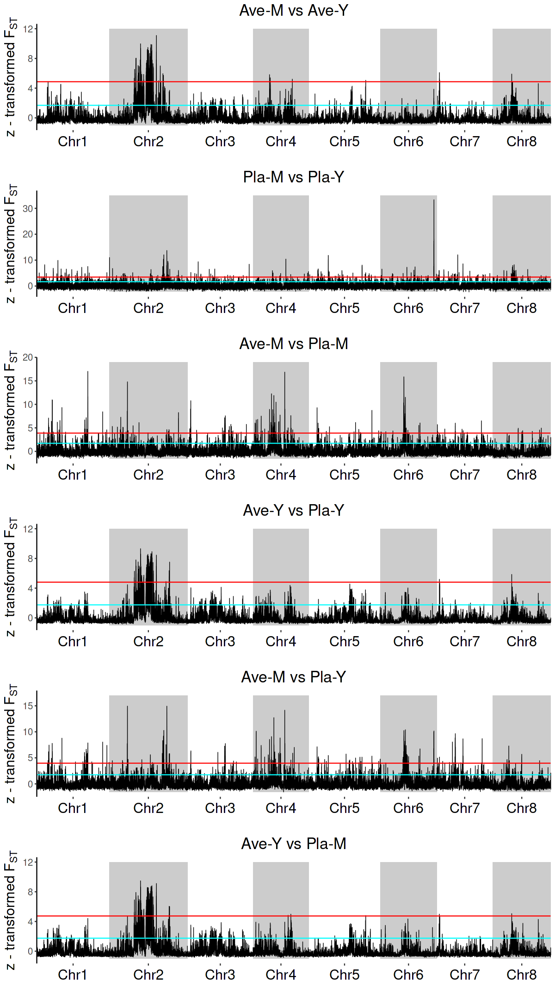

In [192]:
fst_gridPlot = grid.arrange(fst_AveFR_AveY, 
             fst_PlaFR_PlaY, 
             fst_AveFR_PlaFR, 
             fst_AveY_PlaY, 
             fst_AveFR_PlaY, 
             fst_AveY_PlaFR, 
             ncol=1)
ggsave(fst_gridPlot, filename='_figures/zfst_AvePlaMY_lines.pdf', width=10, height=18)

Warning message:
“Removed 5149 rows containing missing values or values outside the scale range
(`geom_line()`).”
Warning message:
“Removed 5149 rows containing missing values or values outside the scale range
(`geom_line()`).”
Warning message:
“Removed 5149 rows containing missing values or values outside the scale range
(`geom_line()`).”
Warning message:
“Removed 5149 rows containing missing values or values outside the scale range
(`geom_line()`).”
Warning message:
“Removed 5149 rows containing missing values or values outside the scale range
(`geom_line()`).”
Warning message:
“Removed 5149 rows containing missing values or values outside the scale range
(`geom_line()`).”
Warning message:
“Removed 5149 rows containing missing values or values outside the scale range
(`geom_line()`).”


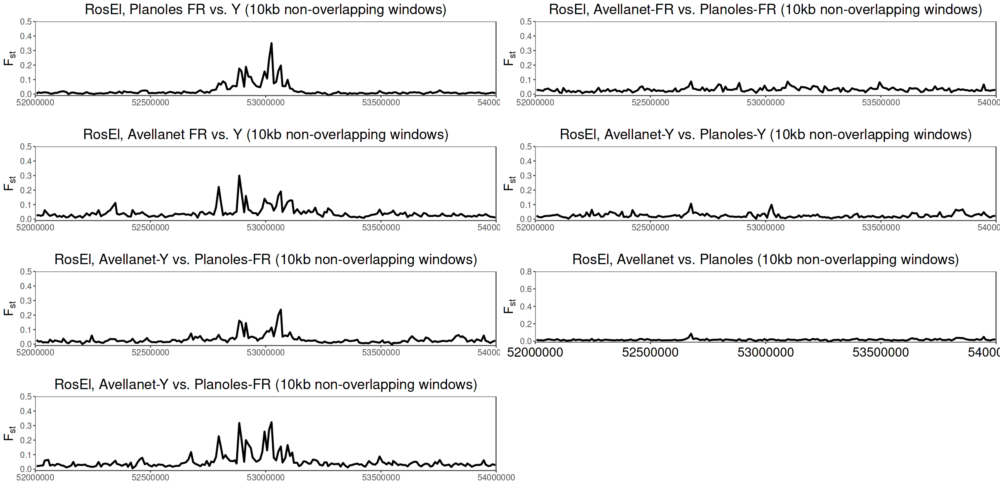

In [59]:
RosEl=c(52000000,54000000)

fst_PlaFR_PlaY_rosel = ggplot(AvePlaFRYe_w3KBs300b[sites >= 10 & scaffold == 'Chr6'], aes(x=mid, y=Fst_PlaFR_PlaY)) +
    geom_line(aes(color=as.factor(scaffold)), alpha=1, lwd=1, col='black') +
    scale_color_manual(values = rep(c("grey60", "grey10"), 4)) +
    
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=RosEl) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,0.5)) +
    labs(x='', y=expression(F[st]), title='RosEl, Planoles FR vs. Y (10kb non-overlapping windows)') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text = element_text(size = 12)
          )

fst_AveFR_AveY_rosel = ggplot(AvePlaFRYe_w3KBs300b[sites >= 10 & scaffold == 'Chr6'], aes(x=mid, y=Fst_AveFR_AveY)) +
    geom_line(aes(color=as.factor(scaffold)), alpha=1, lwd=1, col='black') +
    scale_color_manual(values = rep(c("grey60", "grey10"), 4)) +
    
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=RosEl) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,0.5)) +
    labs(x='', y=expression(F[st]), title='RosEl, Avellanet FR vs. Y (10kb non-overlapping windows)') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text = element_text(size = 12)
          )

fst_AveFR_PlaFR_rosel = ggplot(AvePlaFRYe_w3KBs300b[sites >= 10 & scaffold == 'Chr6'], aes(x=mid, y=Fst_AveFR_PlaFR)) +
    geom_line(aes(color=as.factor(scaffold)), alpha=1, lwd=1, col='black') +
    scale_color_manual(values = rep(c("grey60", "grey10"), 4)) +
    
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=RosEl) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,0.5)) +
    labs(x='', y=expression(F[st]), title='RosEl, Avellanet-FR vs. Planoles-FR (10kb non-overlapping windows)') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text = element_text(size = 12)
          )

fst_AveY_PlaY_rosel = ggplot(AvePlaFRYe_w3KBs300b[sites >= 10 & scaffold == 'Chr6'], aes(x=mid, y=Fst_AveY_PlaY)) +
    geom_line(aes(color=as.factor(scaffold)), alpha=1, lwd=1, col='black') +
    scale_color_manual(values = rep(c("grey60", "grey10"), 4)) +
    
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=RosEl) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,0.5)) +
    labs(x='', y=expression(F[st]), title='RosEl, Avellanet-Y vs. Planoles-Y (10kb non-overlapping windows)') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text = element_text(size = 12)
          )

fst_AveY_PlaFR_rosel = ggplot(AvePlaFRYe_w3KBs300b[sites >= 10 & scaffold == 'Chr6'], aes(x=mid, y=Fst_AveY_PlaFR)) +
    geom_line(aes(color=as.factor(scaffold)), alpha=1, lwd=1, col='black') +
    scale_color_manual(values = rep(c("grey60", "grey10"), 4)) +
    
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=RosEl) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,0.5)) +
    labs(x='', y=expression(F[st]), title='RosEl, Avellanet-Y vs. Planoles-FR (10kb non-overlapping windows)') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text = element_text(size = 12)
          )

fst_AveFR_PlaY_rosel = ggplot(AvePlaFRYe_w3KBs300b[sites >= 10 & scaffold == 'Chr6'], aes(x=mid, y=Fst_AveFR_PlaY)) +
    geom_line(aes(color=as.factor(scaffold)), alpha=1, lwd=1, col='black') +
    scale_color_manual(values = rep(c("grey60", "grey10"), 4)) +
    
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=RosEl) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,0.5)) +
    labs(x='', y=expression(F[st]), title='RosEl, Avellanet-Y vs. Planoles-FR (10kb non-overlapping windows)') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text = element_text(size = 12)
          )

options(repr.plot.width=20, repr.plot.height=10)
grid.arrange(fst_PlaFR_PlaY_rosel,
             fst_AveFR_PlaFR_rosel,
             fst_AveFR_AveY_rosel,
             fst_AveY_PlaY_rosel,
             fst_AveY_PlaFR_rosel,
             fst_Ave_Pla_rosel,
             fst_AveFR_PlaY_rosel, nrow=4)

### misc: Fst with 3kb wins

In [39]:
RosEl=c(52200000,53800000)

Warning message:
“Removed 148289 rows containing missing values (`geom_point()`).”
Warning message:
“Removed 148289 rows containing missing values (`geom_line()`).”


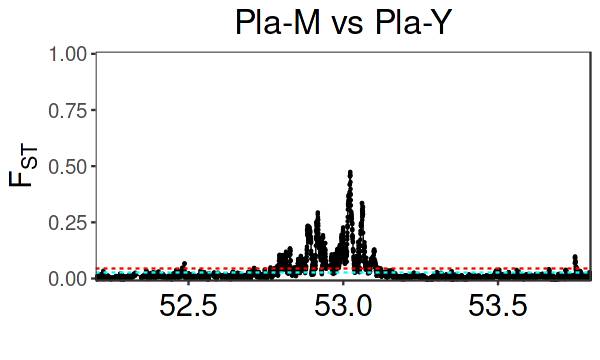

In [40]:
options(repr.plot.width=5, repr.plot.height=3)
per95=0.0273
per99=0.0453

fst_PlaFR_PlaY = ggplot(AvePlaFRYe_w3KBs300b[sites >= 20 & scaffold == 'Chr6'], aes(x=mid, y=Fst_PlaFR_PlaY)) +

    geom_point(alpha=1, size=0.5, pch=20) +
    geom_line(lwd=0.3) +
    geom_hline(yintercept = c(per95, per99), col=c('cyan','red'), lty=2) +

    # # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=RosEl, breaks=c(52.5e6,53e6,53.5e6), labels=c(52.5,'53.0',53.5)) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression(F[ST]), title='Pla-M vs Pla-Y') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
fst_PlaFR_PlaY

In [41]:
options(repr.plot.width=15, repr.plot.height=3)
per95 = 0.0747
per99 = 0.1312

fst_AveFR_PlaFR = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 20 & chrom == ], aes(x=midCum, y=Fst_AveFR_PlaFR)) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    geom_point(alpha=1, size=0.5, pch=20) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_PlaFR >= per95], aes(x=midCum, y=Fst_AveFR_PlaFR), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_PlaFR >= per99], aes(x=midCum, y=Fst_AveFR_PlaFR), size=1.5, pch=19, col='red') + # 99 percentile
    # geom_line(lwd=0.3) +
    geom_hline(yintercept = c(per95, per99), col=c('cyan','red'), lty=2) +
    
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression(F[ST]), title='Ave-M vs Pla-M') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
fst_AveFR_PlaFR

ERROR: Error in parse(text = x, srcfile = src): <text>:5:71: unexpected ']'
4: 
5: fst_AveFR_PlaFR = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 20 & chrom == ]
                                                                         ^


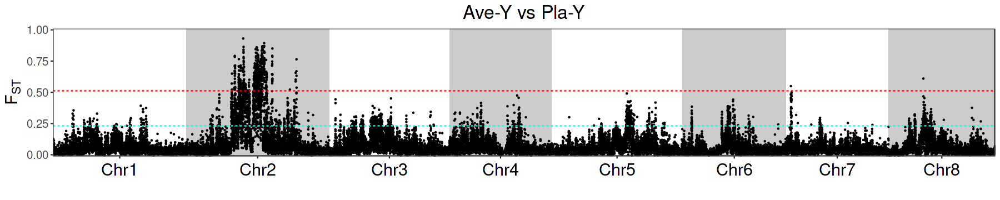

In [42]:
options(repr.plot.width=15, repr.plot.height=3)
per95 = 0.2315
per99 = 0.5132

fst_AveY_PlaY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 20], aes(x=midCum, y=Fst_AveY_PlaY)) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    geom_point(alpha=1, size=0.5, pch=20) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaY >= per95], aes(x=midCum, y=Fst_AveY_PlaY), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaY >= per99], aes(x=midCum, y=Fst_AveY_PlaY), size=1.5, pch=19, col='red') + # 99 percentile
    # geom_line(lwd=0.3) +
    geom_hline(yintercept = c(per95, per99), col=c('cyan','red'), lty=2) +
    
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression(F[ST]), title='Ave-Y vs Pla-Y') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
fst_AveY_PlaY

Warning message:
“Removed 3 rows containing missing values (`geom_point()`).”


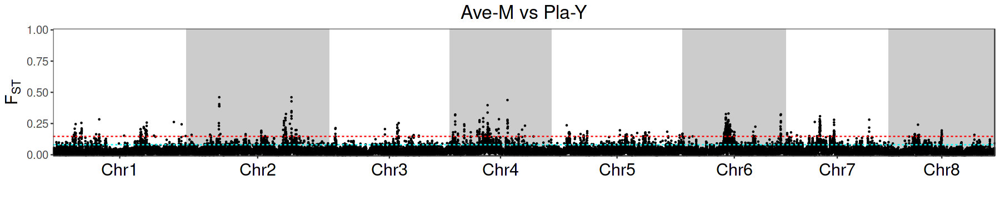

In [43]:
options(repr.plot.width=15, repr.plot.height=3)
per95 = 0.0823
per99 = 0.1467

fst_AveFR_PlaY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 20], aes(x=midCum, y=Fst_AveFR_PlaY)) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    geom_point(alpha=1, size=0.5, pch=20) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_PlaY >= per95], aes(x=midCum, y=Fst_AveFR_PlaY), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveFR_PlaY >= per99], aes(x=midCum, y=Fst_AveFR_PlaY), size=1.5, pch=19, col='red') + # 99 percentile
    # geom_line(lwd=0.3) +
    geom_hline(yintercept = c(per95, per99), col=c('cyan','red'), lty=2) +
 
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression(F[ST]), title='Ave-M vs Pla-Y') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
fst_AveFR_PlaY

Warning message:
“Removed 2 rows containing missing values (`geom_point()`).”


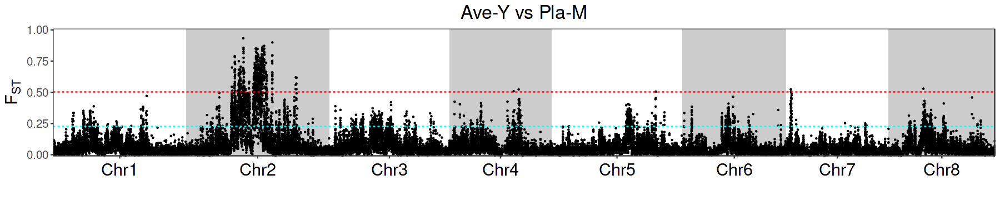

In [44]:
options(repr.plot.width=15, repr.plot.height=3)
per95 = 0.2287
per99 = 0.5043

fst_AveY_PlaFR = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 20], aes(x=midCum, y=Fst_AveY_PlaFR)) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    geom_point(alpha=1, size=0.5, pch=20) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaFR >= per95], aes(x=midCum, y=Fst_AveY_PlaFR), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_AveY_PlaFR >= per99], aes(x=midCum, y=Fst_AveY_PlaFR), size=1.5, pch=19, col='red') + # 99 percentile
    # geom_line(lwd=0.3) +
    geom_hline(yintercept = c(per95, per99), col=c('cyan','red'), lty=2) +
     
    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1.01)) +
    labs(x='', y=expression(F[ST]), title='Ave-Y vs Pla-M') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
fst_AveY_PlaFR

Warning message:
“Removed 5 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 24 rows containing missing values or values outside the scale range
(`geom_point()`).”


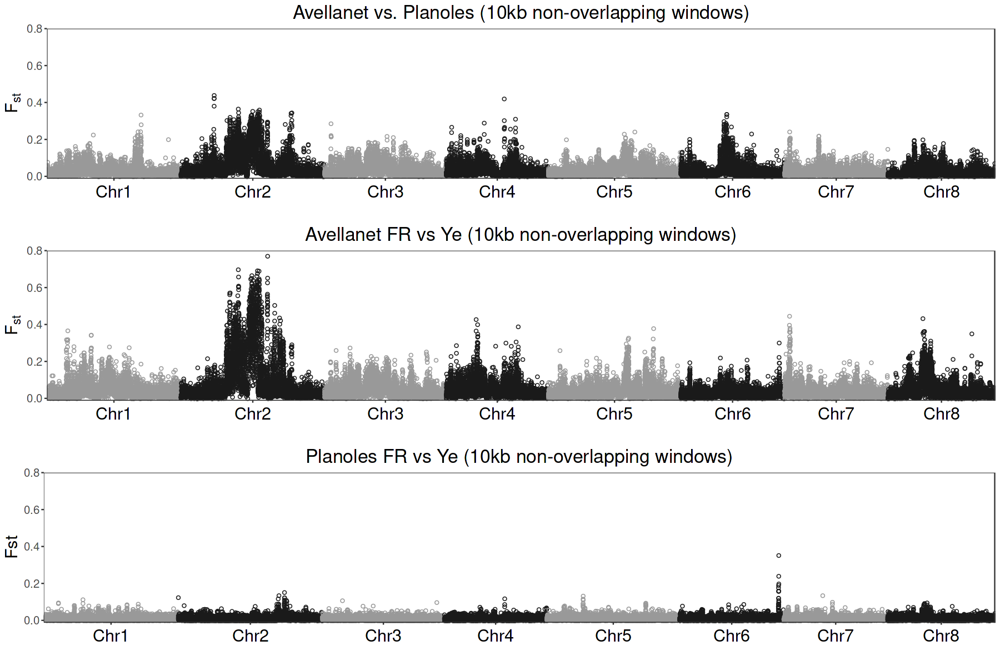

In [15]:
options(repr.plot.width=15,repr.plot.height=10)
grid.arrange(fst_Ave_Pla, fst_AveFR_AveY, fst_PlaFR_PlaY, nrow=3)

Warning message:
“Removed 6 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 5 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 4 rows containing missing values or values outside the scale range
(`geom_point()`).”


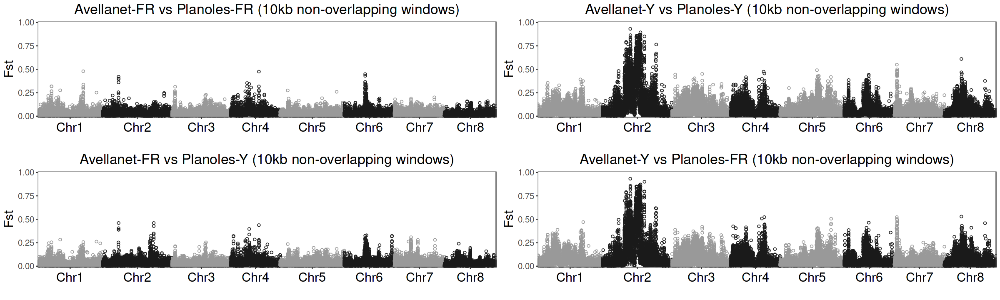

In [64]:
options(repr.plot.width=20,repr.plot.height=6)
grid.arrange(fst_AveFR_PlaFR, fst_AveY_PlaY, 
             fst_AveFR_PlaY, fst_AveY_PlaFR,
             nrow=2)

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 5 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 3 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”


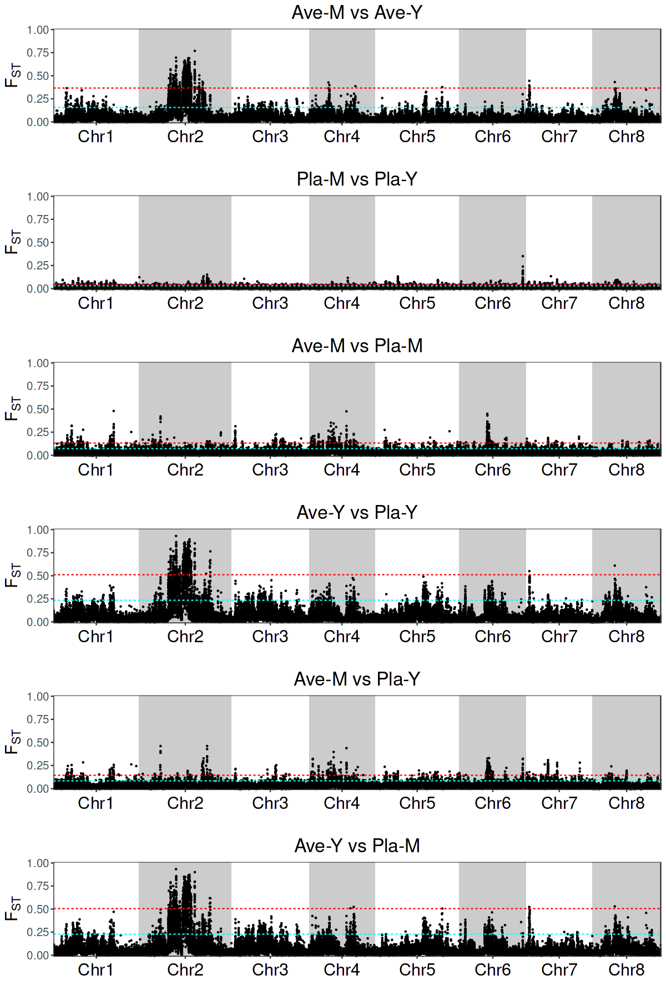

In [38]:
options(repr.plot.width=10, repr.plot.height=15)
grid.arrange(fst_AveFR_AveY, 
             fst_PlaFR_PlaY, 
             fst_AveFR_PlaFR, 
             fst_AveY_PlaY, 
             fst_AveFR_PlaY, 
             fst_AveY_PlaFR, 
             ncol=1)

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 5 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 3 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”


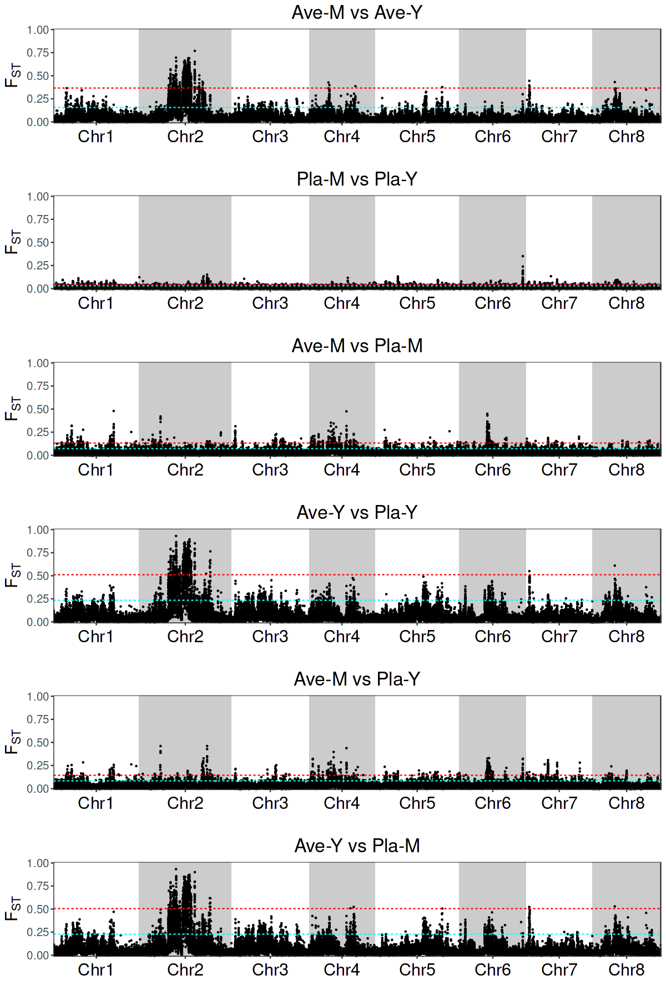

In [39]:
fst_gridPlot = grid.arrange(fst_AveFR_AveY, 
             fst_PlaFR_PlaY, 
             fst_AveFR_PlaFR, 
             fst_AveY_PlaY, 
             fst_AveFR_PlaY, 
             fst_AveY_PlaFR, 
             ncol=1)
ggsave(fst_gridPlot, filename='_figures/fst_AvePlaMY_dots.pdf', width=10, height=16)

In [ ]:
##

### Dxy, pi

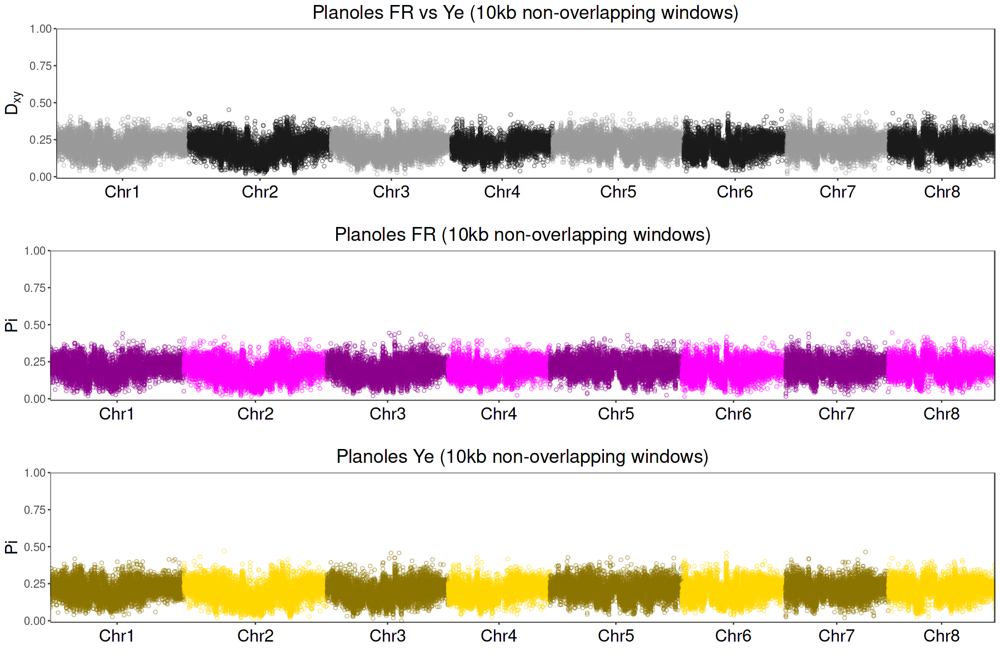

In [18]:
options(repr.plot.width=15, repr.plot.height=10)
plot_theme1 = plot_theme + 
                theme(legend.position = "none",
                      plot.title = element_text(hjust = 0.5, size=20), 
                      axis.title = element_text(size = 18),
                      axis.text.y = element_text(size = 12),
                      axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
                      )


# Plots ----
dxy_PlaFR_PlaY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=dxy_PlaFR_PlaY)) +
    geom_point(aes(color=as.factor(scaffold)), alpha=0.5, size=1.3, pch=1) +
    scale_color_manual(values = rep(c("grey60", "grey10"), 4)) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1)) +
    labs(x='', y=expression(D[xy]), title='Planoles FR vs Ye (10kb non-overlapping windows)') +
    plot_theme1


pi_PlaFR = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=pi_PlaFR)) +
    geom_point(aes(color=as.factor(scaffold)), alpha=0.5, size=1.3, pch=1) +
    scale_color_manual(values = rep(c("magenta4", "magenta"), 4)) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1)) +
    labs(x='', y='Pi', title='Planoles FR (10kb non-overlapping windows)') +
    plot_theme1


pi_PlaY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=pi_PlaY)) +
    geom_point(aes(color=as.factor(scaffold)), alpha=0.5, size=1.3, pch=1) +
    scale_color_manual(values = rep(c("gold4", "gold"), 4)) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1)) +
    labs(x='', y='Pi', title='Planoles Ye (10kb non-overlapping windows)') +
    plot_theme1


grid.arrange(dxy_PlaFR_PlaY, pi_PlaFR, pi_PlaY, nrow=3)

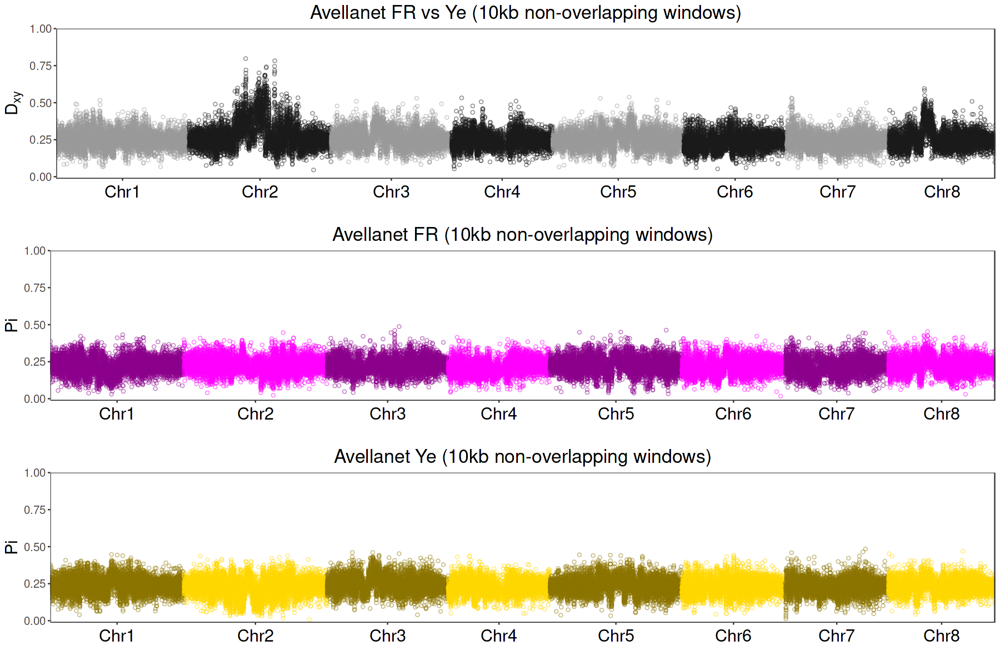

In [19]:
options(repr.plot.width=15, repr.plot.height=10)
plot_theme1 = plot_theme + 
                theme(legend.position = "none",
                      plot.title = element_text(hjust = 0.5, size=20), 
                      axis.title = element_text(size = 18),
                      axis.text.y = element_text(size = 12),
                      axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
                      )


# Plots ----
dxy_AveFR_AveY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=dxy_AveFR_AveY)) +
    geom_point(aes(color=as.factor(scaffold)), alpha=0.5, size=1.3, pch=1) +
    scale_color_manual(values = rep(c("grey60", "grey10"), 4)) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1)) +
    labs(x='', y=expression(D[xy]), title='Avellanet FR vs Ye (10kb non-overlapping windows)') +
    plot_theme1


pi_AveFR = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=pi_AveFR)) +
    geom_point(aes(color=as.factor(scaffold)), alpha=0.5, size=1.3, pch=1) +
    scale_color_manual(values = rep(c("magenta4", "magenta"), 4)) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1)) +
    labs(x='', y='Pi', title='Avellanet FR (10kb non-overlapping windows)') +
    plot_theme1


pi_AveY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=pi_AveY)) +
    geom_point(aes(color=as.factor(scaffold)), alpha=0.5, size=1.3, pch=1) +
    scale_color_manual(values = rep(c("gold4", "gold"), 4)) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1)) +
    labs(x='', y='Pi', title='Avellanet Ye (10kb non-overlapping windows)') +
    plot_theme1


grid.arrange(dxy_AveFR_AveY, pi_AveFR, pi_AveY, nrow=3)

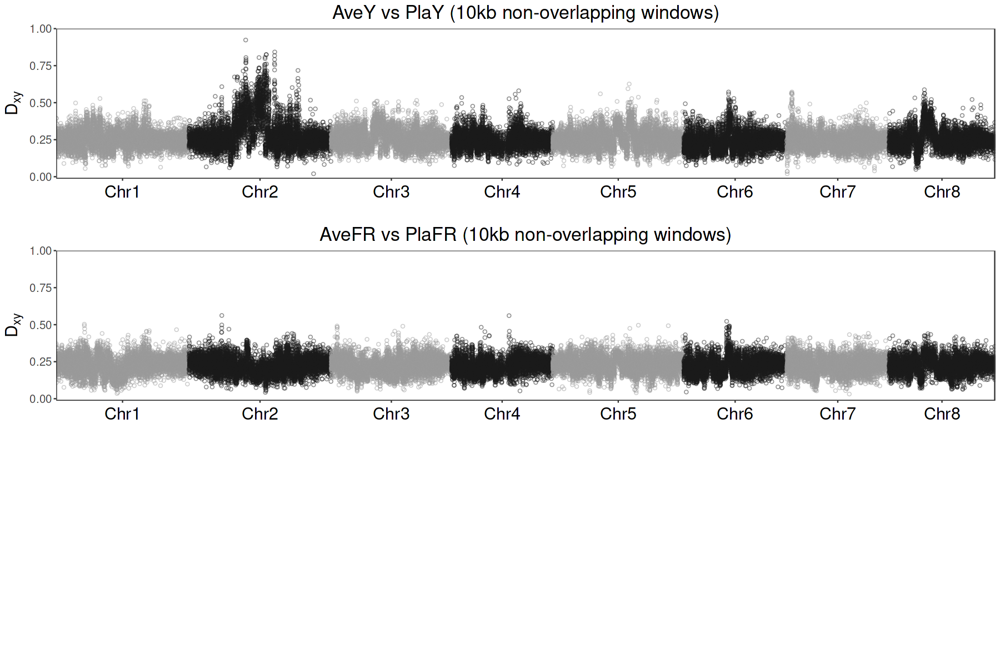

In [29]:
options(repr.plot.width=15, repr.plot.height=10)
plot_theme1 = plot_theme + 
                theme(legend.position = "none",
                      plot.title = element_text(hjust = 0.5, size=20), 
                      axis.title = element_text(size = 18),
                      axis.text.y = element_text(size = 12),
                      axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
                      )


# Plots ----
dxy_AveY_PlaY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=dxy_AveY_PlaY)) +
    geom_point(aes(color=as.factor(scaffold)), alpha=0.5, size=1.3, pch=1) +
    scale_color_manual(values = rep(c("grey60", "grey10"), 4)) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1)) +
    labs(x='', y=expression(D[xy]), title='AveY vs PlaY (10kb non-overlapping windows)') +
    plot_theme1

dxy_AveFR_PlaFR = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=dxy_AveFR_PlaFR)) +
    geom_point(aes(color=as.factor(scaffold)), alpha=0.5, size=1.3, pch=1) +
    scale_color_manual(values = rep(c("grey60", "grey10"), 4)) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,1)) +
    labs(x='', y=expression(D[xy]), title='AveFR vs PlaFR (10kb non-overlapping windows)') +
    plot_theme1

grid.arrange(dxy_AveY_PlaY, dxy_AveFR_PlaFR, nrow=3)

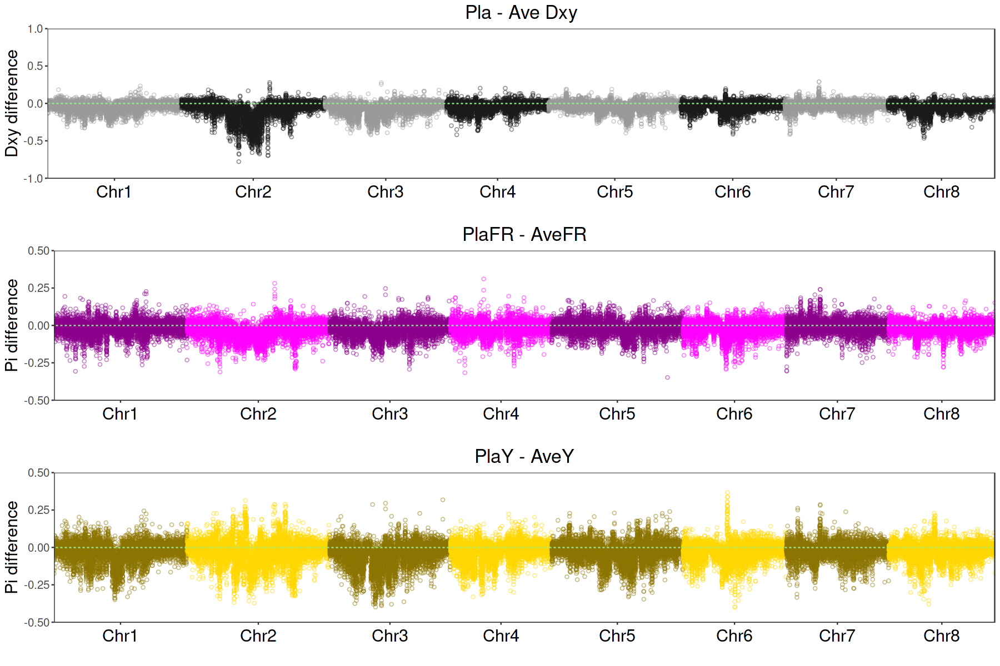

In [33]:
options(repr.plot.width=15, repr.plot.height=10)
plot_theme1 = plot_theme + 
                theme(legend.position = "none",
                      plot.title = element_text(hjust = 0.5, size=20), 
                      axis.title = element_text(size = 18),
                      axis.text.y = element_text(size = 12),
                      axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
                      )


diff_dxy = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=dxy_PlaFR_PlaY-dxy_AveFR_AveY)) +
    geom_point(aes(color=as.factor(scaffold)), alpha=0.5, size=1.3, pch=1) +
    geom_abline(slope=0, intercept=0, col='lightgreen', lty=2) +
    scale_color_manual(values = rep(c("grey60", "grey10"), 4)) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-1,1)) +
    labs(x='', y='Dxy difference', title='Pla - Ave Dxy') +
    plot_theme1

diff_piFR = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=pi_PlaFR-pi_AveFR)) +
    geom_point(aes(color=as.factor(scaffold)), alpha=0.5, size=1.3, pch=1) +
    geom_abline(slope=0, intercept=0, col='lightgreen', lty=2) +
    scale_color_manual(values = rep(c("magenta4", "magenta"), 4)) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.5,0.5)) +
    labs(x='', y='Pi difference', title='PlaFR - AveFR') +
    plot_theme1

diff_piY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 10], aes(x=midCum, y=pi_PlaY-pi_AveY)) +
    geom_point(aes(color=as.factor(scaffold)), alpha=0.5, size=1.3, pch=1) +
    geom_abline(slope=0, intercept=0, col='lightgreen', lty=2) +
    scale_color_manual(values = rep(c("gold4", "gold"), 4)) +
    scale_x_continuous(expand = c(0, 0), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.5,0.5)) +
    labs(x='', y='Pi difference', title='PlaY - AveY') +
    plot_theme1

grid.arrange(diff_dxy, diff_piFR, diff_piY, ncol=1)

## Overlap in Fst outliers

In [13]:
dat = AvePlaFRYe_w10KBs10KB[sites >= 20]
str(dat)

Classes ‘data.table’ and 'data.frame':	47375 obs. of  24 variables:
 $ windowID       : int  1 2 3 4 6 7 8 9 10 11 ...
 $ scaffold       : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ start          : int  1 10001 20001 30001 50001 60001 70001 80001 90001 100001 ...
 $ end            : int  10000 20000 30000 40000 60000 70000 80000 90000 100000 110000 ...
 $ mid            : num  7311 15387 24812 31845 57606 ...
 $ sites          : int  118 126 227 53 20 209 199 219 152 139 ...
 $ pi_AveFR       : num  0.278 0.233 0.228 0.257 0.301 ...
 $ pi_AveY        : num  0.324 0.23 0.221 0.278 0.284 ...
 $ pi_PlaFR       : num  0.287 0.202 0.22 0.225 0.233 ...
 $ pi_PlaY        : num  0.28 0.234 0.252 0.192 0.221 ...
 $ dxy_AveFR_AveY : num  0.309 0.236 0.234 0.274 0.313 ...
 $ dxy_AveFR_PlaFR: num  0.281 0.224 0.227 0.244 0.265 ...
 $ dxy_AveFR_PlaY : num  0.281 0.238 0.247 0.242 0.265 ...
 $ dxy_AveY_PlaFR : num  0.313 0.233 0.232 0.259 0.285 ...
 $ dxy_AveY_PlaY  : num  0.315 0.248 0.257 0.252 0.31

In [14]:
## Quantiles
q99_AveFR_AveY = quantile(dat$Fst_AveFR_AveY, probs = c(0.5,0.95,0.99))[3]
q95_AveFR_AveY = quantile(dat$Fst_AveFR_AveY, probs = c(0.5,0.95,0.99))[2]

q99_PlaFR_PlaY = quantile(dat$Fst_PlaFR_PlaY, probs = c(0.5,0.95,0.99))[3]
q95_PlaFR_PlaY = quantile(dat$Fst_PlaFR_PlaY, probs = c(0.5,0.95,0.99))[2]

q99_AveFR_PlaFR = quantile(dat$Fst_AveFR_PlaFR, probs = c(0.5,0.95,0.99))[3]
q95_AveFR_PlaFR = quantile(dat$Fst_AveFR_PlaFR, probs = c(0.5,0.95,0.99))[2]

q99_AveY_PlaY = quantile(dat$Fst_AveY_PlaY, probs = c(0.5,0.95,0.99))[3]
q95_AveY_PlaY = quantile(dat$Fst_AveY_PlaY, probs = c(0.5,0.95,0.99))[2]

q99_AveFR_PlaY = quantile(dat$Fst_AveFR_PlaY, probs = c(0.5,0.95,0.99))[3]
q95_AveFR_PlaY = quantile(dat$Fst_AveFR_PlaY, probs = c(0.5,0.95,0.99))[2]

q99_AveY_PlaFR = quantile(dat$Fst_AveY_PlaFR, probs = c(0.5,0.95,0.99))[3]
q95_AveY_PlaFR = quantile(dat$Fst_AveY_PlaFR, probs = c(0.5,0.95,0.99))[2]

In [15]:
## Define colors
dat = dat %>% 
        mutate(windowCol_col = case_when(
                                    Fst_AveFR_AveY >= q95_AveFR_AveY & Fst_PlaFR_PlaY >= q95_PlaFR_PlaY ~ "black",
                                    Fst_AveFR_AveY >= q95_AveFR_AveY ~ "grey70",
                                    Fst_PlaFR_PlaY >= q95_PlaFR_PlaY ~ "grey70",
                                    TRUE ~ "grey90"),
               windowCol_geo = case_when(
                                    Fst_AveFR_PlaFR >= q95_AveFR_PlaFR & Fst_AveY_PlaY >= q95_AveY_PlaY ~ "black",
                                    Fst_AveFR_PlaFR >= q95_AveFR_PlaFR ~ "grey70",
                                    Fst_AveY_PlaY >= q95_AveY_PlaY ~ "grey70",
                                    TRUE ~ "grey90"),
               windowCol_colgeo = case_when(
                                    Fst_AveFR_PlaY >= q95_AveFR_PlaY & Fst_AveY_PlaFR >= q95_AveY_PlaFR ~ "black",
                                    Fst_AveFR_PlaY >= q95_AveFR_PlaY ~ "grey70",
                                    Fst_AveY_PlaFR >= q95_AveY_PlaFR ~ "grey70",
                                    TRUE ~ "grey90"),
                
               ## Correlations with AveY
               windowCol_2_6 = case_when(
                                    Fst_AveFR_AveY >= q95_AveFR_AveY & Fst_AveY_PlaFR >= q95_AveY_PlaFR ~ "black",
                                    Fst_AveFR_AveY >= q95_AveFR_AveY ~ "grey70",
                                    Fst_AveY_PlaFR >= q95_AveY_PlaFR ~ "grey70",
                                    TRUE ~ "grey90"),
               
               windowCol_4_6 = case_when(
                                    Fst_AveY_PlaY >= q95_AveY_PlaY & Fst_AveY_PlaFR >= q95_AveY_PlaFR ~ "black",
                                    Fst_AveY_PlaY >= q95_AveY_PlaY ~ "grey70",
                                    Fst_AveY_PlaFR >= q95_AveY_PlaFR ~ "grey70",
                                    TRUE ~ "grey90"),

               windowCol_2_4 = case_when(
                                    Fst_AveFR_AveY >= q95_AveFR_AveY & Fst_AveY_PlaY >= q95_AveY_PlaY ~ "black",
                                    Fst_AveFR_AveY >= q95_AveFR_AveY ~ "grey70",
                                    Fst_AveY_PlaY >= q95_AveY_PlaY ~ "grey70",
                                    TRUE ~ "grey90")
              )

In [16]:
## YELLOW
cremosa = c('Chr1', 821293, 1095277)
aurina = c('Chr2', 951685, 1153653)
flavia = c('Chr2', 53368062, 53569435)
sulf = c('Chr4', 38248572, 38450336)

## MAGENTA
rubia = c('Chr5', 6169966, 6372151)
rosel = c('Chr6', 52789323, 53162505)

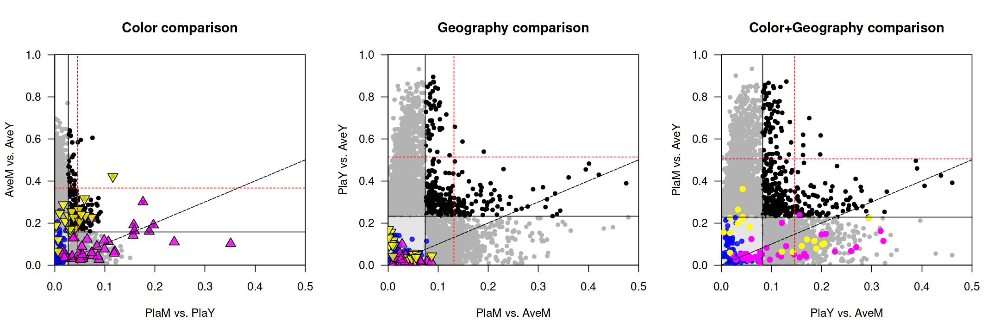

In [21]:
options(repr.plot.width=18, repr.plot.height=6)
par(xaxs='i', yaxs='i', mfrow=c(1,3), cex=1.2)


## ------ ##
## Col comparison ##
plot(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat, las = 1, main='Color comparison',
     xlab='PlaM vs. PlaY', ylab='AveM vs. AveY', pch=20, cex=1,
     xlim=c(0,0.5), ylim=c(0,1), col=dat$windowCol_col)

alphaVal = 0.8; geneSize = 1.2
geneName = rubia; geneColor = 'blue'; geneShape = 20
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = cremosa; geneColor = 'blue'; geneShape = 20
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = aurina; geneColor = 'blue'; geneShape = 20
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = sulf; geneColor = 'blue'; geneShape = 20
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = rosel; geneColor = 'magenta'; geneShape = 24
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = flavia; geneColor = 'yellow'; geneShape = 25
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

abline(h=c(q95_AveFR_AveY, q99_AveFR_AveY), col=c('black', 'red'), lty=1:2)
abline(v=c(q95_PlaFR_PlaY, q99_PlaFR_PlaY), col=c('black', 'red'), lty=1:2)
abline(a=0, b=1, lty='longdash')


## ------ ##
## Geo comparison ##
plot(Fst_AveY_PlaY~Fst_AveFR_PlaFR, dat, las = 1, main='Geography comparison',
     xlab='PlaM vs. AveM', ylab='PlaY vs. AveY', pch=20, cex=1,
     xlim=c(0,0.5), ylim=c(0,1), col=dat$windowCol_geo)

alphaVal = 0.8; geneSize = 1.2
geneName = rubia; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = sulf; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = cremosa; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = aurina; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = rosel; geneColor = 'magenta'; geneShape = 24
points(Fst_AveY_PlaY~Fst_AveFR_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = flavia; geneColor = 'yellow'; geneShape = 25
points(Fst_AveY_PlaY~Fst_AveFR_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

abline(h=c(q95_AveY_PlaY, q99_AveY_PlaY), col=c('black', 'red'), lty=1:2)
abline(v=c(q95_AveFR_PlaFR, q99_AveFR_PlaFR), col=c('black', 'red'), lty=1:2)
abline(a=0, b=1, lty='longdash')


## ------ ##
## Col+Geo comparison ##
plot(Fst_AveY_PlaFR~Fst_AveFR_PlaY, dat, las = 1, main='Color+Geography comparison',
     xlab='PlaY vs. AveM', ylab='PlaM vs. AveY', pch=20, cex=1,
     xlim=c(0,0.5), ylim=c(0,1), col=dat$windowCol_colgeo)

alphaVal = 0.8; geneSize = 1.2
geneName = rubia; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = cremosa; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = aurina; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = sulf; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 1; geneSize = 1.5
geneName = rosel; geneColor = 'magenta'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 1; geneSize = 1.5
geneName = flavia; geneColor = 'yellow'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

abline(h=c(q95_AveY_PlaFR, q99_AveY_PlaFR), col=c('black', 'red'), lty=1:2)
abline(v=c(q95_AveFR_PlaY, q99_AveFR_PlaY), col=c('black', 'red'), lty=1:2)
abline(a=0, b=1, lty='longdash')

In [32]:
pdf('./_figures/fst_Col_comparison.pdf', width=4, height=4)
par(xaxs='i', yaxs='i', mfrow=c(1,1), cex=1)

## ------ ##
## Col comparison ##
plot(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat, las = 1, main='Color comparison',
     xlab=expression('PlaM vs. PlaY'), ylab='AveM vs. AveY', pch=20, cex=1,
     xlim=c(0,0.5), ylim=c(0,1), col=dat$windowCol_col)

alphaVal = 0.8; geneSize = 1.2
geneName = rubia; geneColor = 'blue'; geneShape = 20
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = cremosa; geneColor = 'blue'; geneShape = 20
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = aurina; geneColor = 'blue'; geneShape = 20
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = sulf; geneColor = 'blue'; geneShape = 20
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 1; geneSize = 2
geneName = rosel; geneColor = 'magenta'; geneShape = 21
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 1; geneSize = 2
geneName = flavia; geneColor = 'gold3'; geneShape = 21
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

abline(h=c(q95_AveFR_AveY, q99_AveFR_AveY), col=c('black', 'red'), lty=1:2)
abline(v=c(q95_PlaFR_PlaY, q99_PlaFR_PlaY), col=c('black', 'red'), lty=1:2)
abline(a=0, b=1, lty='longdash')
dev.off()

png 
  2

In [34]:
pdf('./_figures/fst_pairwise_comparison.pdf', width=18, height=6)

options(repr.plot.width=18, repr.plot.height=6)
par(xaxs='i', yaxs='i', mfrow=c(1,3), cex=1.2)

## ------ ##
## Col comparison ##
plot(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat, las = 1, main='Color comparison',
     xlab='PlaM vs. PlaY', ylab='AveM vs. AveY', pch=20, cex=1,
     xlim=c(0,0.5), ylim=c(0,1), col=dat$windowCol_col)

alphaVal = 0.8; geneSize = 1.2
geneName = rubia; geneColor = 'blue'; geneShape = 20
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = cremosa; geneColor = 'blue'; geneShape = 20
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = aurina; geneColor = 'blue'; geneShape = 20
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = sulf; geneColor = 'blue'; geneShape = 20
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = rosel; geneColor = 'magenta'; geneShape = 24
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = flavia; geneColor = 'yellow'; geneShape = 25
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

abline(h=c(q95_AveFR_AveY, q99_AveFR_AveY), col=c('black', 'red'), lty=1:2)
abline(v=c(q95_PlaFR_PlaY, q99_PlaFR_PlaY), col=c('black', 'red'), lty=1:2)
abline(a=0, b=1, lty='longdash')


## ------ ##
## Geo comparison ##
plot(Fst_AveY_PlaY~Fst_AveFR_PlaFR, dat, las = 1, main='Geography comparison',
     xlab='PlaM vs. AveM', ylab='PlaY vs. AveY', pch=20, cex=1,
     xlim=c(0,0.5), ylim=c(0,1), col=dat$windowCol_geo)

alphaVal = 0.8; geneSize = 1.2
geneName = rubia; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = sulf; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = cremosa; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = aurina; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = rosel; geneColor = 'magenta'; geneShape = 24
points(Fst_AveY_PlaY~Fst_AveFR_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = flavia; geneColor = 'yellow'; geneShape = 25
points(Fst_AveY_PlaY~Fst_AveFR_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

abline(h=c(q95_AveY_PlaY, q99_AveY_PlaY), col=c('black', 'red'), lty=1:2)
abline(v=c(q95_AveFR_PlaFR, q99_AveFR_PlaFR), col=c('black', 'red'), lty=1:2)
abline(a=0, b=1, lty='longdash')


## ------ ##
## Col+Geo comparison ##
plot(Fst_AveY_PlaFR~Fst_AveFR_PlaY, dat, las = 1, main='Color+Geography comparison',
     xlab='PlaY vs. AveM', ylab='PlaM vs. AveY', pch=20, cex=1,
     xlim=c(0,0.5), ylim=c(0,1), col=dat$windowCol_colgeo)

alphaVal = 0.8; geneSize = 1.2
geneName = rubia; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = cremosa; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = aurina; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = sulf; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = rosel; geneColor = 'magenta'; geneShape = 24
points(Fst_AveY_PlaFR~Fst_AveFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = flavia; geneColor = 'yellow'; geneShape = 25
points(Fst_AveY_PlaFR~Fst_AveFR_PlaY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

abline(h=c(q95_AveY_PlaFR, q99_AveY_PlaFR), col=c('black', 'red'), lty=1:2)
abline(v=c(q95_AveFR_PlaY, q99_AveFR_PlaY), col=c('black', 'red'), lty=1:2)
abline(a=0, b=1, lty='longdash')

dev.off()

png 
  2

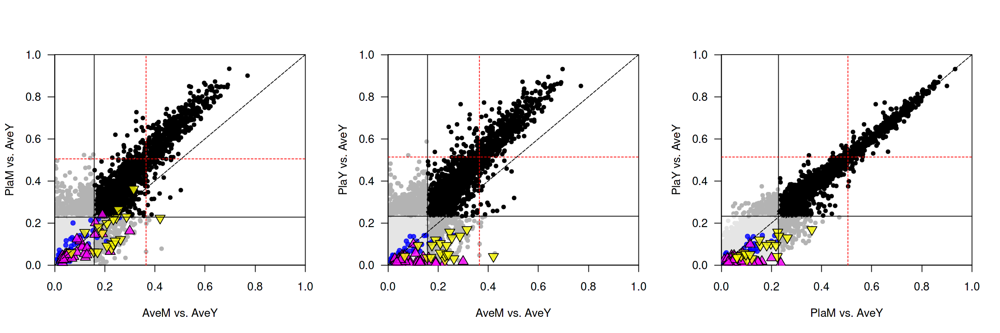

In [33]:
options(repr.plot.width=18, repr.plot.height=6)
par(xaxs='i', yaxs='i', mfrow=c(1,3), cex=1.2)

## 2-6 comparison
plot(Fst_AveY_PlaFR~Fst_AveFR_AveY, dat, las = 1, #main='Color comparison',
     xlab='AveM vs. AveY', ylab='PlaM vs. AveY', pch=20, cex=1,
     xlim=c(0,1), ylim=c(0,1), col=dat$windowCol_2_6)

alphaVal = 0.8; geneSize = 1.2
geneName = rubia; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = cremosa; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = aurina; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = sulf; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = rosel; geneColor = 'magenta'; geneShape = 24
points(Fst_AveY_PlaFR~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = flavia; geneColor = 'yellow'; geneShape = 25
points(Fst_AveY_PlaFR~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

abline(v=c(q95_AveFR_AveY, q99_AveFR_AveY), col=c('black', 'red'), lty=1:2)
abline(h=c(q95_AveY_PlaFR, q99_AveY_PlaFR), col=c('black', 'red'), lty=1:2)
abline(a=0, b=1, lty='longdash')


###
## 2-4 comparison
plot(Fst_AveY_PlaY~Fst_AveFR_AveY, dat, las = 1, #main='Geography comparison',
     xlab='AveM vs. AveY', ylab='PlaY vs. AveY', pch=20, cex=1,
     xlim=c(0,1), ylim=c(0,1), col=dat$windowCol_2_4)

alphaVal = 0.8; geneSize = 1.2
geneName = rubia; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = cremosa; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = aurina; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = sulf; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = rosel; geneColor = 'magenta'; geneShape = 24
points(Fst_AveY_PlaY~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = flavia; geneColor = 'yellow'; geneShape = 25
points(Fst_AveY_PlaY~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

abline(v=c(q95_AveFR_AveY, q99_AveFR_AveY), col=c('black', 'red'), lty=1:2)
abline(h=c(q95_AveY_PlaY, q99_AveY_PlaY), col=c('black', 'red'), lty=1:2)
abline(a=0, b=1, lty='longdash')


###
## 6-4 comparison
plot(Fst_AveY_PlaY~Fst_AveY_PlaFR, dat, las = 1, #main='Geography comparison',
     xlab='PlaM vs. AveY', ylab='PlaY vs. AveY', pch=20, cex=1,
     xlim=c(0,1), ylim=c(0,1), col=dat$windowCol_4_6)

alphaVal = 0.8; geneSize = 1.2
geneName = rubia; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveY_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = cremosa; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveY_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = aurina; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveY_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = sulf; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveY_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = rosel; geneColor = 'magenta'; geneShape = 24
points(Fst_AveY_PlaY~Fst_AveY_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = flavia; geneColor = 'yellow'; geneShape = 25
points(Fst_AveY_PlaY~Fst_AveY_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

abline(v=c(q95_AveY_PlaFR, q99_AveY_PlaFR), col=c('black', 'red'), lty=1:2)
abline(h=c(q95_AveY_PlaY, q99_AveY_PlaY), col=c('black', 'red'), lty=1:2)
abline(a=0, b=1, lty='longdash')

In [ ]:
pdf('./_figures/fst_pairwise_comparison_AveY.pdf', width=12, height=4)

# options(repr.plot.width=18, repr.plot.height=6)
par(xaxs='i', yaxs='i', mfrow=c(1,3), cex=1, mar=c(4,4,2,2))

## 2-6 comparison
plot(Fst_AveY_PlaFR~Fst_AveFR_AveY, dat, las = 1, #main='Color comparison',
     xlab='AveM vs. AveY', ylab='PlaM vs. AveY', pch=20, cex=1,
     xlim=c(0,1), ylim=c(0,1), col=dat$windowCol_2_6)

alphaVal = 0.8; geneSize = 1.2
geneName = rubia; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = cremosa; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = aurina; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = sulf; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaFR~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = rosel; geneColor = 'magenta'; geneShape = 24
points(Fst_AveY_PlaFR~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = flavia; geneColor = 'yellow'; geneShape = 25
points(Fst_AveY_PlaFR~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

abline(v=c(q95_AveFR_AveY, q99_AveFR_AveY), col=c('black', 'red'), lty=1:2)
abline(h=c(q95_AveY_PlaFR, q99_AveY_PlaFR), col=c('black', 'red'), lty=1:2)
abline(a=0, b=1, lty='longdash')


###
## 2-4 comparison
plot(Fst_AveY_PlaY~Fst_AveFR_AveY, dat, las = 1, #main='Geography comparison',
     xlab='AveM vs. AveY', ylab='PlaY vs. AveY', pch=20, cex=1,
     xlim=c(0,1), ylim=c(0,1), col=dat$windowCol_2_4)

alphaVal = 0.8; geneSize = 1.2
geneName = rubia; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = cremosa; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = aurina; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = sulf; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = rosel; geneColor = 'magenta'; geneShape = 24
points(Fst_AveY_PlaY~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = flavia; geneColor = 'yellow'; geneShape = 25
points(Fst_AveY_PlaY~Fst_AveFR_AveY, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

abline(v=c(q95_AveFR_AveY, q99_AveFR_AveY), col=c('black', 'red'), lty=1:2)
abline(h=c(q95_AveY_PlaY, q99_AveY_PlaY), col=c('black', 'red'), lty=1:2)
abline(a=0, b=1, lty='longdash')


###
## 6-4 comparison
plot(Fst_AveY_PlaY~Fst_AveY_PlaFR, dat, las = 1, #main='Geography comparison',
     xlab='PlaM vs. AveY', ylab='PlaY vs. AveY', pch=20, cex=1,
     xlim=c(0,1), ylim=c(0,1), col=dat$windowCol_4_6)

alphaVal = 0.8; geneSize = 1.2
geneName = rubia; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveY_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = cremosa; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveY_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = aurina; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveY_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)
geneName = sulf; geneColor = 'blue'; geneShape = 20
points(Fst_AveY_PlaY~Fst_AveY_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = rosel; geneColor = 'magenta'; geneShape = 24
points(Fst_AveY_PlaY~Fst_AveY_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

alphaVal = 0.8; geneSize = 1.5
geneName = flavia; geneColor = 'yellow'; geneShape = 25
points(Fst_AveY_PlaY~Fst_AveY_PlaFR, 
       dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,alphaVal), col=alpha(geneColor,alphaVal), pch=geneShape, cex=geneSize)

abline(v=c(q95_AveY_PlaFR, q99_AveY_PlaFR), col=c('black', 'red'), lty=1:2)
abline(h=c(q95_AveY_PlaY, q99_AveY_PlaY), col=c('black', 'red'), lty=1:2)
abline(a=0, b=1, lty='longdash')

dev.off()

### Individual plots

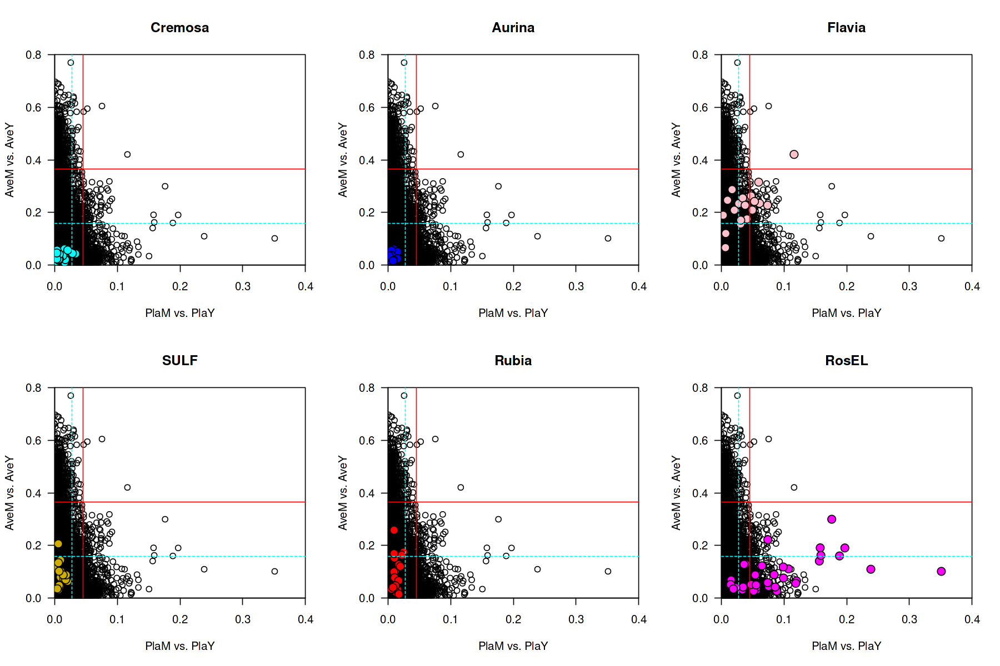

In [180]:
options(repr.plot.width=15, repr.plot.height=10)
par(xaxs='i', yaxs='i', mfrow=c(2,3), cex=1)


plot(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat, las = 1, main='Cremosa',
     xlab='PlaM vs. PlaY', ylab='AveM vs. AveY',
     xlim=c(0,0.4), ylim=c(0,0.8))
geneName = cremosa; geneColor = 'cyan'
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(v=0.0453, col='red', lty=1) # 99 percentile
abline(v=0.0273, col='cyan', lty=2) # 95 percentile
abline(h=0.3652, col='red', lty=1) # 99 percentile
abline(h=0.1584, col='cyan', lty=2) # 95 percentile


plot(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat, las = 1, main='Aurina',
     xlab='PlaM vs. PlaY', ylab='AveM vs. AveY',
     xlim=c(0,0.4), ylim=c(0,0.8))
geneName = aurina; geneColor = 'blue'
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(v=0.0453, col='red', lty=1) # 99 percentile
abline(v=0.0273, col='cyan', lty=2) # 95 percentile
abline(h=0.3652, col='red', lty=1) # 99 percentile
abline(h=0.1584, col='cyan', lty=2) # 95 percentile


plot(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat, las = 1, main='Flavia',
     xlab='PlaM vs. PlaY', ylab='AveM vs. AveY',
     xlim=c(0,0.4), ylim=c(0,0.8))
geneName = flavia; geneColor = 'pink'
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(v=0.0453, col='red', lty=1) # 99 percentile
abline(v=0.0273, col='cyan', lty=2) # 95 percentile
abline(h=0.3652, col='red', lty=1) # 99 percentile
abline(h=0.1584, col='cyan', lty=2) # 95 percentile


plot(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat, las = 1, main='SULF',
     xlab='PlaM vs. PlaY', ylab='AveM vs. AveY',
     xlim=c(0,0.4), ylim=c(0,0.8))
geneName = sulf; geneColor = 'gold3'
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(v=0.0453, col='red', lty=1) # 99 percentile
abline(v=0.0273, col='cyan', lty=2) # 95 percentile
abline(h=0.3652, col='red', lty=1) # 99 percentile
abline(h=0.1584, col='cyan', lty=2) # 95 percentile

plot(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat, las = 1, main='Rubia',
     xlab='PlaM vs. PlaY', ylab='AveM vs. AveY',
     xlim=c(0,0.4), ylim=c(0,0.8))
geneName = rubia; geneColor = 'red'
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(v=0.0453, col='red', lty=1) # 99 percentile
abline(v=0.0273, col='cyan', lty=2) # 95 percentile
abline(h=0.3652, col='red', lty=1) # 99 percentile
abline(h=0.1584, col='cyan', lty=2) # 95 percentile


plot(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat, las = 1, main='RosEL',
     xlab='PlaM vs. PlaY', ylab='AveM vs. AveY',
     xlim=c(0,0.4), ylim=c(0,0.8))
geneName = rosel; geneColor = 'magenta'
points(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(v=0.0453, col='red', lty=1) # 99 percentile
abline(v=0.0273, col='cyan', lty=2) # 95 percentile
abline(h=0.3652, col='red', lty=1) # 99 percentile
abline(h=0.1584, col='cyan', lty=2) # 95 percentile

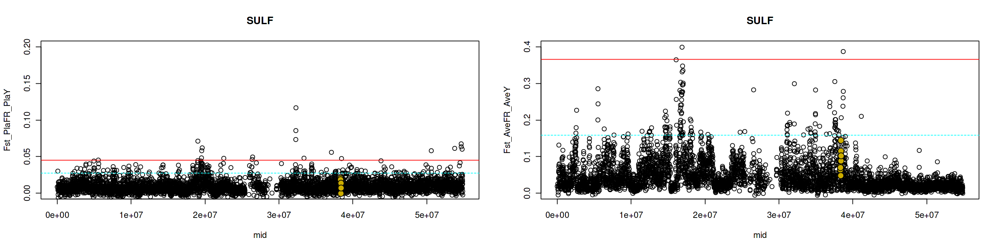

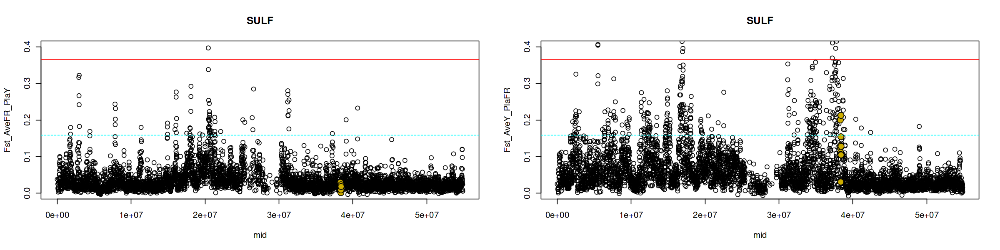

In [174]:
options(repr.plot.width=20, repr.plot.height=5)
par(mfrow=c(1,2))
geneName = sulf; geneColor = 'gold3'

plot(Fst_PlaFR_PlaY~mid, dat[scaffold=='Chr4'], ylim=c(0,0.2), main='SULF')
points(Fst_PlaFR_PlaY~mid, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(h=0.0453, col='red', lty=1) # 99 percentile
abline(h=0.0273, col='cyan', lty=2) # 95 percentile

plot(Fst_AveFR_AveY~mid, dat[scaffold=='Chr4'], ylim=c(0,0.4), main='SULF')
points(Fst_AveFR_AveY~mid, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(h=0.3652, col='red', lty=1) # 99 percentile
abline(h=0.1584, col='cyan', lty=2) # 95 percentile

plot(Fst_AveFR_PlaY~mid, dat[scaffold=='Chr4'], ylim=c(0,0.4), main='SULF')
points(Fst_AveFR_PlaY~mid, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(h=0.3652, col='red', lty=1) # 99 percentile
abline(h=0.1584, col='cyan', lty=2) # 95 percentile

plot(Fst_AveY_PlaFR~mid, dat[scaffold=='Chr4'], ylim=c(0,0.4), main='SULF')
points(Fst_AveY_PlaFR~mid, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(h=0.3652, col='red', lty=1) # 99 percentile
abline(h=0.1584, col='cyan', lty=2) # 95 percentile

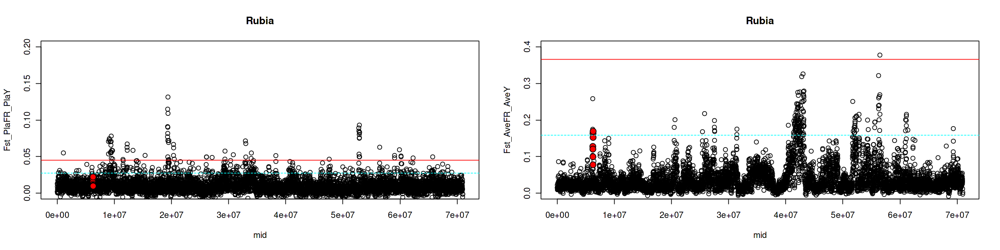

In [175]:
options(repr.plot.width=20, repr.plot.height=5)
par(mfrow=c(1,2))
geneName = rubia; geneColor = 'red'

plot(Fst_PlaFR_PlaY~mid, dat[scaffold=='Chr5'], ylim=c(0,0.2), main='Rubia')
points(Fst_PlaFR_PlaY~mid, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(h=0.0453, col='red', lty=1) # 99 percentile
abline(h=0.0273, col='cyan', lty=2) # 95 percentile

plot(Fst_AveFR_AveY~mid, dat[scaffold=='Chr5'], ylim=c(0,0.4), main='Rubia')
points(Fst_AveFR_AveY~mid, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(h=0.3652, col='red', lty=1) # 99 percentile
abline(h=0.1584, col='cyan', lty=2) # 95 percentile

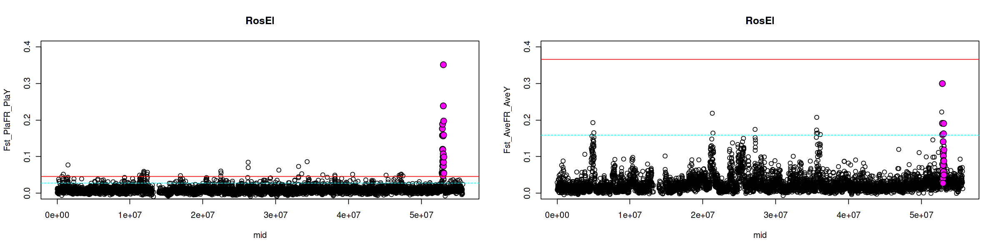

In [176]:
options(repr.plot.width=20, repr.plot.height=5)
par(mfrow=c(1,2))
geneName = rosel; geneColor = 'magenta'

plot(Fst_PlaFR_PlaY~mid, dat[scaffold=='Chr6'], ylim=c(0,0.4), main='RosEl')
points(Fst_PlaFR_PlaY~mid, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(h=0.0453, col='red', lty=1) # 99 percentile
abline(h=0.0273, col='cyan', lty=2) # 95 percentile

plot(Fst_AveFR_AveY~mid, dat[scaffold=='Chr6'], ylim=c(0,0.4), main='RosEl')
points(Fst_AveFR_AveY~mid, dat[scaffold==geneName[1] & start>=as.integer(geneName[2]) & end<=as.integer(geneName[3])], 
       bg=alpha(geneColor,1), pch=21, cex=1.5)
abline(h=0.3652, col='red', lty=1) # 99 percentile
abline(h=0.1584, col='cyan', lty=2) # 95 percentile

Warning message:
“Removed 1 rows containing missing values (`geom_rect()`).”
Warning message:
“Removed 1 rows containing missing values (`geom_rect()`).”
Warning message:
“Removed 1 rows containing missing values (`geom_rect()`).”
Warning message:
“Removed 1 rows containing missing values (`geom_rect()`).”
Warning message:
“Removed 6 rows containing missing values (`geom_point()`).”


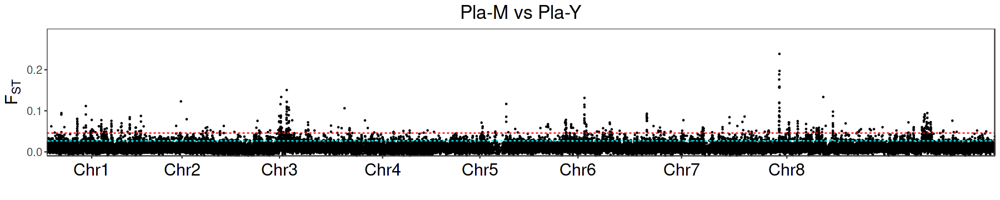

In [144]:
options(repr.plot.width=15, repr.plot.height=3)
per95=0.0273
per99=0.0453

fst_PlaFR_PlaY = ggplot(AvePlaFRYe_w10KBs10KB[sites >= 20], aes(x=midCum, y=Fst_PlaFR_PlaY)) +

    annotate("rect", xmin = 71920000, xmax = 149040000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 214260000, xmax = 269150000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 340140000, xmax = 395840000, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +
    annotate("rect", xmin = 451400000, xmax = 508801861, ymin = -0.01, ymax = 1.01, bg='grey50', alpha = .4) +

    # geom_point(aes(color=as.factor(scaffold)), alpha=1, size=1.5, pch=19) +        
    # scale_color_manual(values = rep(c("grey60", "grey10"), 4)) + 
    geom_point(alpha=1, size=0.5, pch=20) +
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_PlaFR_PlaY >= per95 & sites >= 10], aes(x=midCum, y=Fst_PlaFR_PlaY), size=1.5, pch=19, col='blue') + # 95 percentile
    # geom_point(data=AvePlaFRYe_w10KBs10KB[Fst_PlaFR_PlaY >= per99 & sites >= 10], aes(x=midCum, y=Fst_PlaFR_PlaY), size=1.5, pch=19, col='red') + # 99 percentile
    # geom_line(lwd=0.3) +
    geom_hline(yintercept = c(per95, per99), col=c('cyan','red'), lty=2) +

    # Axes and labels:
    scale_x_continuous(expand = c(0, 0), limits=c(0,508801861), label=axisToPlot$scaffold, breaks=axisToPlot$chromCenter) +
    scale_y_continuous(expand = c(0, 0), limits=c(-0.01,0.3)) +
    labs(x='', y=expression(F[ST]), title='Pla-M vs Pla-Y') +
    
    # Customize the theme:
    plot_theme + 
    theme(legend.position = "none",
          plot.title = element_text(hjust = 0.5, size=20), 
          axis.title = element_text(size = 18),
          axis.text.y = element_text(size = 12),
          axis.text.x = element_text(size = 18, vjust = 0.2, color = 'black')
          )
fst_PlaFR_PlaY

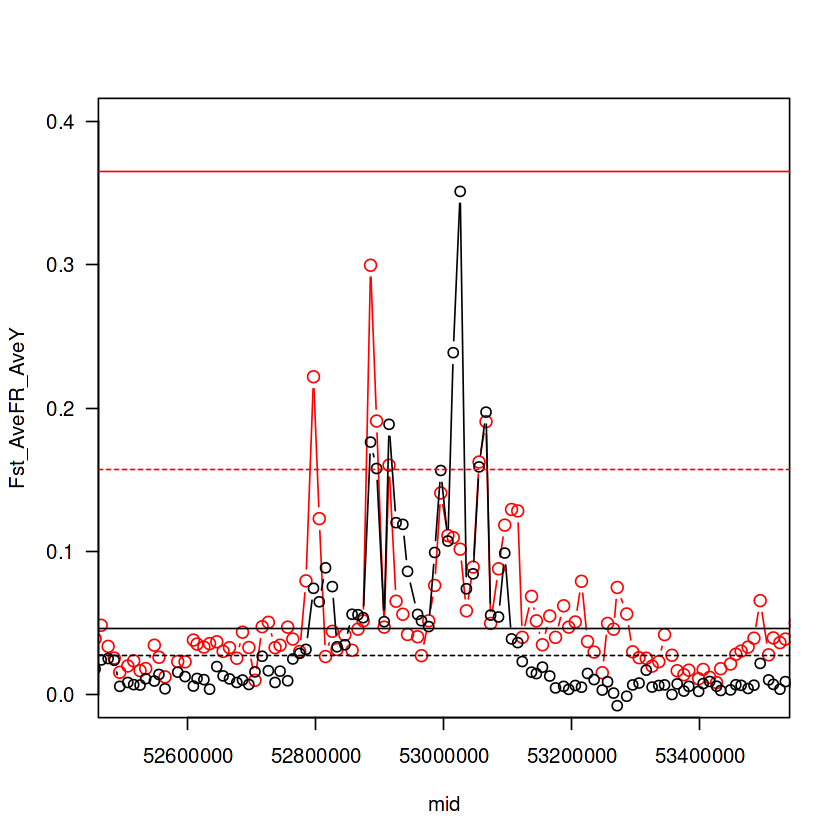

In [115]:
dat6 = dat[scaffold == 'Chr6']
xLim=c(52500000,53500000)
yLim=c(0,0.4)

plot(Fst_AveFR_AveY~mid, dat6, las = 1, xlim=xLim, ylim=yLim, col='red', type='b', cex=1.2)
lines(Fst_PlaFR_PlaY~mid, dat6, las = 1, xlim=xLim, ylim=yLim, col='black', type='b')

abline(h=0.0459, col='black') # 99 percentile
abline(h=0.0274, col='black', lty=2) # 95 percentile

abline(h=0.364837, col='red') # 99 percentile
abline(h=0.157095, col='red', lty=2) # 95 percentile

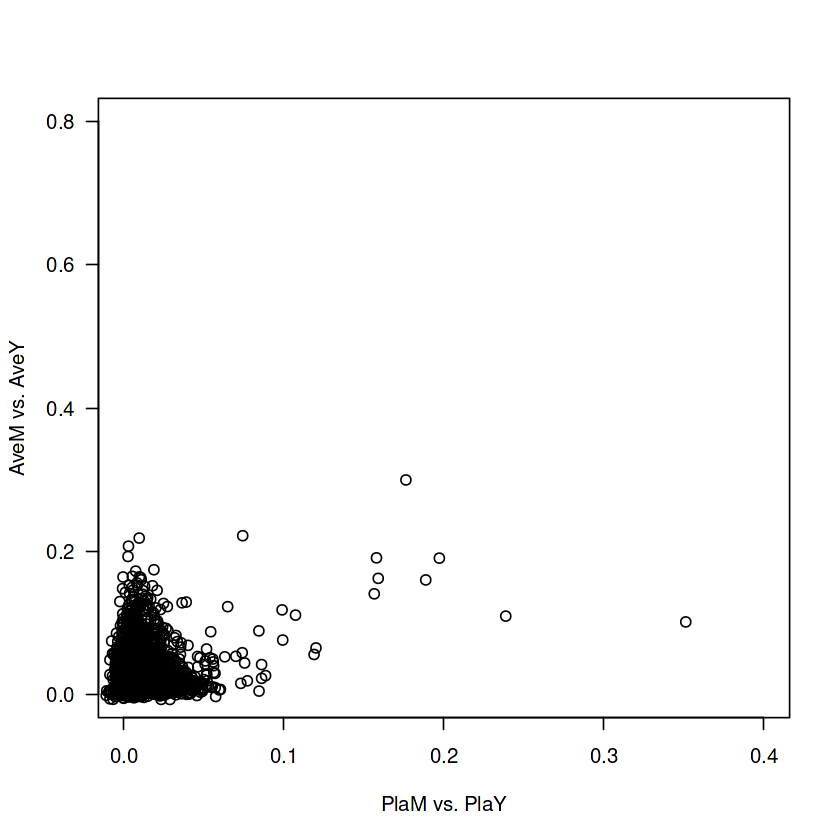

In [99]:
dat6 = dat[scaffold == 'Chr6']
plot(Fst_AveFR_AveY~Fst_PlaFR_PlaY, dat6, las = 1,
     xlab='PlaM vs. PlaY', ylab='AveM vs. AveY', 
     xlim=c(0,0.4), ylim=c(0,0.8))

## Sites Pi

In [51]:
## Functions -----
loess.smooth.weights = function(position, value, sites, span, family){
    y.loess <- loess(value ~ position, span = span, weights = sites, family=family)
    y.predict <- predict(y.loess, position)
    y.predict
}

In [52]:
sitePi_AveM = foreach(chrom=c(1:8), .combine=rbind) %do% {
                    file=paste0('./sitePi/Chr',chrom,'.AveM.sites.pi.gz')
                    dat = fread(file)
                    return(dat)
                }
sitePi_AveY = foreach(chrom=c(1:8), .combine=rbind) %do% {
                    file=paste0('./sitePi/Chr',chrom,'.AveY.sites.pi.gz')
                    dat = fread(file)
                    return(dat)
                }

In [53]:
sitePi_PlaM = foreach(chrom=c(1:8), .combine=rbind) %do% {
                    file=paste0('./sitePi/Chr',chrom,'.PlaM.sites.pi.gz')
                    dat = fread(file)
                    return(dat)
                }
sitePi_PlaY = foreach(chrom=c(1:8), .combine=rbind) %do% {
                    file=paste0('./sitePi/Chr',chrom,'.PlaY.sites.pi.gz')
                    dat = fread(file)
                    return(dat)
                }

In [5]:
# dat = sitePi_AveM
# dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
# sitePi_AveM = dat

In [6]:
# dat = sitePi_AveY
# dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
# sitePi_AveY = dat

In [7]:
# dat = sitePi_PlaM
# dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
# sitePi_PlaM = dat

In [8]:
# dat = sitePi_PlaY
# dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
# sitePi_PlaY = dat

In [54]:
str(sitePi_AveM)
str(sitePi_AveY)
str(sitePi_PlaM)
str(sitePi_PlaY)

Classes ‘data.table’ and 'data.frame':	11533030 obs. of  3 variables:
 $ CHROM: chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ POS  : int  4912 4932 4985 4997 4998 5010 5018 5270 5274 5278 ...
 $ PI   : num  0.512 0.501 0.512 0.512 0.512 ...
 - attr(*, ".internal.selfref")=<externalptr> 
Classes ‘data.table’ and 'data.frame':	11533030 obs. of  3 variables:
 $ CHROM: chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ POS  : int  4912 4932 4985 4997 4998 5010 5018 5270 5274 5278 ...
 $ PI   : num  0.501 0.501 0.501 0.501 0.501 ...
 - attr(*, ".internal.selfref")=<externalptr> 
Classes ‘data.table’ and 'data.frame':	11533030 obs. of  3 variables:
 $ CHROM: chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ POS  : int  4912 4932 4985 4997 4998 5010 5018 5270 5274 5278 ...
 $ PI   : num  0.5 0.5 0.5 0.5 0.5 ...
 - attr(*, ".internal.selfref")=<externalptr> 
Classes ‘data.table’ and 'data.frame':	11533030 obs. of  3 variables:
 $ CHROM: chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ POS  : int  4912 4932 4985 4997 4998 5010 50

### smooth

In [ ]:
## Smooth chr1
dat = sitePi_AveM[CHROM == 'Chr1']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr1_AveM = dat

dat = sitePi_AveY[CHROM == 'Chr1']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr1_AveY = dat

dat = sitePi_PlaM[CHROM == 'Chr1']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr1_PlaM = dat

dat = sitePi_PlaY[CHROM == 'Chr1']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr1_PlaY = dat

In [13]:
## Smooth chr2
dat = sitePi_AveM[CHROM == 'Chr2']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr2_AveM = dat

dat = sitePi_AveY[CHROM == 'Chr2']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr2_AveY = dat

dat = sitePi_PlaM[CHROM == 'Chr2']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr2_PlaM = dat

dat = sitePi_PlaY[CHROM == 'Chr2']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr2_PlaY = dat

In [18]:
## Smooth chr3
dat = sitePi_AveM[CHROM == 'Chr3']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr3_AveM = dat

dat = sitePi_AveY[CHROM == 'Chr3']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr3_AveY = dat

dat = sitePi_PlaM[CHROM == 'Chr3']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr3_PlaM = dat

dat = sitePi_PlaY[CHROM == 'Chr3']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr3_PlaY = dat

In [ ]:
## Smooth chr4
dat = sitePi_AveM[CHROM == 'Chr4']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr4_AveM = dat

dat = sitePi_AveY[CHROM == 'Chr4']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr4_AveY = dat

dat = sitePi_PlaM[CHROM == 'Chr4']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr4_PlaM = dat

dat = sitePi_PlaY[CHROM == 'Chr4']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr4_PlaY = dat

In [ ]:
## Smooth chr5
dat = sitePi_AveM[CHROM == 'Chr5']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr5_AveM = dat

dat = sitePi_AveY[CHROM == 'Chr5']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr5_AveY = dat

dat = sitePi_PlaM[CHROM == 'Chr5']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr5_PlaM = dat

dat = sitePi_PlaY[CHROM == 'Chr5']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr5_PlaY = dat

In [28]:
## Smooth chr6
dat = sitePi_AveM[CHROM == 'Chr6']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr6_AveM = dat

dat = sitePi_AveY[CHROM == 'Chr6']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr6_AveY = dat

dat = sitePi_PlaM[CHROM == 'Chr6']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr6_PlaM = dat

dat = sitePi_PlaY[CHROM == 'Chr6']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr6_PlaY = dat

In [33]:
## Smooth chr7
dat = sitePi_AveM[CHROM == 'Chr7']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr7_AveM = dat

dat = sitePi_AveY[CHROM == 'Chr7']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr7_AveY = dat

dat = sitePi_PlaM[CHROM == 'Chr7']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr7_PlaM = dat

dat = sitePi_PlaY[CHROM == 'Chr7']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr7_PlaY = dat

In [35]:
## Smooth chr8
dat = sitePi_AveM[CHROM == 'Chr8']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr8_AveM = dat

dat = sitePi_AveY[CHROM == 'Chr8']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr8_AveY = dat

dat = sitePi_PlaM[CHROM == 'Chr8']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr8_PlaM = dat

dat = sitePi_PlaY[CHROM == 'Chr8']
dat$PI.smooth = loess.smooth.weights(dat$POS, dat$PI, rep(1,nrow(dat)), span=0.005, "gaussian")
chr8_PlaY = dat

In [ ]:
### Write all the smooth datasets


### plots

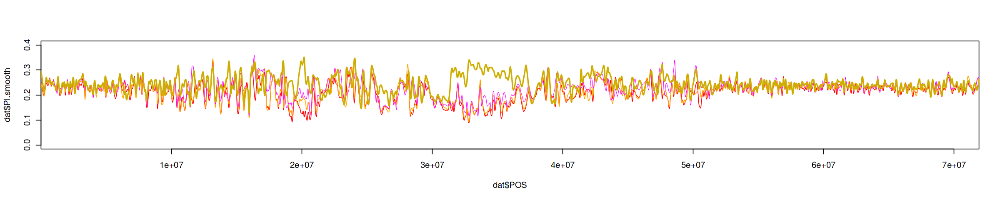

In [40]:
## Chr1
options(repr.plot.width=20, repr.plot.height=4)
par(xaxs='i', mfrow=c(1,1))

dat = chr1_PlaM
plot(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('red',1), type='l')

dat = chr1_PlaY
lines(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('orange',1))

dat = chr1_AveM
lines(dat$POS, dat$PI.smooth, lwd=0.7, ylim=c(0,0.4), col='magenta')

dat = chr1_AveY
lines(dat$POS, dat$PI.smooth, lwd=2, ylim=c(0,0.4), col=alpha('gold3',1))

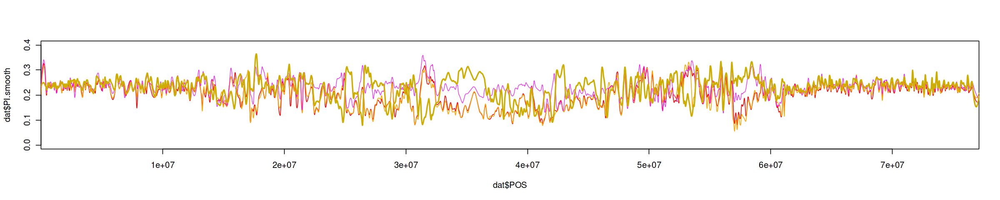

In [38]:
## Chr2
options(repr.plot.width=20, repr.plot.height=4)
par(xaxs='i', mfrow=c(1,1))

# dat = chr2_PlaM[POS>30000000 & POS<35000000]
dat = chr2_PlaM
plot(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('red',1), type='l')

# dat = chr2_PlaY[POS>30000000 & POS<35000000]
dat = chr2_PlaY
lines(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('orange',1))

# dat = chr2_AveM[POS>30000000 & POS<35000000]
dat = chr2_AveM
lines(dat$POS, dat$PI.smooth, lwd=0.7, ylim=c(0,0.4), col='magenta')

# dat = chr2_AveY[POS>30000000 & POS<35000000]
dat = chr2_AveY
lines(dat$POS, dat$PI.smooth, lwd=2, ylim=c(0,0.4), col=alpha('gold3',1))

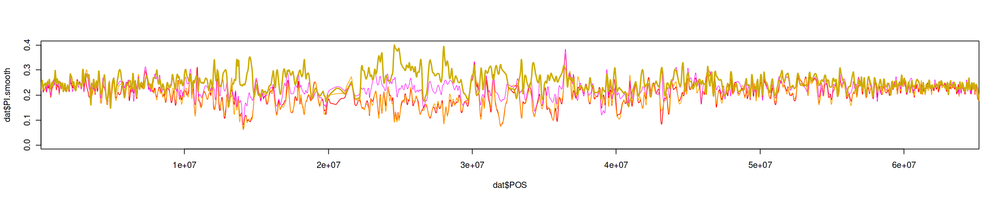

In [41]:
## Chr3
options(repr.plot.width=20, repr.plot.height=4)
par(xaxs='i', mfrow=c(1,1))

dat = chr3_PlaM; plot(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('red',1), type='l')
dat = chr3_PlaY; lines(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('orange',1))
dat = chr3_AveM; lines(dat$POS, dat$PI.smooth, lwd=0.7, ylim=c(0,0.4), col='magenta')
dat = chr3_AveY; lines(dat$POS, dat$PI.smooth, lwd=2, ylim=c(0,0.4), col=alpha('gold3',1))

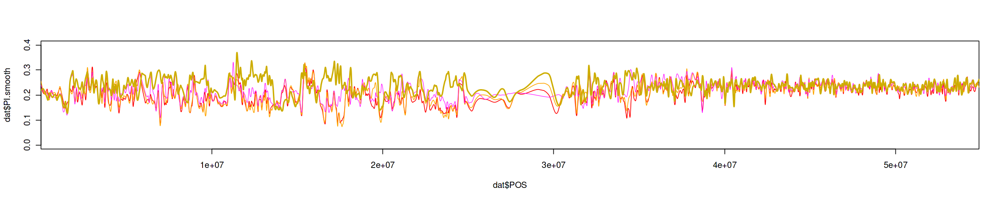

In [42]:
## Chr4
options(repr.plot.width=20, repr.plot.height=4)
par(xaxs='i', mfrow=c(1,1))

dat = chr4_PlaM; plot(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('red',1), type='l')
dat = chr4_PlaY; lines(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('orange',1))
dat = chr4_AveM; lines(dat$POS, dat$PI.smooth, lwd=0.7, ylim=c(0,0.4), col='magenta')
dat = chr4_AveY; lines(dat$POS, dat$PI.smooth, lwd=2, ylim=c(0,0.4), col=alpha('gold3',1))

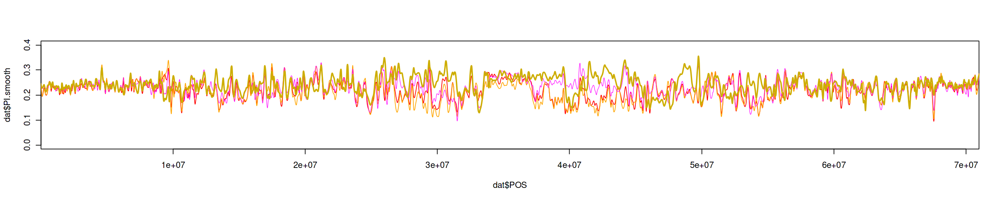

In [43]:
## Chr5
options(repr.plot.width=20, repr.plot.height=4)
par(xaxs='i', mfrow=c(1,1))

dat = chr5_PlaM; plot(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('red',1), type='l')
dat = chr5_PlaY; lines(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('orange',1))
dat = chr5_AveM; lines(dat$POS, dat$PI.smooth, lwd=0.7, ylim=c(0,0.4), col='magenta')
dat = chr5_AveY; lines(dat$POS, dat$PI.smooth, lwd=2, ylim=c(0,0.4), col=alpha('gold3',1))

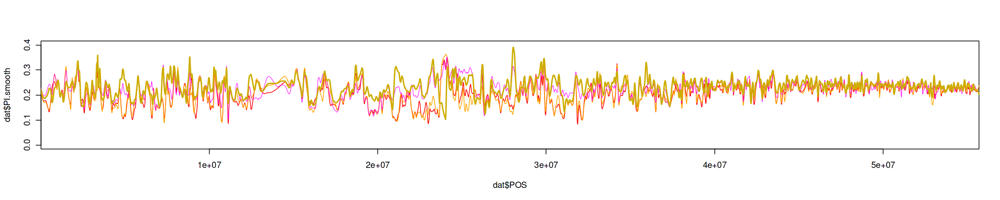

In [44]:
## Chr6
options(repr.plot.width=20, repr.plot.height=4)
par(xaxs='i', mfrow=c(1,1))

dat = chr6_PlaM; plot(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('red',1), type='l')
dat = chr6_PlaY; lines(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('orange',1))
dat = chr6_AveM; lines(dat$POS, dat$PI.smooth, lwd=0.7, ylim=c(0,0.4), col='magenta')
dat = chr6_AveY; lines(dat$POS, dat$PI.smooth, lwd=2, ylim=c(0,0.4), col=alpha('gold3',1))

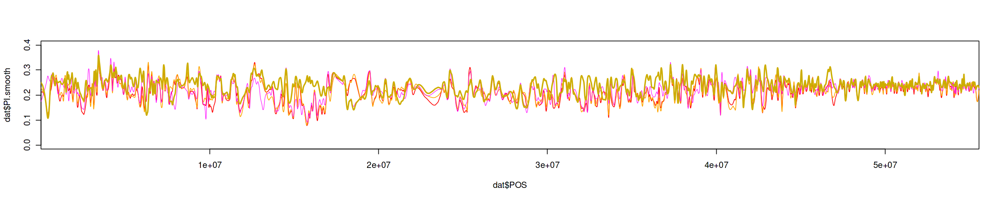

In [45]:
## Chr7
options(repr.plot.width=20, repr.plot.height=4)
par(xaxs='i', mfrow=c(1,1))

dat = chr7_PlaM; plot(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('red',1), type='l')
dat = chr7_PlaY; lines(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('orange',1))
dat = chr7_AveM; lines(dat$POS, dat$PI.smooth, lwd=0.7, ylim=c(0,0.4), col='magenta')
dat = chr7_AveY; lines(dat$POS, dat$PI.smooth, lwd=2, ylim=c(0,0.4), col=alpha('gold3',1))

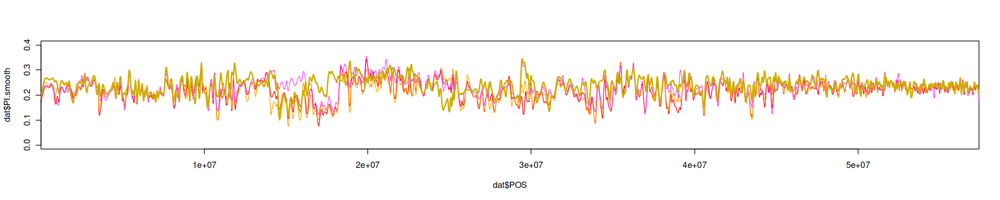

In [46]:
## Chr8
options(repr.plot.width=20, repr.plot.height=4)
par(xaxs='i', mfrow=c(1,1))

dat = chr8_PlaM; plot(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('red',1), type='l')
dat = chr8_PlaY; lines(dat$POS, dat$PI.smooth, cex=0.7, ylim=c(0,0.4), col=alpha('orange',1))
dat = chr8_AveM; lines(dat$POS, dat$PI.smooth, lwd=0.7, ylim=c(0,0.4), col='magenta')
dat = chr8_AveY; lines(dat$POS, dat$PI.smooth, lwd=2, ylim=c(0,0.4), col=alpha('gold3',1))

## Fst vs Pi

In [69]:
str(AvePlaFRYe_w10KBs10KB)

Classes ‘data.table’ and 'data.frame':	50881 obs. of  24 variables:
 $ windowID       : int  1 2 3 4 5 6 7 8 9 10 ...
 $ scaffold       : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ start          : int  1 10001 20001 30001 40001 50001 60001 70001 80001 90001 ...
 $ end            : int  10000 20000 30000 40000 50000 60000 70000 80000 90000 100000 ...
 $ mid            : num  7311 15387 24812 31845 NaN ...
 $ sites          : int  118 126 227 53 0 20 209 199 219 152 ...
 $ pi_AveFR       : num  0.278 0.233 0.228 0.257 NaN ...
 $ pi_AveY        : num  0.324 0.23 0.221 0.278 NaN ...
 $ pi_PlaFR       : num  0.287 0.202 0.22 0.225 NaN ...
 $ pi_PlaY        : num  0.28 0.234 0.252 0.192 NaN ...
 $ dxy_AveFR_AveY : num  0.309 0.236 0.234 0.274 NaN ...
 $ dxy_AveFR_PlaFR: num  0.281 0.224 0.227 0.244 NaN ...
 $ dxy_AveFR_PlaY : num  0.281 0.238 0.247 0.242 NaN ...
 $ dxy_AveY_PlaFR : num  0.313 0.233 0.232 0.259 NaN ...
 $ dxy_AveY_PlaY  : num  0.315 0.248 0.257 0.252 NaN ...
 $ dxy_PlaFR_PlaY :

In [70]:
str(sitePi_AveM)

ERROR: Error in eval(expr, envir, enclos): object 'sitePi_AveM' not found


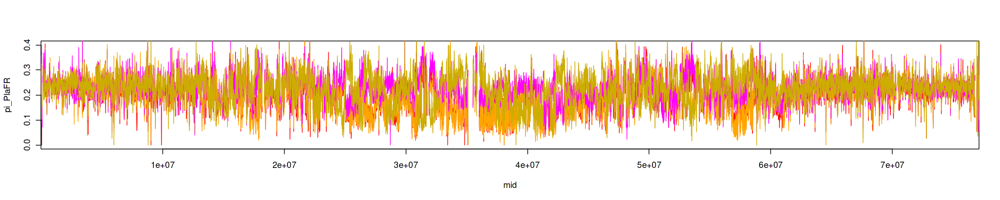

In [51]:
## Chr2
options(repr.plot.width=20, repr.plot.height=4)
par(xaxs='i', mfrow=c(1,1))

# dat = chr2_PlaM[POS>30000000 & POS<35000000]
dat = AvePlaFRYe_w10KBs10KB[scaffold == 'Chr2']

plot(pi_PlaFR~mid, dat, cex=0.7, ylim=c(0,0.4), col=alpha('red',1), type='l')
lines(pi_PlaY~mid, dat, cex=0.7, ylim=c(0,0.4), col=alpha('orange',1))
lines(pi_AveFR~mid, dat, cex=0.7, ylim=c(0,0.4), col=alpha('magenta',1))
lines(pi_AveY~mid, dat, cex=0.7, ylim=c(0,0.4), col=alpha('gold3',1))

In [56]:
dat = AvePlaFRYe_w10KBs10KB[scaffold == 'Chr2']
dat$pi_PlaFR_smooth = loess.smooth.weights(dat$mid, dat$pi_PlaFR, dat$sites, span=0.005, "gaussian")
dat$pi_PlaY_smooth = loess.smooth.weights(dat$mid, dat$pi_PlaY, dat$sites, span=0.005, "gaussian")
dat$pi_AveFR_smooth = loess.smooth.weights(dat$mid, dat$pi_AveFR, dat$sites, span=0.005, "gaussian")
dat$pi_AveY_smooth = loess.smooth.weights(dat$mid, dat$pi_AveY, dat$sites, span=0.005, "gaussian")

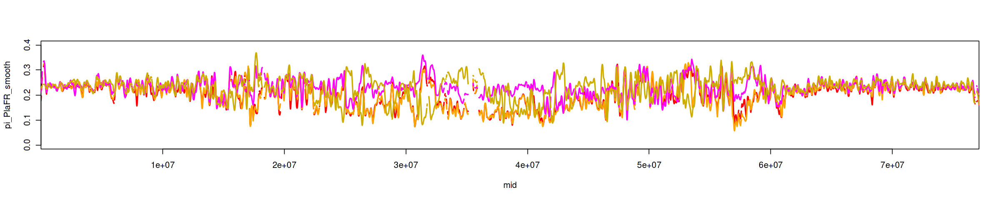

In [59]:
par(xaxs = 'i')
plot(pi_PlaFR_smooth~mid, dat, lwd=2, ylim=c(0,0.4), col=alpha('red',1), type='l')
lines(pi_PlaY_smooth~mid, dat, lwd=2, ylim=c(0,0.4), col=alpha('orange',1))
lines(pi_AveFR_smooth~mid, dat, lwd=2, ylim=c(0,0.4), col=alpha('magenta',1))
lines(pi_AveY_smooth~mid, dat, lwd=2, ylim=c(0,0.4), col=alpha('gold3',1))

In [89]:
str(dat)

Classes ‘data.table’ and 'data.frame':	7712 obs. of  22 variables:
 $ windowID       : int  1 2 3 4 5 6 7 8 9 10 ...
 $ scaffold       : chr  "Chr2" "Chr2" "Chr2" "Chr2" ...
 $ start          : int  1 10001 20001 30001 40001 50001 60001 70001 80001 90001 ...
 $ end            : int  10000 20000 30000 40000 50000 60000 70000 80000 90000 100000 ...
 $ mid            : num  5118 16245 22731 NaN 47402 ...
 $ sites          : int  24 24 65 0 25 43 1 44 92 27 ...
 $ pi_AveFR       : num  0.282 0.359 0.207 NaN 0.398 ...
 $ pi_AveY        : num  0.264 0.305 0.203 NaN 0.324 ...
 $ pi_PlaFR       : num  0.276 0.21 0.182 NaN 0.371 ...
 $ pi_PlaY        : num  0.239 0.304 0.202 NaN 0.3 ...
 $ dxy_AveFR_AveY : num  0.277 0.336 0.205 NaN 0.374 ...
 $ dxy_AveFR_PlaFR: num  0.288 0.315 0.196 NaN 0.391 ...
 $ dxy_AveFR_PlaY : num  0.263 0.332 0.205 NaN 0.384 ...
 $ dxy_AveY_PlaFR : num  0.276 0.273 0.195 NaN 0.411 ...
 $ dxy_AveY_PlaY  : num  0.265 0.304 0.207 NaN 0.311 ...
 $ dxy_PlaFR_PlaY : num  0.2

### big correlation plot for pi and Fst

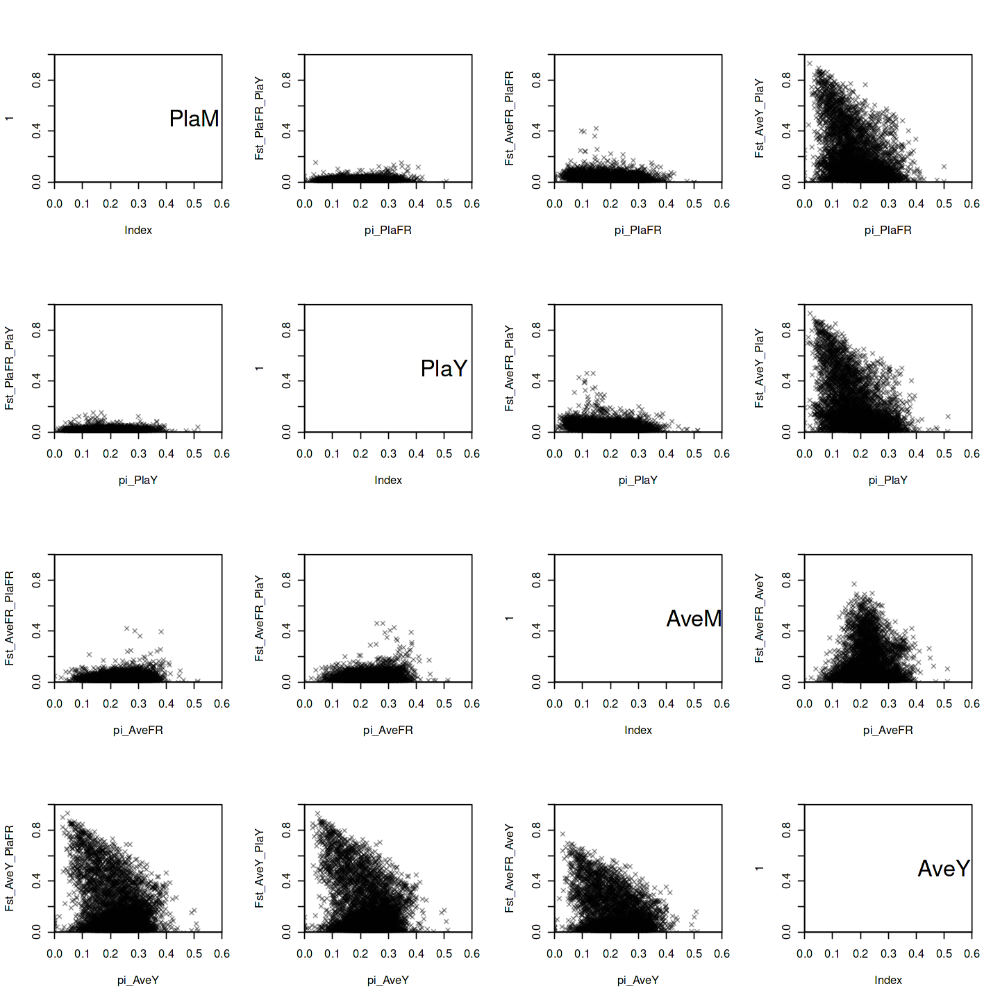

In [55]:
options(repr.plot.width=12, repr.plot.height=12)
dat = AvePlaFRYe_w10KBs10KB[scaffold == 'Chr2']
# str(dat)
xLimit=c(0,0.6)
yLimit=c(0,1)

par(mfrow=c(4,4), xaxs='i', yaxs='i', cex=0.8)

## PlaM; PlaY; AveM; AveY

## PlaM
plot(1, type='n', xlim=xLimit, ylim=yLimit); text(0.5,0.5,'PlaM', cex=2)
plot(Fst_PlaFR_PlaY~pi_PlaFR, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(Fst_AveFR_PlaFR~pi_PlaFR, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(Fst_AveY_PlaY~pi_PlaFR, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)

## PlaY
plot(Fst_PlaFR_PlaY~pi_PlaY, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(1, type='n', xlim=xLimit, ylim=yLimit); text(0.5,0.5,'PlaY', cex=2)
plot(Fst_AveFR_PlaY~pi_PlaY, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(Fst_AveY_PlaY~pi_PlaY, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)

## AveM
plot(Fst_AveFR_PlaFR~pi_AveFR, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(Fst_AveFR_PlaY~pi_AveFR, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(1, type='n', xlim=xLimit, ylim=yLimit); text(0.5,0.5,'AveM', cex=2)
plot(Fst_AveFR_AveY~pi_AveFR, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)

## AveY
plot(Fst_AveY_PlaFR~pi_AveY, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(Fst_AveY_PlaY~pi_AveY, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(Fst_AveFR_AveY~pi_AveY, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(1, type='n', xlim=xLimit, ylim=yLimit); text(0.5,0.5,'AveY', cex=2)

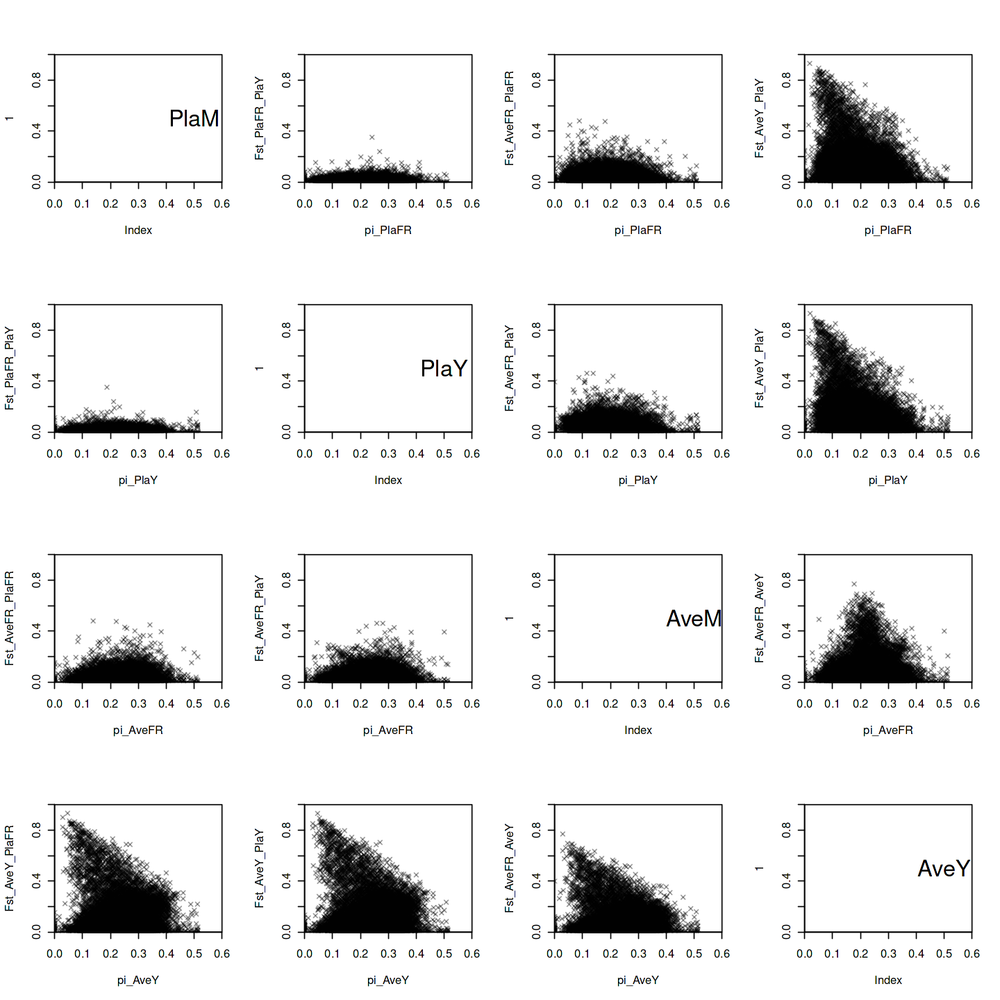

In [56]:
options(repr.plot.width=12, repr.plot.height=12)
dat = AvePlaFRYe_w10KBs10KB
# str(dat)
xLimit=c(0,0.6)
yLimit=c(0,1)

par(mfrow=c(4,4), xaxs='i', yaxs='i', cex=0.8)

## PlaM; PlaY; AveM; AveY

## PlaM
plot(1, type='n', xlim=xLimit, ylim=yLimit); text(0.5,0.5,'PlaM', cex=2)
plot(Fst_PlaFR_PlaY~pi_PlaFR, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(Fst_AveFR_PlaFR~pi_PlaFR, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(Fst_AveY_PlaY~pi_PlaFR, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)

## PlaY
plot(Fst_PlaFR_PlaY~pi_PlaY, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(1, type='n', xlim=xLimit, ylim=yLimit); text(0.5,0.5,'PlaY', cex=2)
plot(Fst_AveFR_PlaY~pi_PlaY, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(Fst_AveY_PlaY~pi_PlaY, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)

## AveM
plot(Fst_AveFR_PlaFR~pi_AveFR, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(Fst_AveFR_PlaY~pi_AveFR, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(1, type='n', xlim=xLimit, ylim=yLimit); text(0.5,0.5,'AveM', cex=2)
plot(Fst_AveFR_AveY~pi_AveFR, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)

## AveY
plot(Fst_AveY_PlaFR~pi_AveY, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(Fst_AveY_PlaY~pi_AveY, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(Fst_AveFR_AveY~pi_AveY, dat, cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit)
plot(1, type='n', xlim=xLimit, ylim=yLimit); text(0.5,0.5,'AveY', cex=2)

### final plot

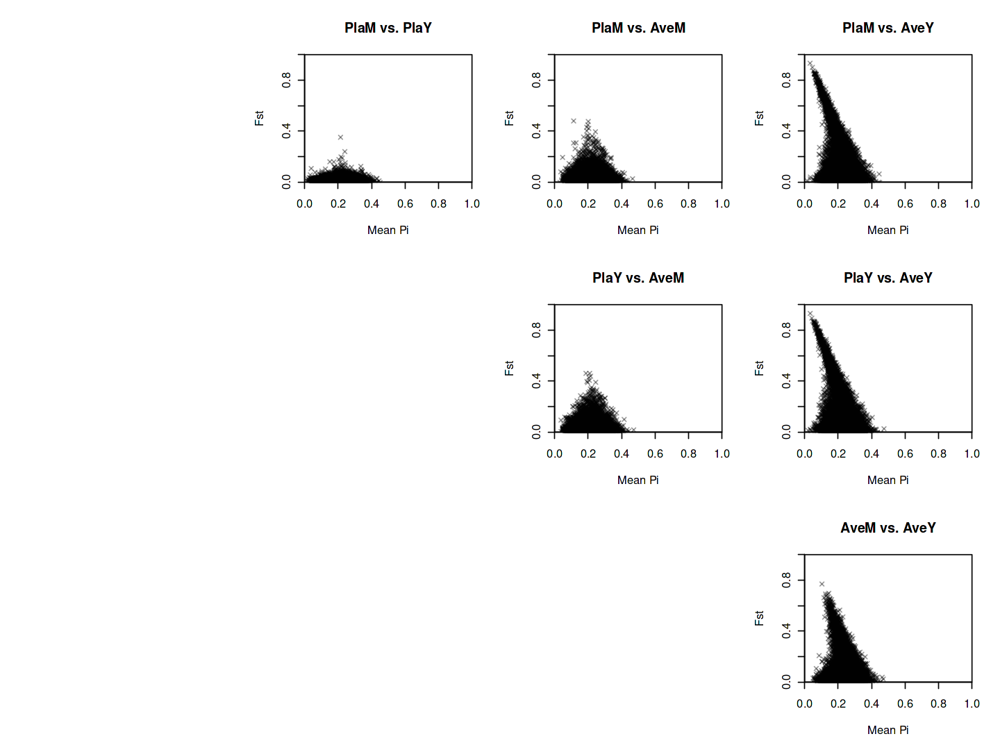

In [57]:
options(repr.plot.width=12, repr.plot.height=9)
dat = AvePlaFRYe_w10KBs10KB[sites>=20]
xLimit=c(0,1)
yLimit=c(0,1)
xLab="Mean Pi"
yLab="Fst"
par(mfrow=c(3,4), xaxs='i', yaxs='i', cex=0.8)

## PlaM vs. xxxx
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i")
plot((dat$pi_PlaFR+dat$pi_PlaY)/2, dat$Fst_PlaFR_PlaY, main='PlaM vs. PlaY', cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit, xlab=xLab, ylab=yLab)
plot((dat$pi_AveFR+dat$pi_PlaFR)/2, dat$Fst_AveFR_PlaFR, main='PlaM vs. AveM', cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit, xlab=xLab, ylab=yLab)
plot((dat$pi_AveY+dat$pi_PlaFR)/2, dat$Fst_AveY_PlaFR, main='PlaM vs. AveY', cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit, xlab=xLab, ylab=yLab)


## PlaY vs. xxxx
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i")
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i")
plot((dat$pi_AveFR+dat$pi_PlaY)/2, dat$Fst_AveFR_PlaY, main='PlaY vs. AveM', cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit, xlab=xLab, ylab=yLab)
plot((dat$pi_AveY+dat$pi_PlaY)/2, dat$Fst_AveY_PlaY, main='PlaY vs. AveY', cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit, xlab=xLab, ylab=yLab)


## AveM vs. xxxx
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs 
     = "i", yaxs = "i")
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i")
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i")
plot((dat$pi_AveFR+dat$pi_AveY)/2, dat$Fst_AveFR_AveY, main='AveM vs. AveY', cex=0.8, pch=4, col=alpha('black',0.4), xlim=xLimit, ylim=yLimit, xlab=xLab, ylab=yLab)

## Fst vs recombination rate

In [11]:
## Read recRate 
rec_AveM = foreach(chrom=c(1:8), .combine=rbind) %do% {
    file=paste0('~/snap_hap_repHZ/recRate_bySnps/Chr',chrom,'/AveM/chr',chrom,'_AveM_recRate_w10Ks10K.txt')
    dat = fread(file)
    return(dat)
}

rec_AveY = foreach(chrom=c(1:8), .combine=rbind) %do% {
    file=paste0('~/snap_hap_repHZ/recRate_bySnps/Chr',chrom,'/AveY/chr',chrom,'_AveY_recRate_w10Ks10K.txt')
    dat = fread(file)
    return(dat)
}

rec_PlaM = foreach(chrom=c(1:8), .combine=rbind) %do% {
    file=paste0('~/snap_hap_repHZ/recRate_bySnps/Chr',chrom,'/PlaM/chr',chrom,'_PlaM_recRate_w10Ks10K.txt')
    dat = fread(file)
    return(dat)
}

rec_PlaY = foreach(chrom=c(1:8), .combine=rbind) %do% {
    file=paste0('~/snap_hap_repHZ/recRate_bySnps/Chr',chrom,'/PlaY/chr',chrom,'_PlaY_recRate_w10Ks10K.txt')
    dat = fread(file)
    return(dat)
}

In [12]:
## Add chrom_start_end coloum
AvePlaFRYe_w10KBs10KB = AvePlaFRYe_w10KBs10KB %>% mutate(chrom_start_end = paste(scaffold, start, end, sep='_')) 
str(AvePlaFRYe_w10KBs10KB)

Classes ‘data.table’ and 'data.frame':	50881 obs. of  25 variables:
 $ windowID       : int  1 2 3 4 5 6 7 8 9 10 ...
 $ scaffold       : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ start          : int  1 10001 20001 30001 40001 50001 60001 70001 80001 90001 ...
 $ end            : int  10000 20000 30000 40000 50000 60000 70000 80000 90000 100000 ...
 $ mid            : num  7311 15387 24812 31845 NaN ...
 $ sites          : int  118 126 227 53 0 20 209 199 219 152 ...
 $ pi_AveFR       : num  0.278 0.233 0.228 0.257 NaN ...
 $ pi_AveY        : num  0.324 0.23 0.221 0.278 NaN ...
 $ pi_PlaFR       : num  0.287 0.202 0.22 0.225 NaN ...
 $ pi_PlaY        : num  0.28 0.234 0.252 0.192 NaN ...
 $ dxy_AveFR_AveY : num  0.309 0.236 0.234 0.274 NaN ...
 $ dxy_AveFR_PlaFR: num  0.281 0.224 0.227 0.244 NaN ...
 $ dxy_AveFR_PlaY : num  0.281 0.238 0.247 0.242 NaN ...
 $ dxy_AveY_PlaFR : num  0.313 0.233 0.232 0.259 NaN ...
 $ dxy_AveY_PlaY  : num  0.315 0.248 0.257 0.252 NaN ...
 $ dxy_PlaFR_PlaY :

In [13]:
## Add chrom_start_end coloum
# str(rec_PlaY)
commonCols = c('chrom', 'windowStart', 'windowEnd', 'windowMid', 'sites')
recRate = cbind(rec_PlaY[,..commonCols], rec_PlaM[,3], rec_PlaY[,3], rec_AveM[,3], rec_AveY[,3])
colnames(recRate) = c('chrom', 'windowStart', 'windowEnd', 'windowMid', 'rec_sites', 'rec_PlaM', 'rec_PlaY', 'rec_AveM', 'rec_AveY')
recRate = recRate %>% mutate(chrom_start_end = paste(chrom, windowStart, windowEnd, sep='_')) 
str(recRate)

Classes ‘data.table’ and 'data.frame':	49096 obs. of  10 variables:
 $ chrom          : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ windowStart    : int  1 10001 20001 30001 50001 60001 70001 80001 90001 100001 ...
 $ windowEnd      : int  10000 20000 30000 40000 60000 70000 80000 90000 100000 110000 ...
 $ windowMid      : num  5000 15000 25000 35000 55000 ...
 $ rec_sites      : int  118 126 227 53 20 209 199 219 152 139 ...
 $ rec_PlaM       : num  42.8 35.9 67.4 54.7 4.4 ...
 $ rec_PlaY       : num  46.54 48.92 42 29.21 6.34 ...
 $ rec_AveM       : num  60.5 55.2 57.1 29.5 9 ...
 $ rec_AveY       : num  20.41 19.81 35.47 10.65 1.98 ...
 $ chrom_start_end: chr  "Chr1_1_10000" "Chr1_10001_20000" "Chr1_20001_30000" "Chr1_30001_40000" ...
 - attr(*, ".internal.selfref")=<externalptr> 


In [14]:
## Combine the 2 datasets
combinedDat = merge(recRate, AvePlaFRYe_w10KBs10KB, by='chrom_start_end')
str(combinedDat)

Classes ‘data.table’ and 'data.frame':	49096 obs. of  34 variables:
 $ chrom_start_end: chr  "Chr1_10000001_10010000" "Chr1_1000001_1010000" "Chr1_100001_110000" "Chr1_10001_20000" ...
 $ chrom          : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ windowStart    : int  10000001 1000001 100001 10001 10010001 10020001 10030001 10040001 10050001 10060001 ...
 $ windowEnd      : int  10010000 1010000 110000 20000 10020000 10030000 10040000 10050000 10060000 10070000 ...
 $ windowMid      : num  10005000 1005000 105000 15000 10015000 ...
 $ rec_sites      : int  243 607 139 126 253 419 328 106 267 335 ...
 $ rec_PlaM       : num  20.6 53 28.4 35.9 10.9 ...
 $ rec_PlaY       : num  22.5 66.7 19.4 48.9 36.4 ...
 $ rec_AveM       : num  61.2 53.2 13.3 55.2 19.6 ...
 $ rec_AveY       : num  25.5 51.6 22.3 19.8 14.7 ...
 $ windowID       : int  1001 101 11 2 1002 1003 1004 1005 1006 1007 ...
 $ scaffold       : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ start          : int  10000001 1000001 100001 10

In [15]:
dat = combinedDat[sites >= 20]
summary(dat)

 chrom_start_end       chrom            windowStart         windowEnd       
 Length:47375       Length:47375       Min.   :       1   Min.   :   10000  
 Class :character   Class :character   1st Qu.:15820001   1st Qu.:15830000  
 Mode  :character   Mode  :character   Median :32310001   Median :32320000  
                                       Mean   :32548532   Mean   :32558531  
                                       3rd Qu.:48135001   3rd Qu.:48145000  
                                       Max.   :77060001   Max.   :77070000  
   windowMid          rec_sites         rec_PlaM            rec_PlaY        
 Min.   :    5000   Min.   :  20.0   Min.   :  0.00738   Min.   :  0.01004  
 1st Qu.:15825000   1st Qu.: 139.0   1st Qu.: 18.46613   1st Qu.: 19.03549  
 Median :32315000   Median : 223.0   Median : 30.73368   Median : 32.33054  
 Mean   :32553531   Mean   : 243.1   Mean   : 34.39424   Mean   : 36.10390  
 3rd Qu.:48140000   3rd Qu.: 324.0   3rd Qu.: 46.54817   3rd Qu.: 49.05809  

In [16]:
str(dat)

Classes ‘data.table’ and 'data.frame':	47375 obs. of  34 variables:
 $ chrom_start_end: chr  "Chr1_10000001_10010000" "Chr1_1000001_1010000" "Chr1_100001_110000" "Chr1_10001_20000" ...
 $ chrom          : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ windowStart    : int  10000001 1000001 100001 10001 10010001 10020001 10030001 10040001 10050001 10060001 ...
 $ windowEnd      : int  10010000 1010000 110000 20000 10020000 10030000 10040000 10050000 10060000 10070000 ...
 $ windowMid      : num  10005000 1005000 105000 15000 10015000 ...
 $ rec_sites      : int  243 607 139 126 253 419 328 106 267 335 ...
 $ rec_PlaM       : num  20.6 53 28.4 35.9 10.9 ...
 $ rec_PlaY       : num  22.5 66.7 19.4 48.9 36.4 ...
 $ rec_AveM       : num  61.2 53.2 13.3 55.2 19.6 ...
 $ rec_AveY       : num  25.5 51.6 22.3 19.8 14.7 ...
 $ windowID       : int  1001 101 11 2 1002 1003 1004 1005 1006 1007 ...
 $ scaffold       : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ start          : int  10000001 1000001 100001 10

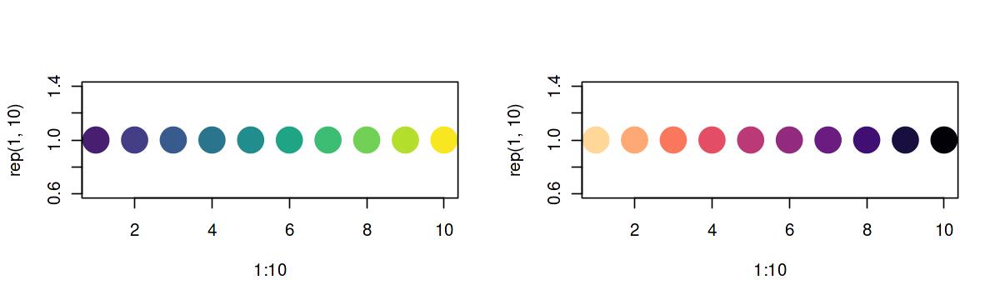

In [17]:
options(repr.plot.width=10, repr.plot.height=3)

par(mfrow=c(1,2))

# viridis
color_palette = viridis(100, option = 'viridis', direction = 1) # Define the color palette
Fst_max = 10; scale = Fst_max/100; z_scaled = pmax(pmin(c(1:10) %/% scale, 100), 1)
point_colors <- color_palette[z_scaled]
plot(1:10, rep(1,10), col=point_colors, pch=20, cex=5)

# magma
color_palette = viridis(100, option = 'magma', direction = -1) # Define the color palette
Fst_max = 10; scale = Fst_max/100; z_scaled = pmax(pmin(c(1:10) %/% scale, 100), 1)
point_colors <- color_palette[z_scaled]
plot(1:10, rep(1,10), col=point_colors, pch=20, cex=5)

In [18]:
plot_Fst_correlations = function(xValues, yValues, colorValues, coloring, xLimit, yLimit, xaxisText, yaxisText, yaxisSide){
    
    dataToPlot = data.frame(xValues, yValues, colorValues)
    dataToPlot = dataToPlot %>% arrange(colorValues)
    
    if (coloring == 'dxy'){
        color_palette = viridis(100, option = 'magma', direction = -1) # Define the color palette    
        dxy_max = 1
        scale = dxy_max/100
        z_scaled = dataToPlot$colorValues %/% scale
        z_scaled = pmax(pmin(z_scaled, 100), 1)
    } else if (coloring == 'pi') { 
        color_palette = viridis(100, option = 'viridis', direction = +1) # Define the color palette
        pi_max = 0.3
        scale = pi_max/100 
        z_scaled = dataToPlot$colorValues %/% scale                
        z_scaled = pmax(pmin(z_scaled, 100), 1)
    }
    # as.numeric(cut(colorValues, breaks = 100)) # Scale `z` to 100 levels
    point_colors <- color_palette[z_scaled] # Map scaled values to colors
    
    plot(yValues~xValues, dataToPlot, col=alpha(point_colors, 0.6), 
         xlim=xLimit, ylim=yLimit, xaxs='i', yaxs='i',
         main='', xlab='', ylab='', 
         axes=F, frame.plot=T,
         cex=1.2, pch=20
        )

    axis(1, at = seq(xLimit[1],xLimit[2],diff(xLimit)/5), labels = ifelse(xaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5)
    # axis(yaxisSide, at = seq(yLimit[1],yLimit[2],diff(yLimit)/5), labels = ifelse(yaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = 0.8, las = 1)
    axis(2, at = seq(yLimit[1],yLimit[2],diff(yLimit)/5), labels = ifelse(yaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5)
    # axis(3, at = seq(xLimit[1],xLimit[2],diff(xLimit)/5), labels = ifelse(xaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = -0.8)
    # axis(4, at = seq(yLimit[1],yLimit[2],diff(yLimit)/5), labels = ifelse(yaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = -0.8)
}

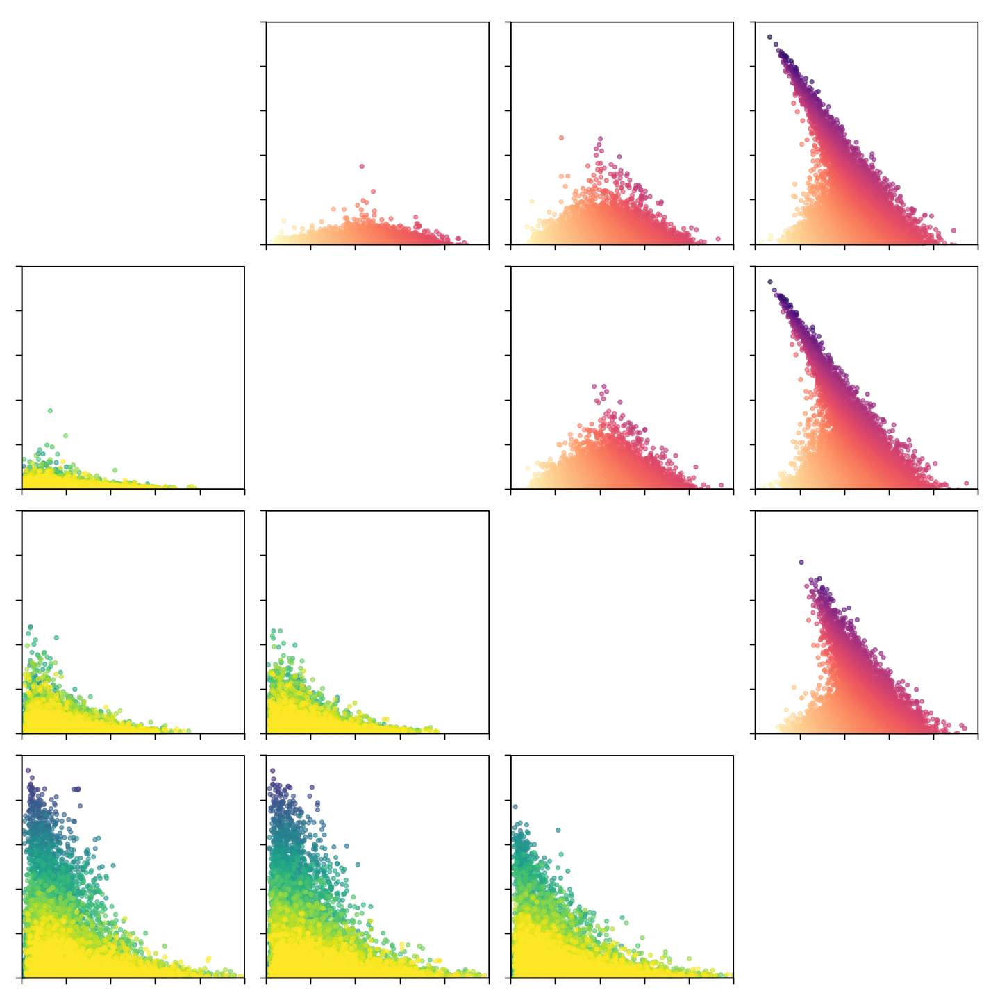

In [19]:
options(repr.plot.width=12, repr.plot.height=12)
par(mfrow=c(4,4), mar = c(1, 1, 1, 1), oma = c(1, 1, 1, 1))

## PlaM vs. xxxx
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");
# color_min = 0; color_max = 1
# color_legend = seq(color_min, color_max, length.out = 100)
# image(1, color_legend, t(matrix(color_legend, ncol = 1)), col = viridis(100, option = 'viridis', direction = 1), xaxt = "n", yaxt = "n", xlab='', ylab='')
plot_Fst_correlations((dat$pi_PlaFR+dat$pi_PlaY)/2, dat$Fst_PlaFR_PlaY, dat$dxy_PlaFR_PlaY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('PlaM', side = 2, line = 2, cex = 1.5)
    # mtext('PlaY', side = 3, line = 2, cex = 1.5)
plot_Fst_correlations((dat$pi_AveFR+dat$pi_PlaFR)/2, dat$Fst_AveFR_PlaFR, dat$dxy_AveFR_PlaFR, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('AveM', side = 3, line = 2, cex = 1.5)
plot_Fst_correlations((dat$pi_AveY+dat$pi_PlaFR)/2, dat$Fst_AveY_PlaFR, dat$dxy_AveY_PlaFR, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('AveY', side = 3, line = 2, cex = 1.5)


## PlaY vs. xxxx
plot_Fst_correlations((dat$rec_PlaY+dat$rec_PlaM)/2, dat$Fst_PlaFR_PlaY, (dat$pi_PlaFR+dat$pi_PlaY)/2, 'pi', xLimit = c(0,200), yLimit = c(0,1), F, F, 2); 
    # mtext('PlaY', side = 2, line = 4, cex = 1.5)
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");
plot_Fst_correlations((dat$pi_AveFR+dat$pi_PlaY)/2, dat$Fst_AveFR_PlaY, dat$dxy_AveFR_PlaY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('PlaY', side = 2, line = 2, cex = 1.5)
plot_Fst_correlations((dat$pi_AveY+dat$pi_PlaY)/2, dat$Fst_AveY_PlaY, dat$dxy_AveY_PlaY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 


## AveM vs. xxxx
plot_Fst_correlations((dat$rec_AveM+dat$rec_PlaM)/2, dat$Fst_AveFR_PlaFR, (dat$pi_AveFR+dat$pi_PlaFR)/2, 'pi', xLimit = c(0,200), yLimit = c(0,1), F, F, 2); 
    # mtext('AveM', side = 2, line = 4, cex = 1.5)
plot_Fst_correlations((dat$rec_AveM+dat$rec_PlaY)/2, dat$Fst_AveFR_PlaY, (dat$pi_AveFR+dat$pi_PlaY)/2, 'pi', xLimit = c(0,200), yLimit = c(0,1), F, F, 2); 
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");
plot_Fst_correlations((dat$pi_AveFR+dat$pi_AveY)/2, dat$Fst_AveFR_AveY, dat$dxy_AveFR_AveY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('AveM', side = 2, line = 2, cex = 1.5)


## AveY vs. xxxx
plot_Fst_correlations((dat$rec_AveY+dat$rec_PlaM)/2, dat$Fst_AveY_PlaFR, (dat$pi_AveY+dat$pi_PlaFR)/2, 'pi', xLimit = c(0,150), yLimit = c(0,1), F, F, 2); 
    # mtext('AveY', side = 2, line = 2, cex = 1.5)
plot_Fst_correlations((dat$rec_AveY+dat$rec_PlaY)/2, dat$Fst_AveY_PlaY, (dat$pi_AveY+dat$pi_PlaY)/2, 'pi', xLimit = c(0,150), yLimit = c(0,1), F, F, 2); 
plot_Fst_correlations((dat$rec_AveY+dat$rec_AveM)/2, dat$Fst_AveFR_AveY, (dat$pi_AveFR+dat$pi_AveY)/2, 'pi', xLimit = c(0,150), yLimit = c(0,1), F, F, 2); 
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");
# color_min = 0; color_max = 1
# color_legend = seq(color_min, color_max, length.out = 100)
# image(1, color_legend, t(matrix(color_legend, ncol = 1)), col = viridis(100, option = 'magma', direction = -1), xaxt = "n", yaxt = "n", xlab='', ylab='')

# mtext("Fst", side = 2, outer = TRUE, line = 2.5, cex = 1.2)
# mtext("Fst", side = 4, outer = TRUE, line = 2.5, cex = 1.2)

In [1122]:
## Save plot
# svg("./_figures/plot_fst_correlations.svg", width = 16, height = 16)
# pdf("./_figures/plot_fst_correlations.pdf", width = 16, height = 16, compress=T)
# jpeg("./_figures/plot_fst_correlations.jpg", width = 16, height=16, units='in', pointsize=12, res=4000)
tiff("./_figures/plot_fst_correlations.tiff", units='in', width=12, height=12, res=400)

###
# options(repr.plot.width=12, repr.plot.height=12)
par(mfrow=c(4,4), mar = c(1, 1, 1, 1), oma = c(1, 1, 1, 1))

## PlaM vs. xxxx
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");
# color_min = 0; color_max = 1
# color_legend = seq(color_min, color_max, length.out = 100)
# image(1, color_legend, t(matrix(color_legend, ncol = 1)), col = viridis(100, option = 'viridis', direction = 1), xaxt = "n", yaxt = "n", xlab='', ylab='')
plot_Fst_correlations((dat$pi_PlaFR+dat$pi_PlaY)/2, dat$Fst_PlaFR_PlaY, dat$dxy_PlaFR_PlaY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('PlaM', side = 2, line = 2, cex = 1.5)
    # mtext('PlaY', side = 3, line = 2, cex = 1.5)
plot_Fst_correlations((dat$pi_AveFR+dat$pi_PlaFR)/2, dat$Fst_AveFR_PlaFR, dat$dxy_AveFR_PlaFR, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('AveM', side = 3, line = 2, cex = 1.5)
plot_Fst_correlations((dat$pi_AveY+dat$pi_PlaFR)/2, dat$Fst_AveY_PlaFR, dat$dxy_AveY_PlaFR, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('AveY', side = 3, line = 2, cex = 1.5)


## PlaY vs. xxxx
plot_Fst_correlations((dat$rec_PlaY+dat$rec_PlaM)/2, dat$Fst_PlaFR_PlaY, (dat$pi_PlaFR+dat$pi_PlaY)/2, 'pi', xLimit = c(0,200), yLimit = c(0,1), F, F, 2); 
    # mtext('PlaY', side = 2, line = 4, cex = 1.5)
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");
plot_Fst_correlations((dat$pi_AveFR+dat$pi_PlaY)/2, dat$Fst_AveFR_PlaY, dat$dxy_AveFR_PlaY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('PlaY', side = 2, line = 2, cex = 1.5)
plot_Fst_correlations((dat$pi_AveY+dat$pi_PlaY)/2, dat$Fst_AveY_PlaY, dat$dxy_AveY_PlaY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 


## AveM vs. xxxx
plot_Fst_correlations((dat$rec_AveM+dat$rec_PlaM)/2, dat$Fst_AveFR_PlaFR, (dat$pi_AveFR+dat$pi_PlaFR)/2, 'pi', xLimit = c(0,200), yLimit = c(0,1), F, F, 2); 
    # mtext('AveM', side = 2, line = 4, cex = 1.5)
plot_Fst_correlations((dat$rec_AveM+dat$rec_PlaY)/2, dat$Fst_AveFR_PlaY, (dat$pi_AveFR+dat$pi_PlaY)/2, 'pi', xLimit = c(0,200), yLimit = c(0,1), F, F, 2); 
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");
plot_Fst_correlations((dat$pi_AveFR+dat$pi_AveY)/2, dat$Fst_AveFR_AveY, dat$dxy_AveFR_AveY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('AveM', side = 2, line = 2, cex = 1.5)


## AveY vs. xxxx
plot_Fst_correlations((dat$rec_AveY+dat$rec_PlaM)/2, dat$Fst_AveY_PlaFR, (dat$pi_AveY+dat$pi_PlaFR)/2, 'pi', xLimit = c(0,150), yLimit = c(0,1), F, F, 2); 
    # mtext('AveY', side = 2, line = 2, cex = 1.5)
plot_Fst_correlations((dat$rec_AveY+dat$rec_PlaY)/2, dat$Fst_AveY_PlaY, (dat$pi_AveY+dat$pi_PlaY)/2, 'pi', xLimit = c(0,150), yLimit = c(0,1), F, F, 2); 
plot_Fst_correlations((dat$rec_AveY+dat$rec_AveM)/2, dat$Fst_AveFR_AveY, (dat$pi_AveFR+dat$pi_AveY)/2, 'pi', xLimit = c(0,150), yLimit = c(0,1), F, F, 2); 
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");
# color_min = 0; color_max = 1
# color_legend = seq(color_min, color_max, length.out = 100)
# image(1, color_legend, t(matrix(color_legend, ncol = 1)), col = viridis(100, option = 'magma', direction = -1), xaxt = "n", yaxt = "n", xlab='', ylab='')

# mtext("Fst", side = 2, outer = TRUE, line = 2.5, cex = 1.2)
# mtext("Fst", side = 4, outer = TRUE, line = 2.5, cex = 1.2)
###

dev.off()

Cairo 
    2

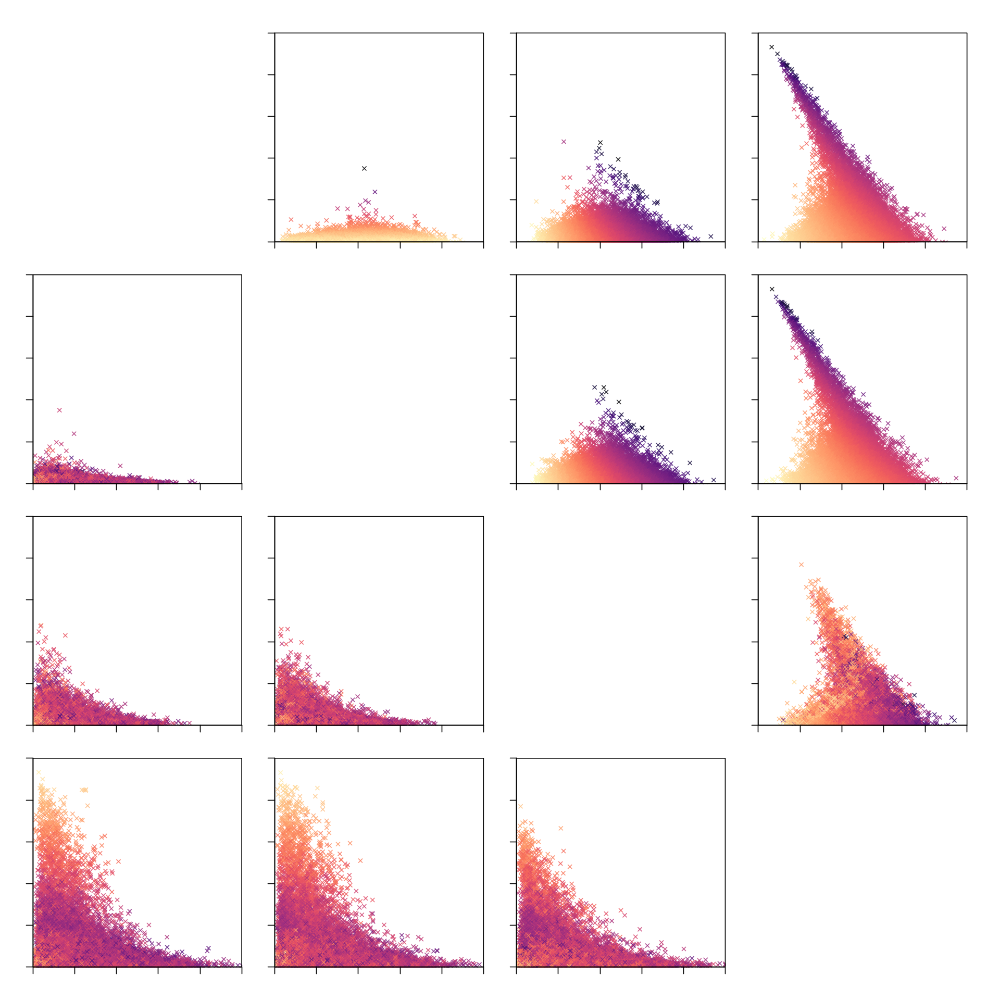

In [644]:
### OLD PLOT WITHOUT COLOR STANDARDIZED
options(repr.plot.width=16, repr.plot.height=16)
plot_Fst_correlations = function(xValues, yValues, colorValues, coloring, xLimit, yLimit, xaxisText, yaxisText, yaxisSide){
    
    color_palette = viridis(100, option = 'magma', direction = -1) # Define the color palette
    # if (coloring == 'dxy'){
    #     dxy_max = 1
    #     scale = dxy_max/100
    #     z_scaled = colorValues %/% scale
    #     z_scaled = pmax(pmin(z_scaled, 100), 1)
    # } else if (coloring == 'rec') { 
    #     pi_max = 0.5
    #     scale = pi_max/100 
    #     z_scaled = colorValues %/% scale                
    #     z_scaled = pmax(pmin(z_scaled, 100), 1)
    # }
    z_scaled = as.numeric(cut(colorValues, breaks = 100)) # Scale `z` to 100 levels
    point_colors <- color_palette[z_scaled] # Map scaled values to colors

    plot(xValues, yValues, col=alpha(point_colors, 0.8), 
         xlim=xLimit, ylim=yLimit, xaxs='i', yaxs='i',
         main='', xlab='', ylab='', 
         axes=F, frame.plot=T,
         cex=1.2, pch=4
        )

    axis(1, at = seq(xLimit[1],xLimit[2],diff(xLimit)/5), labels = ifelse(xaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = -0.8)
    # axis(yaxisSide, at = seq(yLimit[1],yLimit[2],diff(yLimit)/5), labels = ifelse(yaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = 0.8, las = 1)
    axis(2, at = seq(yLimit[1],yLimit[2],diff(yLimit)/5), labels = ifelse(yaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = -0.8)
    # axis(3, at = seq(xLimit[1],xLimit[2],diff(xLimit)/5), labels = ifelse(xaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = -0.8)
    # axis(4, at = seq(yLimit[1],yLimit[2],diff(yLimit)/5), labels = ifelse(yaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = -0.8)
}


# pdf("./_figures/fst_correlations.pdf", width = 16, height = 16) 
par(mfrow=c(4,4), mar = c(2, 2, 2, 2), oma = c(2, 2, 2, 2))

## PlaM vs. xxxx
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");
plot_Fst_correlations((dat$pi_PlaFR+dat$pi_PlaY)/2, dat$Fst_PlaFR_PlaY, dat$Fst_PlaFR_PlaY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('PlaM', side = 2, line = 2, cex = 1.5)
    # mtext('PlaY', side = 3, line = 2, cex = 1.5)
plot_Fst_correlations((dat$pi_AveFR+dat$pi_PlaFR)/2, dat$Fst_AveFR_PlaFR, dat$dxy_AveFR_PlaFR, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('AveM', side = 3, line = 2, cex = 1.5)
plot_Fst_correlations((dat$pi_AveY+dat$pi_PlaFR)/2, dat$Fst_AveY_PlaFR, dat$dxy_AveY_PlaFR, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('AveY', side = 3, line = 2, cex = 1.5)


## PlaY vs. xxxx
plot_Fst_correlations((dat$rec_PlaY+dat$rec_PlaM)/2, dat$Fst_PlaFR_PlaY, (dat$pi_PlaFR+dat$pi_PlaY)/2, 'pi', xLimit = c(0,200), yLimit = c(0,1), F, F, 2); 
    # mtext('PlaY', side = 2, line = 4, cex = 1.5)
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");
plot_Fst_correlations((dat$pi_AveFR+dat$pi_PlaY)/2, dat$Fst_AveFR_PlaY, dat$dxy_AveFR_PlaY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('PlaY', side = 2, line = 2, cex = 1.5)
plot_Fst_correlations((dat$pi_AveY+dat$pi_PlaY)/2, dat$Fst_AveY_PlaY, dat$dxy_AveY_PlaY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 

## AveM vs. xxxx
plot_Fst_correlations((dat$rec_AveM+dat$rec_PlaM)/2, dat$Fst_AveFR_PlaFR, (dat$pi_AveFR+dat$pi_PlaFR)/2, 'pi', xLimit = c(0,200), yLimit = c(0,1), F, F, 2); 
    # mtext('AveM', side = 2, line = 4, cex = 1.5)
plot_Fst_correlations((dat$rec_AveM+dat$rec_PlaY)/2, dat$Fst_AveFR_PlaY, (dat$pi_AveFR+dat$pi_PlaY)/2, 'pi', xLimit = c(0,200), yLimit = c(0,1), F, F, 2); 
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");
plot_Fst_correlations((dat$pi_AveFR+dat$pi_AveY)/2, dat$Fst_AveFR_AveY, dat$dxy_AveFR_PlaY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,1), F, F, 4); 
    # mtext('AveM', side = 2, line = 2, cex = 1.5)

## AveY vs. xxxx
plot_Fst_correlations((dat$rec_AveY+dat$rec_PlaM)/2, dat$Fst_AveY_PlaFR, (dat$pi_AveY+dat$pi_PlaFR)/2, 'pi', xLimit = c(0,150), yLimit = c(0,1), F, F, 2); 
    # mtext('AveY', side = 2, line = 2, cex = 1.5)
plot_Fst_correlations((dat$rec_AveY+dat$rec_PlaY)/2, dat$Fst_AveY_PlaY, (dat$pi_AveY+dat$pi_PlaY)/2, 'pi', xLimit = c(0,150), yLimit = c(0,1), F, F, 2); 
plot_Fst_correlations((dat$rec_AveY+dat$rec_AveM)/2, dat$Fst_AveFR_AveY, (dat$pi_AveFR+dat$pi_AveY)/2, 'pi', xLimit = c(0,150), yLimit = c(0,1), F, F, 2); 
# plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");

# mtext("Fst", side = 2, outer = TRUE, line = 2.5, cex = 1.2)
# mtext("Fst", side = 4, outer = TRUE, line = 2.5, cex = 1.2)
# dev.off()

In [674]:
pdf('./_figures/fst_correlation_colorscale.pdf', width=4, height=8)

###
options(repr.plot.height=4, repr.plot.width=8)
par(mfrow=c(1,2), mar = c(2, 2, 2, 2), oma = c(2, 2, 2, 2))

## Color scale 1
color_min = 0; color_max = 1
color_legend = seq(color_min, color_max, length.out = 100)
image(1, color_legend, t(matrix(color_legend, ncol = 1)), col = viridis(100, option = 'viridis', direction = 1), axes=F, 
      xaxt = "n", yaxt = "n", xlab='', ylab='')

## Color scale 2
color_min = 0; color_max = 1
color_legend = seq(color_min, color_max, length.out = 100)
image(1, color_legend, t(matrix(color_legend, ncol = 1)), col = viridis(100, option = 'magma', direction = -1), axes=F, 
      xaxt = "n", yaxt = "n", xlab='', ylab='')
###

dev.off()

Cairo 
    2

## pi biplot colored by Fst

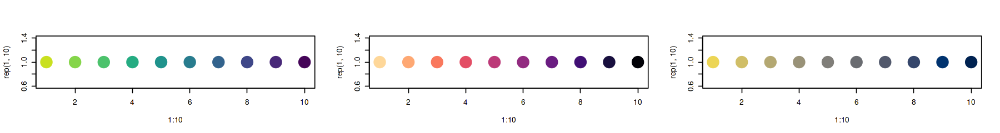

In [68]:
options(repr.plot.width=15, repr.plot.height=2)

par(mfrow=c(1,3))

# viridis
color_palette = viridis(100, option = 'viridis', direction = -1) # Define the color palette
Fst_max = 10; scale = Fst_max/100; z_scaled = pmax(pmin(c(1:10) %/% scale, 100), 1)
point_colors <- color_palette[z_scaled]
plot(1:10, rep(1,10), col=point_colors, pch=20, cex=5)

# magma
color_palette = viridis(100, option = 'magma', direction = -1) # Define the color palette
Fst_max = 10; scale = Fst_max/100; z_scaled = pmax(pmin(c(1:10) %/% scale, 100), 1)
point_colors <- color_palette[z_scaled]
plot(1:10, rep(1,10), col=point_colors, pch=20, cex=5)

# magma
color_palette = viridis(100, option = 'cividis', direction = -1) # Define the color palette
Fst_max = 10; scale = Fst_max/100; z_scaled = pmax(pmin(c(1:10) %/% scale, 100), 1)
point_colors <- color_palette[z_scaled]
plot(1:10, rep(1,10), col=point_colors, pch=20, cex=5)

In [69]:
plot_pi_correlations = function(xValues, yValues, colorValues, xLabel, yLabel){

    dataToPlot = data.frame(xValues, yValues, colorValues)
    dataToPlot = dataToPlot %>% arrange(colorValues)
    
    color_palette = viridis(100, option = 'viridis', direction = -1) # Define the color palette
    Fst_max = 0.75; scale = Fst_max/100; z_scaled = pmax(pmin(dataToPlot$colorValues %/% scale, 100), 1)
    point_colors <- color_palette[z_scaled]
    
    plot(yValues~xValues, dataToPlot, col=alpha(point_colors, 0.3), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), 
         xlab=xLabel, ylab=yLabel)
    abline(a=0,b=1, lty='longdash')
}

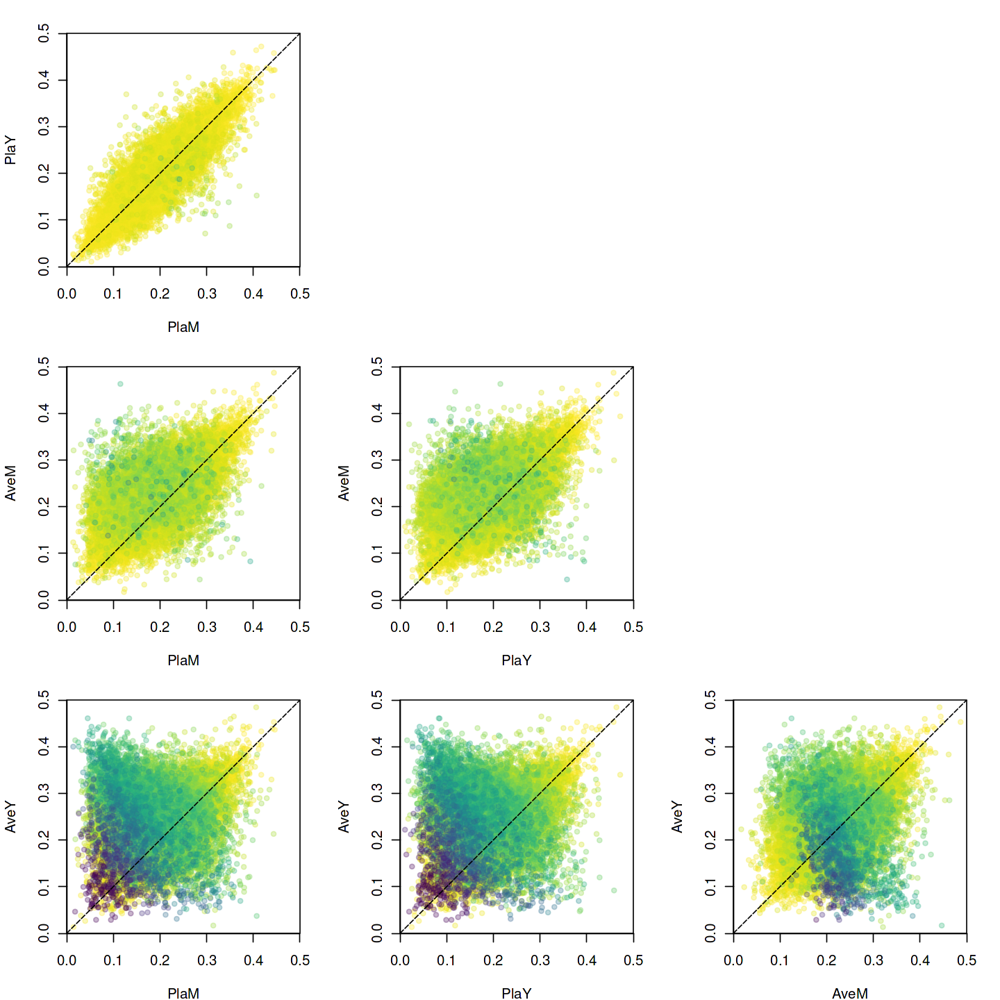

In [70]:
options(repr.plot.width=12, repr.plot.height=12)
par(mfrow=c(3,3), mar=c(4,4,2,2), cex=1, xaxs='i', yaxs='i')

# PlaY vs. xxx
plot_pi_correlations(dat$pi_PlaFR, dat$pi_PlaY, dat$Fst_PlaFR_PlaY, 'PlaM', 'PlaY')
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");

# AveM vs. xxx
plot_pi_correlations(dat$pi_PlaFR, dat$pi_AveFR, dat$Fst_AveFR_PlaFR, 'PlaM', 'AveM')
plot_pi_correlations(dat$pi_PlaY, dat$pi_AveFR, dat$Fst_AveFR_PlaY, 'PlaY', 'AveM')
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");

# AveY vs. xxx
plot_pi_correlations(dat$pi_PlaFR, dat$pi_AveY, dat$Fst_AveY_PlaFR, 'PlaM', 'AveY')
plot_pi_correlations(dat$pi_PlaY, dat$pi_AveY, dat$Fst_AveY_PlaY, 'PlaY', 'AveY')
plot_pi_correlations(dat$pi_AveFR, dat$pi_AveY, dat$Fst_AveFR_AveY, 'AveM', 'AveY')

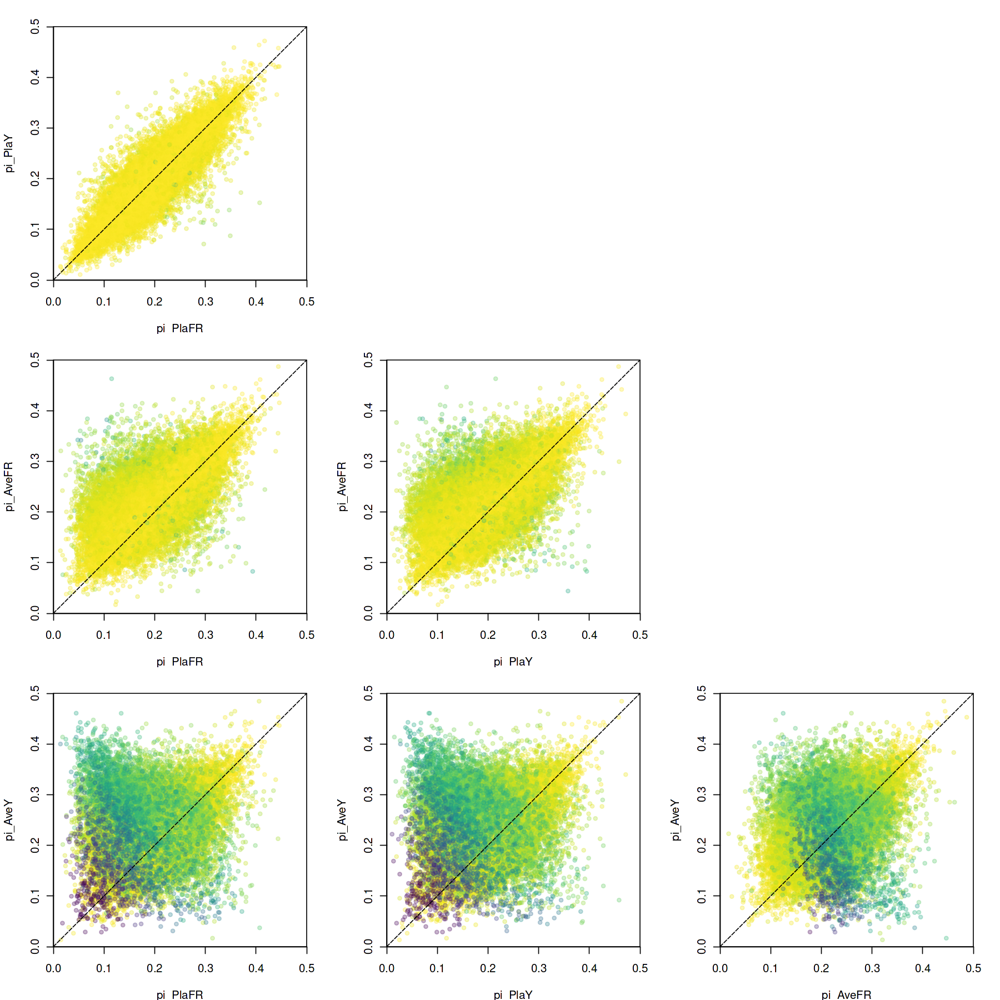

In [1041]:
options(repr.plot.width=15, repr.plot.height=15)

dat = combinedDat[sites >= 20]
dat_fstSorted = dat %>% arrange(Fst_AveFR_AveY) 


par(mfrow=c(3,3), mar=c(4,4,2,2), cex=1, xaxs='i', yaxs='i')

# Define color palette
color_palette = viridis(100, option = 'viridis', direction = -1) # Define the color palette
Fst_max = 0.75
scale = Fst_max/100

# PlaY vs. xxx
z_scaled = pmax(pmin(dat_fstSorted$Fst_PlaFR_PlaY %/% scale, 100), 1)
point_colors <- color_palette[z_scaled]
plot(pi_PlaY~pi_PlaFR, dat_fstSorted, col=alpha(point_colors, 0.3), pch=20, xlim=c(0,0.5), ylim=c(0,0.5))
abline(a=0,b=1, lty='longdash')

# plot(c(0,1), c(0,1), type = 'n', axes = F, xlab = '', ylab = '', main = '')
# axis(2, at=seq(0,1,0.5), las=1, tcl=0)
# # text(x = 0.7, y = seq(0,1,3), labels = seq(0,1,3))
# legend_image = as.raster(matrix(color_palette, ncol=1))
# rasterImage(legend_image, 0.1, 0, 0, 1)

plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");
plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");

# AveM vs xxx
z_scaled = pmax(pmin(dat_fstSorted$Fst_AveFR_PlaFR %/% scale, 100), 1)
point_colors <- color_palette[z_scaled]
plot(pi_AveFR~pi_PlaFR, dat_fstSorted, col=alpha(point_colors, 0.3), pch=20, xlim=c(0,0.5), ylim=c(0,0.5))
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted$Fst_AveFR_PlaY %/% scale, 100), 1)
point_colors <- color_palette[z_scaled]
plot(pi_AveFR~pi_PlaY, dat_fstSorted, col=alpha(point_colors, 0.3), pch=20, xlim=c(0,0.5), ylim=c(0,0.5))
abline(a=0,b=1, lty='longdash')

plot(1, 1, type = "n", xlab = "", ylab = "", axes = FALSE, xaxs = "i", yaxs = "i");

# AveY vs xxx
z_scaled = pmax(pmin(dat_fstSorted$Fst_AveY_PlaFR %/% scale, 100), 1)
point_colors <- color_palette[z_scaled]
plot(pi_AveY~pi_PlaFR, dat_fstSorted, col=alpha(point_colors, 0.3), pch=20, xlim=c(0,0.5), ylim=c(0,0.5))
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted$Fst_AveY_PlaY %/% scale, 100), 1)
point_colors <- color_palette[z_scaled]
plot(pi_AveY~pi_PlaY, dat_fstSorted, col=alpha(point_colors, 0.3), pch=20, xlim=c(0,0.5), ylim=c(0,0.5))
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted$Fst_AveFR_AveY %/% scale, 100), 1)
point_colors <- color_palette[z_scaled]
plot(pi_AveY~pi_AveFR, dat_fstSorted, col=alpha(point_colors, 0.3), pch=20, xlim=c(0,0.5), ylim=c(0,0.5))
abline(a=0,b=1, lty='longdash')

In [77]:
color_palette

[1] "#FDE725FF" "#F7E620FF" "#F1E51DFF" "#EBE51AFF" "#E4E419FF" "#DDE318FF"
  [7] "#D7E219FF" "#D0E11CFF" "#C9E020FF" "#C2DF23FF" "#BBDE28FF" "#B4DE2CFF"
 [13] "#ADDC30FF" "#A7DB35FF" "#A0DA39FF" "#99D83DFF" "#92D741FF" "#8CD646FF"
 [19] "#85D54AFF" "#7FD34EFF" "#78D152FF" "#73D056FF" "#6DCD59FF" "#67CC5CFF"
 [25] "#61CA60FF" "#5BC863FF" "#56C667FF" "#51C56AFF" "#4CC26CFF" "#47C06FFF"
 [31] "#41BE71FF" "#3DBC74FF" "#39BA76FF" "#35B779FF" "#31B67BFF" "#2EB37CFF"
 [37] "#2BB07FFF" "#28AE80FF" "#25AC82FF" "#24AA83FF" "#22A785FF" "#20A486FF"
 [43] "#1FA287FF" "#1FA088FF" "#1F9E89FF" "#1E9B8AFF" "#1F998AFF" "#1F968BFF"
 [49] "#20938CFF" "#20928CFF" "#218F8DFF" "#228D8DFF" "#238A8DFF" "#24878EFF"
 [55] "#25858EFF" "#26828EFF" "#26818EFF" "#277E8EFF" "#287C8EFF" "#29798EFF"
 [61] "#2A768EFF" "#2B748EFF" "#2C718EFF" "#2D708EFF" "#2E6D8EFF" "#2F6B8EFF"
 [67] "#31688EFF" "#32658EFF" "#33638DFF" "#34608DFF" "#355E8DFF" "#375B8DFF"
 [73] "#38598CFF" "#39558CFF" "#3B528BFF" "#3C508BFF" "#3D4D8AFF" "#3E4A89FF"
 [79] "#3F4788FF" "#404587FF" "#424186FF" "#433E85FF" "#443B84FF" "#453882FF"
 [85] "#453581FF" "#46327EFF" "#472F7CFF" "#472C7AFF" "#482878FF" "#482576FF"
 [91] "#482173FF" "#481E70FF" "#481B6DFF" "#481769FF" "#481467FF" "#471063FF"
 [97] "#470D60FF" "#46085CFF" "#450558FF" "#440154FF"

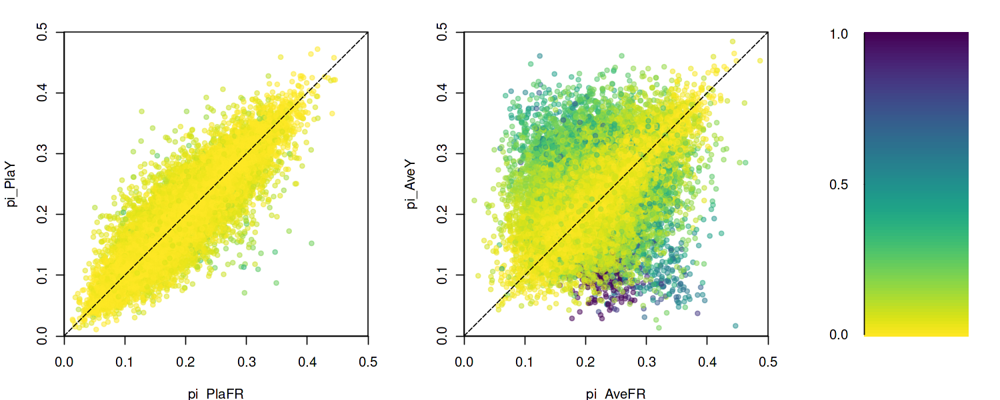

In [104]:
options(repr.plot.width=12.5, repr.plot.height=5)

layout(matrix(1:3, ncol=3), widths = c(1, 1, 0.5))
par(mar=c(4,4,2,2), cex=1, xaxs='i', yaxs='i')

# Define color palette
color_palette = viridis(100, option = 'viridis', direction = -1) # Define the color palette
Fst_max = 0.5
scale = Fst_max/100

# PlaM vs. PlaY
z_scaled = pmax(pmin(dat$Fst_PlaFR_PlaY %/% scale, 100), 1)
point_colors <- color_palette[z_scaled]
plot(pi_PlaY~pi_PlaFR, dat, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5))
abline(a=0,b=1, lty='longdash')

# AveM vs. AveY
z_scaled = pmax(pmin(dat$Fst_AveFR_AveY %/% scale, 100), 1)
point_colors <- color_palette[z_scaled]
plot(pi_AveY~pi_AveFR, dat, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5))
abline(a=0,b=1, lty='longdash')

#color scale
color_min = 0; color_max = 1
color_legend = seq(color_min, color_max, length.out = 100)
image(1, color_legend, t(matrix(color_legend, ncol = 1)), col = viridis(100, option = 'viridis', direction = -1), axes=F, 
      xaxt = "n", yaxt = "n", xlab='', ylab='')
# plot(c(0,1), c(0,1), type = 'n', axes = F, xlab = '', ylab = '', main = '')
axis(2, at=seq(0,1,0.5), las=1, tcl=0)
# text(x = 0.7, y = seq(0,1,3), labels = seq(0,1,3))
# legend_image = as.raster(matrix(rev(color_palette), ncol=1))
# rasterImage(legend_image, 0, 0, 0.25, 1)

## comparisons for Ave and Pla only

In [20]:
plot_Fst_correlations = function(xValues, yValues, colorValues, coloring, xLimit, yLimit, xaxisText, yaxisText, yaxisSide, alphaVal){
    
    if (coloring == 'dxy'){
        color_palette = viridis(100, option = 'magma', direction = -1) # Define the color palette    
        dxy_max = 0.7
        scale = dxy_max/100
        z_scaled = colorValues %/% scale
        z_scaled = pmax(pmin(z_scaled, 100), 1)
    } else if (coloring == 'pi') { 
        color_palette = viridis(100, option = 'mako', direction = +1) # Define the color palette
        pi_max = 0.4
        scale = pi_max/100 
        z_scaled = colorValues %/% scale                
        z_scaled = pmax(pmin(z_scaled, 100), 1)
    } else if (coloring == 'fst') { 
        color_palette = viridis(100, option = 'viridis', direction = -1) # Define the color palette
        fst_max = 0.7
        scale = fst_max/100 
        z_scaled = colorValues %/% scale                
        z_scaled = pmax(pmin(z_scaled, 100), 1)
    }
    # as.numeric(cut(colorValues, breaks = 100)) # Scale `z` to 100 levels
    point_colors <- color_palette[z_scaled] # Map scaled values to colors

    plot(xValues, yValues, col=alpha(point_colors, alphaVal), 
         xlim=xLimit, ylim=yLimit, xaxs='i', yaxs='i',
         main='', xlab='', ylab='', 
         axes=F, frame.plot=T,
         cex=1, pch=1
        )

    axis(1, at = seq(xLimit[1],xLimit[2],diff(xLimit)/2), labels = ifelse(xaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5)
    # axis(yaxisSide, at = seq(yLimit[1],yLimit[2],diff(yLimit)/5), labels = ifelse(yaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = 0.8, las = 1)
    axis(2, at = seq(yLimit[1],yLimit[2],diff(yLimit)/2), labels = ifelse(yaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, las=1)
    # axis(3, at = seq(xLimit[1],xLimit[2],diff(xLimit)/5), labels = ifelse(xaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = -0.8)
    # axis(4, at = seq(yLimit[1],yLimit[2],diff(yLimit)/5), labels = ifelse(yaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = -0.8)
}

In [24]:
#####
plot_pi_correlations = function(xValues, yValues, colorValues, xLabel, yLabel){

    dataToPlot = data.frame(xValues, yValues, colorValues)
    dataToPlot = dataToPlot %>% arrange(colorValues)
    
    color_palette = viridis(100, option = 'viridis', direction = -1) # Define the color palette
    # color_palette = viridis(100, option = 'turbo', direction = 1) # Define the color palette
    Fst_max = 0.66; scale = Fst_max/100; z_scaled = pmax(pmin(dataToPlot$colorValues %/% scale, 100), 1)
    point_colors <- color_palette[z_scaled]
    
    plot(yValues~xValues, dataToPlot, col=alpha(point_colors, 1), pch=1, 
         xlim=c(0,0.5), ylim=c(0,0.5), xaxs='i', yaxs='i',
         xlab=xLabel, ylab=yLabel)
    abline(a=0,b=1, lty='longdash')

    # axis(1, at = seq(xLimit[1],xLimit[2],diff(xLimit)/5), labels = ifelse(xaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5)
    # axis(2, at = seq(yLimit[1],yLimit[2],diff(yLimit)/5), labels = ifelse(yaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5)
}

#####
plot_Fst_correlations = function(xValues, yValues, colorValues, coloring, xLimit, yLimit, xaxisText, yaxisText, yaxisSide){
    
    dataToPlot = data.frame(xValues, yValues, colorValues)
    dataToPlot = dataToPlot %>% arrange(colorValues)
    
    if (coloring == 'dxy'){
        color_palette = viridis(100, option = 'magma', direction = -1) # Define the color palette    
        dxy_max = 0.66
        scale = dxy_max/100
        z_scaled = dataToPlot$colorValues %/% scale
        z_scaled = pmax(pmin(z_scaled, 100), 1)
    } else if (coloring == 'pi') { 
        color_palette = viridis(100, option = 'cividis', direction = +1) # Define the color palette
        pi_max = 0.4
        scale = pi_max/100 
        z_scaled = dataToPlot$colorValues %/% scale                
        z_scaled = pmax(pmin(z_scaled, 100), 1)
    }
    # as.numeric(cut(colorValues, breaks = 100)) # Scale `z` to 100 levels
    point_colors <- color_palette[z_scaled] # Map scaled values to colors
    
    plot(yValues~xValues, dataToPlot, col=alpha(point_colors, 1), 
         xlim=xLimit, ylim=yLimit, xaxs='i', yaxs='i',
         main='', xlab='', ylab='', 
         axes=F, frame.plot=T,
         cex=1, pch=1
        )

    # axis(1, at = seq(xLimit[1],xLimit[2],diff(xLimit)/5), labels = ifelse(xaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5)
    # axis(yaxisSide, at = seq(yLimit[1],yLimit[2],diff(yLimit)/5), labels = ifelse(yaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = 0.8, las = 1)
    # axis(2, at = seq(yLimit[1],yLimit[2],diff(yLimit)/5), labels = ifelse(yaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5)
    # axis(3, at = seq(xLimit[1],xLimit[2],diff(xLimit)/5), labels = ifelse(xaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = -0.8)
    # axis(4, at = seq(yLimit[1],yLimit[2],diff(yLimit)/5), labels = ifelse(yaxisText == TRUE, TRUE, FALSE), cex.axis = 1.5, tcl = -0.8)
}

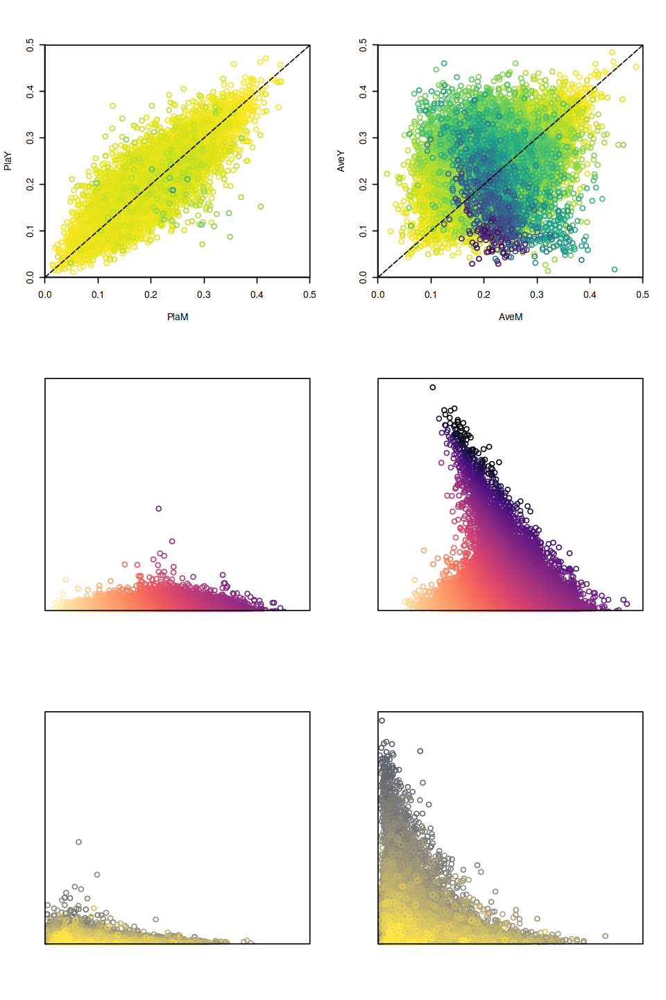

In [25]:
options(repr.plot.width=8, repr.plot.height=12)
par(mfrow=c(3,2), xaxs='i', yaxs='i'
    # mar = c(4, 2.5, 2.5, 1), oma = c(1, 1, 1, 1)
   )

### pi vs pi, color: Fst
plot_pi_correlations(dat$pi_PlaFR, dat$pi_PlaY, dat$Fst_PlaFR_PlaY, 'PlaM', 'PlaY')
plot_pi_correlations(dat$pi_AveFR, dat$pi_AveY, dat$Fst_AveFR_AveY, 'AveM', 'AveY')

### Fst vs. mean-pi, color: dxy
plot_Fst_correlations((dat$pi_PlaFR+dat$pi_PlaY)/2, dat$Fst_PlaFR_PlaY, dat$dxy_PlaFR_PlaY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,0.8), T, T, 2); 
axis(2, at)
plot_Fst_correlations((dat$pi_AveFR+dat$pi_AveY)/2, dat$Fst_AveFR_AveY, dat$dxy_AveFR_AveY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,0.8), T, F, 2); 

### Fst vs. recombination rate, color: pi
plot_Fst_correlations((dat$rec_PlaY+dat$rec_PlaM)/2, dat$Fst_PlaFR_PlaY, (dat$pi_PlaFR+dat$pi_PlaY)/2, 'pi', xLimit = c(0,200), yLimit = c(0,0.8), T, T, 2); 
plot_Fst_correlations((dat$rec_AveY+dat$rec_AveM)/2, dat$Fst_AveFR_AveY, (dat$pi_AveFR+dat$pi_AveY)/2, 'pi', xLimit = c(0,200), yLimit = c(0,0.8), T, F, 2); 

In [27]:
options(repr.plot.width=8, repr.plot.height=12)
par(mfrow=c(3,2), mar = c(4, 2.5, 2.5, 1), oma = c(1, 1, 1, 1))

### pi vs pi, color: dxy
dat_fstSorted = dat %>% arrange(Fst_PlaFR_PlaY) 
plot_Fst_correlations(dat_fstSorted$pi_PlaFR, dat_fstSorted$pi_PlaY, dat_fstSorted$Fst_PlaFR_PlaY, 'fst', xLimit = c(0,0.5), yLimit = c(0,0.5), T, T, 2); 
abline(a=0,b=1, lty='longdash')

dat_fstSorted = dat %>% arrange(Fst_PlaFR_PlaY) 
plot_Fst_correlations(dat_fstSorted$pi_AveFR, dat_fstSorted$pi_AveY, dat_fstSorted$Fst_AveFR_AveY, 'fst', xLimit = c(0,0.5), yLimit = c(0,0.5), T, F, 2); 
abline(a=0,b=1, lty='longdash')

### Fst vs. mean-pi, color: dxy
plot_Fst_correlations((dat_fstSorted$pi_PlaFR+dat_fstSorted$pi_PlaY)/2, dat_fstSorted$Fst_PlaFR_PlaY, dat_fstSorted$dxy_PlaFR_PlaY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,0.8), T, T, 2, 0.5); 
plot_Fst_correlations((dat_fstSorted$pi_AveFR+dat_fstSorted$pi_AveY)/2, dat_fstSorted$Fst_AveFR_AveY, dat_fstSorted$dxy_AveFR_AveY, 'dxy', xLimit = c(0,0.5), yLimit = c(0,0.8), T, F, 2, 0.5); 

### Fst vs. recombination rate, color: pi
plot_Fst_correlations((dat_fstSorted$rec_PlaY+dat_fstSorted$rec_PlaM)/2, dat_fstSorted$Fst_PlaFR_PlaY, (dat_fstSorted$pi_PlaFR+dat_fstSorted$pi_PlaY)/2, 'pi', xLimit = c(0,200), yLimit = c(0,0.8), T, T, 2, 0.5); 
plot_Fst_correlations((dat_fstSorted$rec_AveY+dat_fstSorted$rec_AveM)/2, dat_fstSorted$Fst_AveFR_AveY, (dat_fstSorted$pi_AveFR+dat_fstSorted$pi_AveY)/2, 'pi', xLimit = c(0,200), yLimit = c(0,0.8), T, F, 2, 0.5); 

ERROR: Error in plot_Fst_correlations((dat_fstSorted$pi_PlaFR + dat_fstSorted$pi_PlaY)/2, : unused argument (0.5)


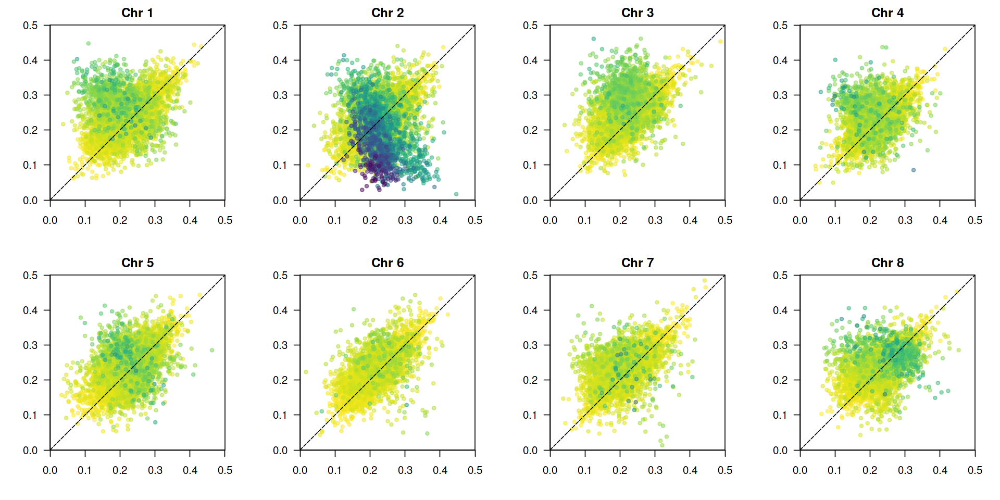

In [32]:
options(repr.plot.width=16, repr.plot.height=8)
# pdf('./_figures/figSx_pi_chrom_Ave', width = 10, height = 5)
par(mfrow=c(2,4), mar=c(4,4,2,2), cex=1, xaxs='i', yaxs='i', las=1)

dat_fstSorted = dat %>% arrange(Fst_AveFR_AveY)

dat_fstSorted_1 = dat_fstSorted[chrom=='Chr1']
dat_fstSorted_2 = dat_fstSorted[chrom=='Chr2']
dat_fstSorted_3 = dat_fstSorted[chrom=='Chr3']
dat_fstSorted_4 = dat_fstSorted[chrom=='Chr4']
dat_fstSorted_5 = dat_fstSorted[chrom=='Chr5']
dat_fstSorted_6 = dat_fstSorted[chrom=='Chr6']
dat_fstSorted_7 = dat_fstSorted[chrom=='Chr7']
dat_fstSorted_8 = dat_fstSorted[chrom=='Chr8']

# Define color palette
color_palette = viridis(100, option = 'viridis', direction = -1) # Define the color palette
Fst_max = 0.66; scale = Fst_max/100; 

# plot(pi_PlaY~pi_PlaFR, dat_fstSorted[chrom], col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5))
# abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_1$Fst_AveFR_AveY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_AveY~pi_AveFR, dat_fstSorted_1, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr 1', xlab='', ylab='')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_2$Fst_AveFR_AveY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_AveY~pi_AveFR, dat_fstSorted_2, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr 2', xlab='', ylab='')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_3$Fst_AveFR_AveY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_AveY~pi_AveFR, dat_fstSorted_3, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr 3', xlab='', ylab='')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_4$Fst_AveFR_AveY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_AveY~pi_AveFR, dat_fstSorted_4, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr 4', xlab='', ylab='')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_5$Fst_AveFR_AveY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_AveY~pi_AveFR, dat_fstSorted_5, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr 5', xlab='', ylab='')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_6$Fst_AveFR_AveY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_AveY~pi_AveFR, dat_fstSorted_6, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr 6', xlab='', ylab='')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_7$Fst_AveFR_AveY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_AveY~pi_AveFR, dat_fstSorted_7, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr 7', xlab='', ylab='')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_8$Fst_AveFR_AveY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_AveY~pi_AveFR, dat_fstSorted_8, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr 8', xlab='', ylab='')
abline(a=0,b=1, lty='longdash')
# dev.off()

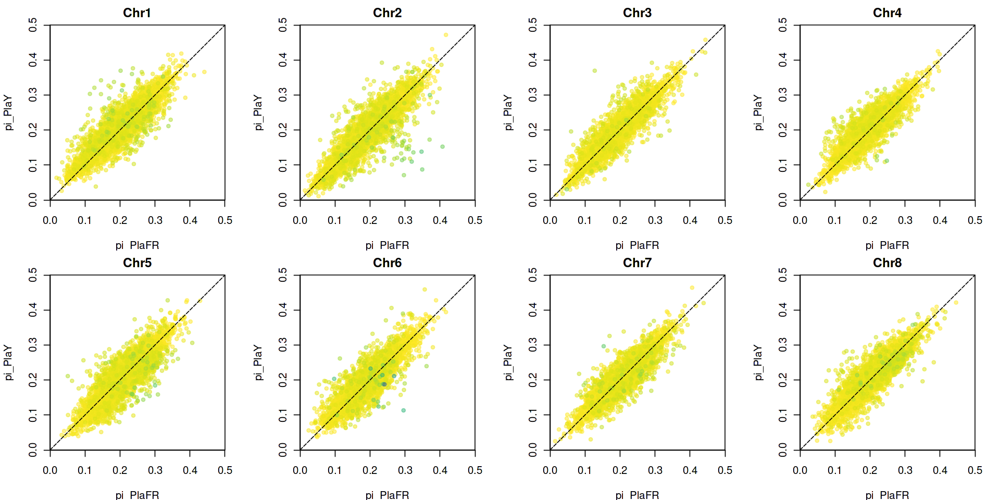

In [1171]:
options(repr.plot.width=16, repr.plot.height=8)
par(mfrow=c(2,4), mar=c(4,4,2,2), cex=1, xaxs='i', yaxs='i')

dat_fstSorted = dat %>% arrange(Fst_PlaFR_PlaY)

dat_fstSorted_1 = dat_fstSorted[chrom=='Chr1']
dat_fstSorted_2 = dat_fstSorted[chrom=='Chr2']
dat_fstSorted_3 = dat_fstSorted[chrom=='Chr3']
dat_fstSorted_4 = dat_fstSorted[chrom=='Chr4']
dat_fstSorted_5 = dat_fstSorted[chrom=='Chr5']
dat_fstSorted_6 = dat_fstSorted[chrom=='Chr6']
dat_fstSorted_7 = dat_fstSorted[chrom=='Chr7']
dat_fstSorted_8 = dat_fstSorted[chrom=='Chr8']

# Define color palette
color_palette = viridis(100, option = 'viridis', direction = -1) # Define the color palette
Fst_max = 0.5; scale = Fst_max/100; 

# plot(pi_PlaY~pi_PlaFR, dat_fstSorted[chrom], col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5))
# abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_1$Fst_PlaFR_PlaY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_PlaY~pi_PlaFR, dat_fstSorted_1, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr1')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_2$Fst_PlaFR_PlaY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_PlaY~pi_PlaFR, dat_fstSorted_2, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr2')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_3$Fst_PlaFR_PlaY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_PlaY~pi_PlaFR, dat_fstSorted_3, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr3')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_4$Fst_PlaFR_PlaY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_PlaY~pi_PlaFR, dat_fstSorted_4, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr4')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_5$Fst_PlaFR_PlaY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_PlaY~pi_PlaFR, dat_fstSorted_5, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr5')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_6$Fst_PlaFR_PlaY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_PlaY~pi_PlaFR, dat_fstSorted_6, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr6')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_7$Fst_PlaFR_PlaY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_PlaY~pi_PlaFR, dat_fstSorted_7, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr7')
abline(a=0,b=1, lty='longdash')

z_scaled = pmax(pmin(dat_fstSorted_8$Fst_PlaFR_PlaY %/% scale, 100), 1); point_colors <- color_palette[z_scaled]
plot(pi_PlaY~pi_PlaFR, dat_fstSorted_8, col=alpha(point_colors, 0.5), pch=20, xlim=c(0,0.5), ylim=c(0,0.5), main='Chr8')
abline(a=0,b=1, lty='longdash')

## Blowup for Chr2

In [ ]:
dat2 = combinedDat[sites>=20 & chrom == 'Chr2']
dat2 = dat2 %>% arrange(mid)
str(dat2)

In [729]:
span = 0.02
fst_smooth = loess.smooth.weights(dat2$mid, dat2$Fst_AveFR_AveY, sites=dat2$sites, span=span, family='gaussian')
dxy_smooth = loess.smooth.weights(dat2$mid, dat2$dxy_AveFR_AveY, sites=dat2$sites, span=span, family='gaussian')
piAveM_smooth = loess.smooth.weights(dat2$mid, dat2$pi_AveFR, sites=dat2$sites, span=span, family='gaussian')
piAveY_smooth = loess.smooth.weights(dat2$mid, dat2$pi_AveY, sites=dat2$sites, span=span, family='gaussian')
rho_smooth = loess.smooth.weights(dat2$mid, (dat2$rec_AveM + dat2$rec_AveY)/2, sites=dat2$sites, span=span, family='gaussian')

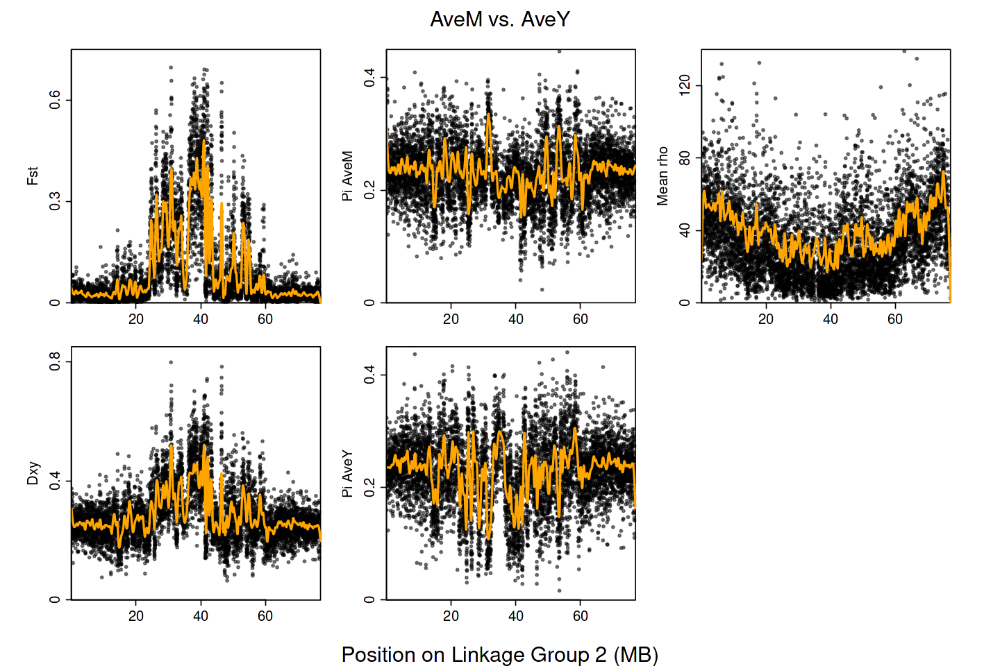

In [738]:
options(repr.plot.height=8, repr.plot.width=12)

par(mar=c(2,4,2,2), oma = c(4,2.5,2.5,2.5), mfcol=c(2,3), xaxs='i', yaxs='i', cex.lab=1.5)

plot(Fst_AveFR_AveY~mid, dat2, cex=0.8, col=alpha('black', 0.5), type='p', pch=20, xaxt='n', yaxt='n', ylab='Fst', ylim=c(0,0.75))
lines(fst_smooth~mid, dat2, col='orange', lwd=2)
    axis(1, at=seq(0,7e7,2e7), labels = seq(0,70,20), cex.axis=1.5)
    axis(2, at=seq(0,1,0.3), labels = seq(0,1,0.3), cex.axis=1.5)

plot(dxy_AveFR_AveY~mid, dat2, cex=0.8, col=alpha('black', 0.5),type='p', pch=20, xaxt='n', yaxt='n', ylab='Dxy', ylim=c(0,0.85))
lines(dxy_smooth~mid, dat2,col='orange', lwd=2)
    axis(1, at=seq(0,7e7,2e7), labels = seq(0,70,20), cex.axis=1.5)
    axis(2, at=seq(0,1,0.4), labels = seq(0,1,0.4), cex.axis=1.5)

plot(dat2$mid, dat2$pi_AveFR, cex=0.8, col=alpha('black', 0.5), type='p', pch=20, xaxt='n', yaxt='n', ylab='Pi AveM', ylim=c(0,0.45))
lines(piAveM_smooth~mid, dat2, col='orange', lwd=2)
    axis(1, at=seq(0,7e7,2e7), labels = seq(0,70,20), cex.axis=1.5)
    axis(2, at=seq(0,1,0.2), labels = seq(0,1,0.2), cex.axis=1.5)

plot(dat2$mid, dat2$pi_AveY, cex=0.8, col=alpha('black', 0.5), type='p', pch=20, xaxt='n', yaxt='n', ylab='Pi AveY', ylim=c(0,0.45))
lines(piAveY_smooth~mid, dat2, col='orange', lwd=2)
    axis(1, at=seq(0,7e7,2e7), labels = seq(0,70,20), cex.axis=1.5)
    axis(2, at=seq(0,1,0.2), labels = seq(0,1,0.2), cex.axis=1.5)

plot(dat2$mid, (dat2$rec_AveM + dat2$rec_AveY)/2, cex=0.8, col=alpha('black', 0.5), type='p', pch=20, xaxt='n', yaxt='n', ylab='Mean rho', ylim=c(0,140))
lines(rho_smooth~mid, dat2, col='orange', lwd=2)
    axis(1, at=seq(0,7e7,2e7), labels = seq(0,70,20), cex.axis=1.5)
    axis(2, at=seq(0,140,40), labels = seq(0,140,40), cex.axis=1.5)

mtext('Position on Linkage Group 2 (MB)', outer=TRUE, side=1, line=2.7, cex=1.5)
mtext('AveM vs. AveY', outer=TRUE, side=3, line=0, cex=1.5)

In [653]:
pdf('./_figures/blowup_chr2.pdf', width=15, height=4)
options(repr.plot.height=4, repr.plot.width=15)

par(mar=c(2,4,2,2), oma = c(4,2.5,2.5,2.5), mfrow=c(1,4), xaxs='i', yaxs='i', cex.lab=1.5)

plot(Fst_AveFR_AveY~mid, dat2, cex=0.8, type='p', pch=20, xaxt='n', yaxt='n', ylab='Fst', ylim=c(0,0.75))
lines(fst_smooth~mid, dat2, col='cyan', lwd=2)
    axis(1, at=seq(0,7e7,2e7), labels = seq(0,70,20), cex.axis=1.5)
    axis(2, at=seq(0,1,0.3), labels = seq(0,1,0.3), cex.axis=1.5)

plot(dxy_AveFR_AveY~mid, dat2, cex=0.3, type='p', pch=20, xaxt='n', yaxt='n', ylab='Dxy', ylim=c(0,0.85))
lines(dxy_smooth~mid, dat2, col='cyan', lwd=2)
    axis(1, at=seq(0,7e7,2e7), labels = seq(0,70,20), cex.axis=1.5)
    axis(2, at=seq(0,1,0.4), labels = seq(0,1,0.4), cex.axis=1.5)

plot(dat2$mid, (dat2$pi_AveFR + dat2$pi_AveY)/2, cex=0.3, type='p', pch=20, xaxt='n', yaxt='n', ylab='Mean Pi', ylim=c(0,0.45))
lines(pi_smooth~mid, dat2, col='cyan', lwd=2)
    axis(1, at=seq(0,7e7,2e7), labels = seq(0,70,20), cex.axis=1.5)
    axis(2, at=seq(0,1,0.2), labels = seq(0,1,0.2), cex.axis=1.5)

plot(dat2$mid, (dat2$rec_AveM + dat2$rec_AveY)/2, cex=0.3, type='p', pch=20, xaxt='n', yaxt='n', ylab='Mean rho', ylim=c(0,140))
lines(rho_smooth~mid, dat2, col='cyan', lwd=2)
    axis(1, at=seq(0,7e7,2e7), labels = seq(0,70,20), cex.axis=1.5)
    axis(2, at=seq(0,140,40), labels = seq(0,140,40), cex.axis=1.5)

mtext('Position on Linkage Group 2 (MB)', outer=TRUE, side=1, line=2.7, cex=1.5)
mtext('AveM vs. AveY', outer=TRUE, side=3, line=0, cex=1.5)

dev.off()

Cairo 
    2

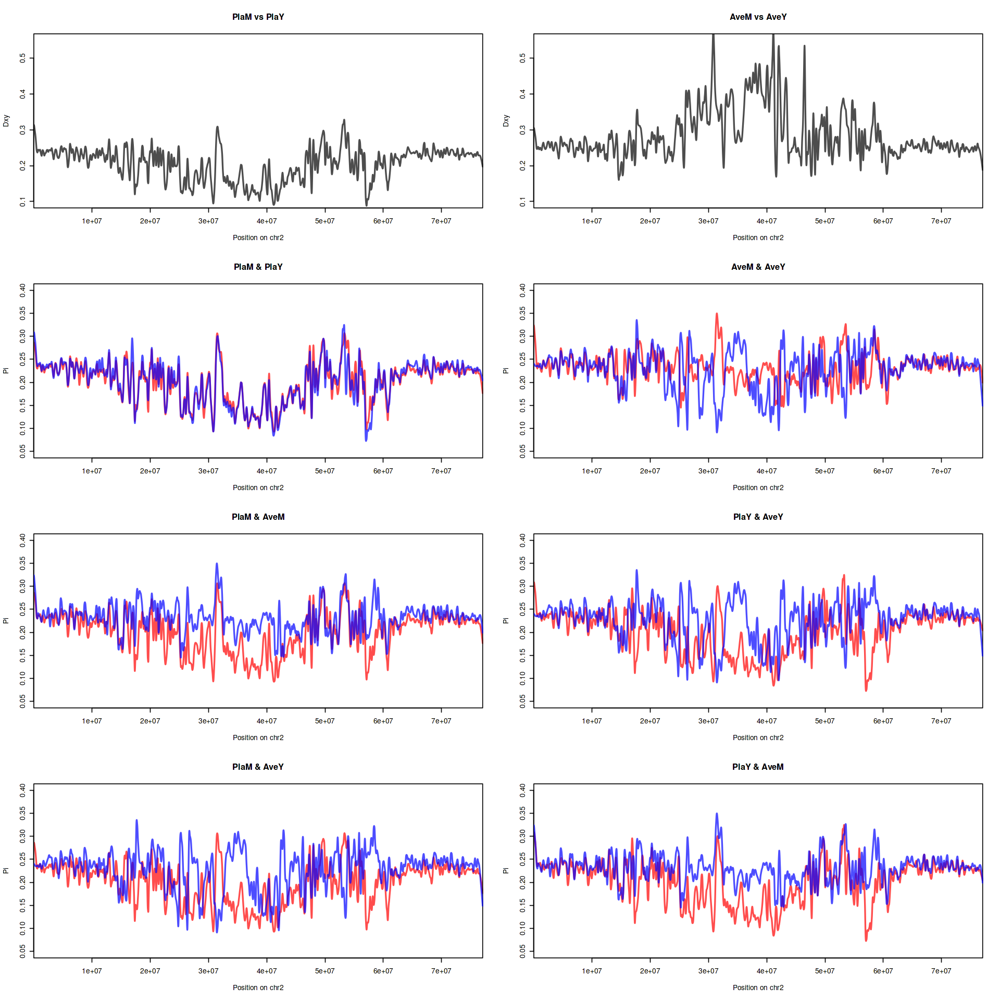

In [929]:
options(repr.plot.height=16, repr.plot.width=16)
span=0.01
par(xaxs='i', mfrow=c(4,2))


piAveM_smooth = loess.smooth.weights(dat2$mid, dat2$pi_AveFR, sites=dat2$sites, span=span, family='gaussian')
piAveY_smooth = loess.smooth.weights(dat2$mid, dat2$pi_AveY, sites=dat2$sites, span=span, family='gaussian')
piPlaM_smooth = loess.smooth.weights(dat2$mid, dat2$pi_PlaFR, sites=dat2$sites, span=span, family='gaussian')
piPlaY_smooth = loess.smooth.weights(dat2$mid, dat2$pi_PlaY, sites=dat2$sites, span=span, family='gaussian')
dxyAveMAveY_smooth = loess.smooth.weights(dat2$mid, dat2$dxy_AveFR_AveY, sites=dat2$sites, span=span, family='gaussian')
dxyPlaMPlaY_smooth = loess.smooth.weights(dat2$mid, dat2$dxy_PlaFR_PlaY, sites=dat2$sites, span=span, family='gaussian')

##Dxy
plot(dxyPlaMPlaY_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('black', 0.7), ylim=c(0.1,0.55), 
     main='PlaM vs PlaY', ylab='Dxy', xlab='Position on chr2')
plot(dxyAveMAveY_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('black', 0.7), ylim=c(0.1,0.55), 
     main='AveM vs AveY', ylab='Dxy', xlab='Position on chr2')

# within HZ
plot(piPlaM_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('red', 0.7), ylim=c(0.05,0.4), 
     main='PlaM & PlaY', ylab='Pi', xlab='Position on chr2')
lines(piPlaY_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('blue', 0.7))

plot(piAveM_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('red', 0.7), ylim=c(0.05,0.4), 
     main='AveM & AveY', ylab='Pi', xlab='Position on chr2')
lines(piAveY_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('blue', 0.7))

# within color
plot(piPlaM_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('red', 0.7), ylim=c(0.05,0.4), 
     main='PlaM & AveM', ylab='Pi', xlab='Position on chr2')
lines(piAveM_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('blue', 0.7))

plot(piPlaY_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('red', 0.7), ylim=c(0.05,0.4), 
     main='PlaY & AveY', ylab='Pi', xlab='Position on chr2')
lines(piAveY_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('blue', 0.7))

# within color
plot(piPlaM_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('red', 0.7), ylim=c(0.05,0.4), 
     main='PlaM & AveY', ylab='Pi', xlab='Position on chr2')
lines(piAveY_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('blue', 0.7))

plot(piPlaY_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('red', 0.7), ylim=c(0.05,0.4), 
     main='PlaY & AveM', ylab='Pi', xlab='Position on chr2')
lines(piAveM_smooth~mid, dat2, pch=20, lwd=2, type='l', col=alpha('blue', 0.7))

## Pi vs rec

In [1198]:
str(dat)

Classes ‘data.table’ and 'data.frame':	47375 obs. of  31 variables:
 $ windowID        : int  1 2 3 4 6 7 8 9 10 11 ...
 $ scaffold        : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ start           : int  1 10001 20001 30001 50001 60001 70001 80001 90001 100001 ...
 $ end             : int  10000 20000 30000 40000 60000 70000 80000 90000 100000 110000 ...
 $ mid             : num  7311 15387 24812 31845 57606 ...
 $ sites           : int  118 126 227 53 20 209 199 219 152 139 ...
 $ pi_AveFR        : num  0.278 0.233 0.228 0.257 0.301 ...
 $ pi_AveY         : num  0.324 0.23 0.221 0.278 0.284 ...
 $ pi_PlaFR        : num  0.287 0.202 0.22 0.225 0.233 ...
 $ pi_PlaY         : num  0.28 0.234 0.252 0.192 0.221 ...
 $ dxy_AveFR_AveY  : num  0.309 0.236 0.234 0.274 0.313 ...
 $ dxy_AveFR_PlaFR : num  0.281 0.224 0.227 0.244 0.265 ...
 $ dxy_AveFR_PlaY  : num  0.281 0.238 0.247 0.242 0.265 ...
 $ dxy_AveY_PlaFR  : num  0.313 0.233 0.232 0.259 0.285 ...
 $ dxy_AveY_PlaY   : num  0.315 0.248 0

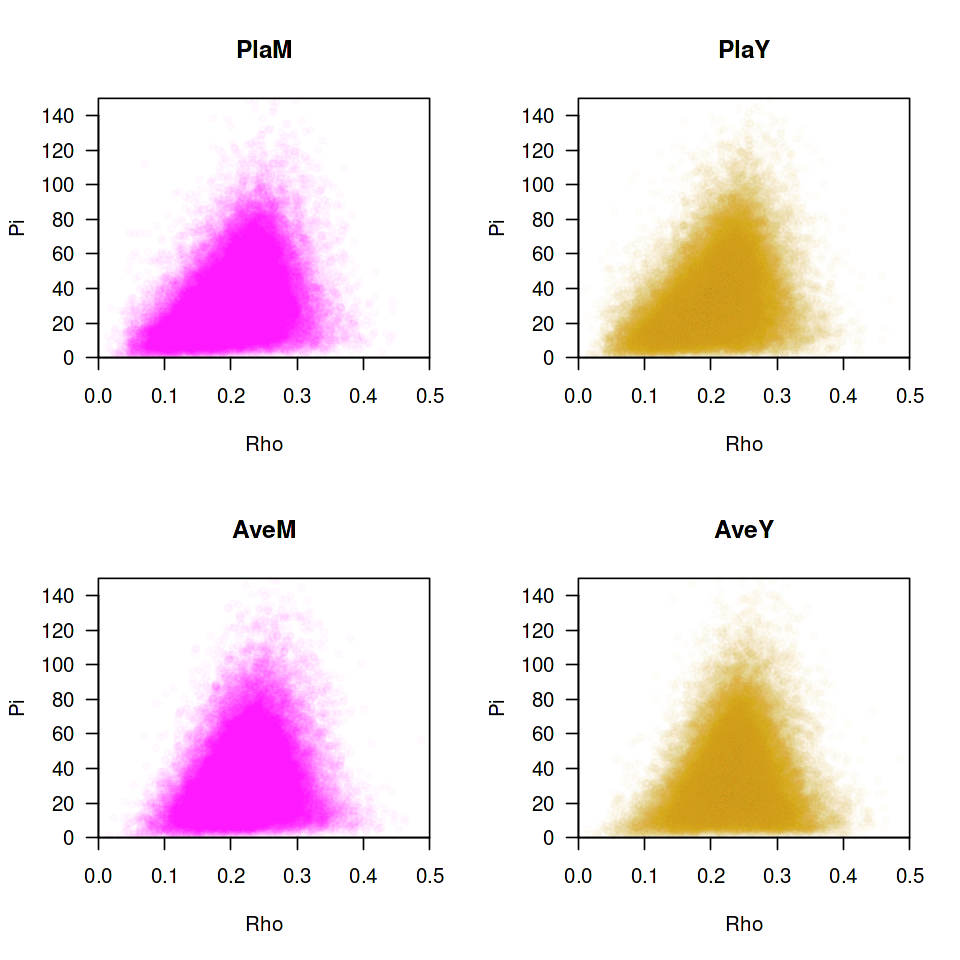

In [1211]:
options(repr.plot.height=8, repr.plot.width=8)
par(xaxs='i', mfrow=c(2,2), yaxs='i', cex=1, las=1)

yLim=c(0,150)
xLim=c(0,0.5)

plot(dat$pi_PlaFR, dat$rec_PlaM, xlim=xLim, ylim=yLim, pch=20, col=alpha('magenta', 0.02), xlab='Rho', ylab='Pi', main='PlaM', cex=1)
plot(dat$pi_PlaY, dat$rec_PlaY, xlim=xLim, ylim=yLim, pch=20, col=alpha('gold3', 0.02), xlab='Rho', ylab='Pi', main='PlaY', cex=1)
plot(dat$pi_AveFR, dat$rec_AveM, xlim=xLim, ylim=yLim, pch=20, col=alpha('magenta', 0.02), xlab='Rho', ylab='Pi', main='AveM', cex=1)
plot(dat$pi_AveY, dat$rec_AveY, xlim=xLim, ylim=yLim, pch=20, col=alpha('gold3', 0.02), xlab='Rho', ylab='Pi', main='AveY', cex=1)

In [1223]:
options(repr.plot.height=8, repr.plot.width=8)
par(xaxs='i', mfrow=c(1,1))

colsToPlot = c('chrom','pi_PlaFR', 'pi_PlaY', 'pi_AveFR', 'pi_AveY')
datPi = dat[, ..colsToPlot]

# datPi %>% gather(key='Pop', value='pi') %>%
#        ggplot(aes(x=Pop, y=pi)) +
#             geom_violin() + #geom_jitter() 
#             geom_boxplot(width=0.1)

# boxplot(dat2[,17:20])
# ggplot(dat) + geom_violin()

# # hist(dat2$pi_PlaFR)
# # hist(dat2$pi_PlaY)
# # hist(dat2$pi_AveFR)
# # hist(dat2$pi_AveY)

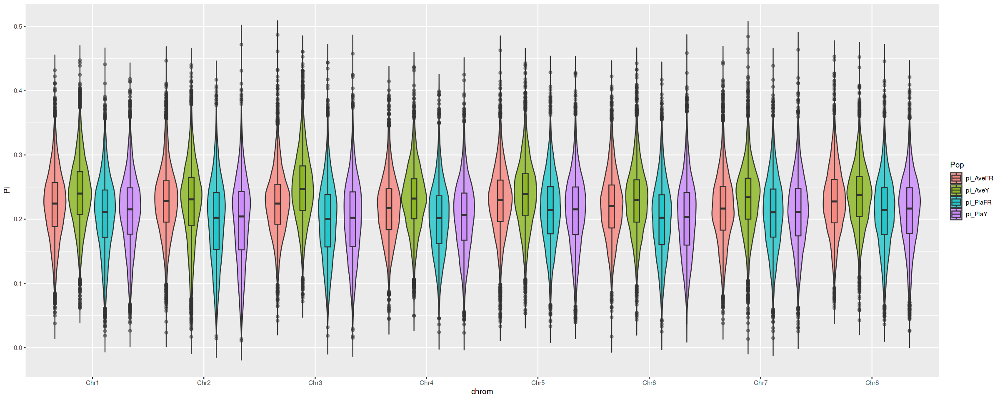

In [1245]:
options(repr.plot.height=8, repr.plot.width=20)

datPi %>%  
    pivot_longer(cols = starts_with(c("pi_PlaFR", "pi_PlaY", "pi_AveFR", "pi_AveY")), names_to = "Pop", values_to = "Pi") %>%
    ggplot(aes(x=chrom, y=Pi, fill=Pop))  +
                geom_violin(trim = FALSE, alpha = 0.7) +
                geom_boxplot(width = 0.2, position = position_dodge(width = 0.9), alpha=0.5)

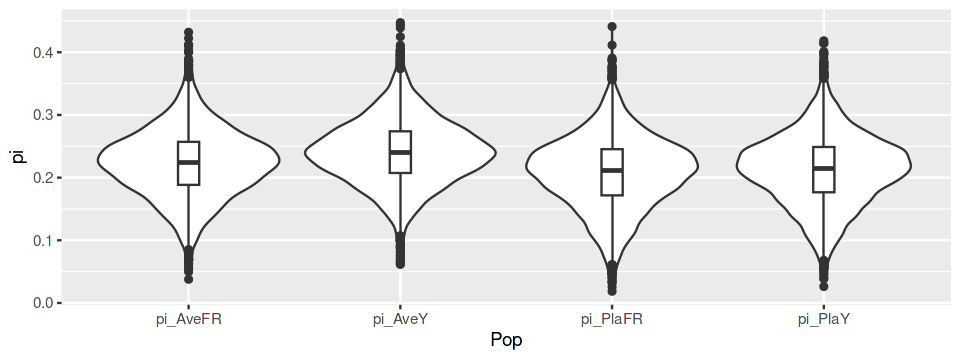

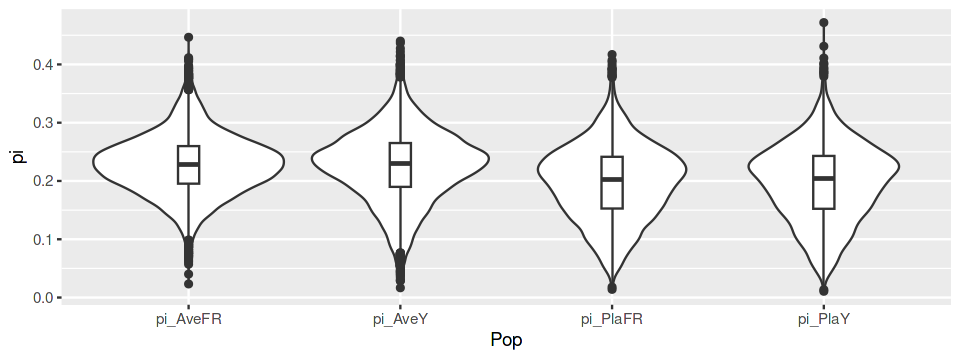

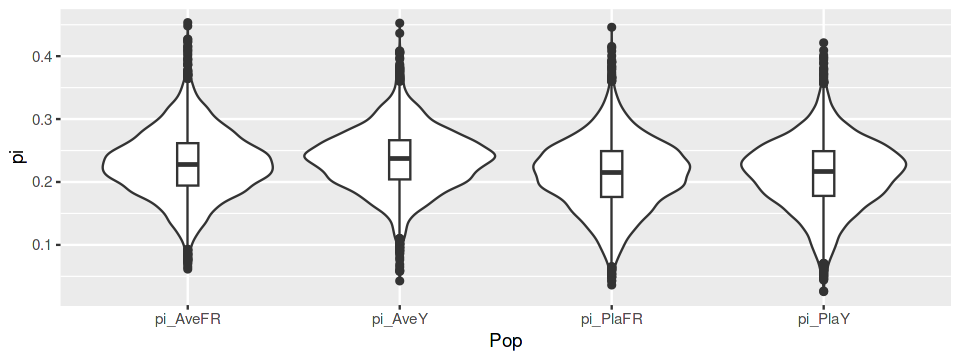

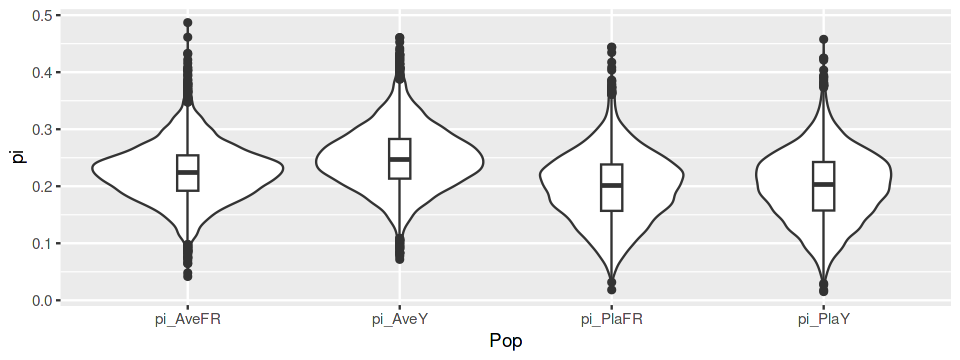

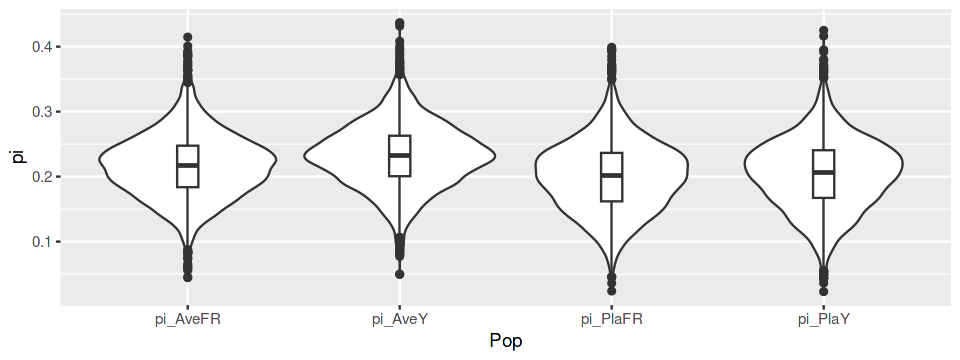

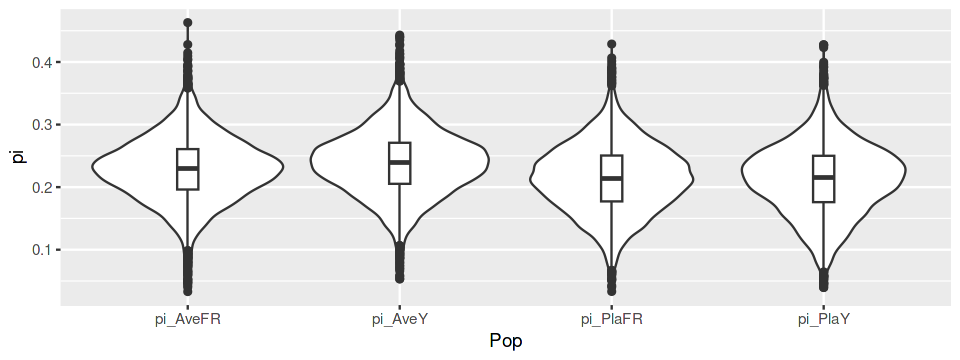

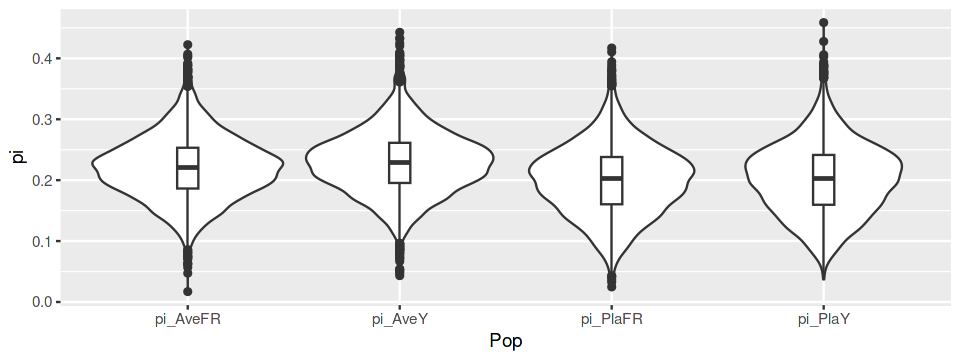

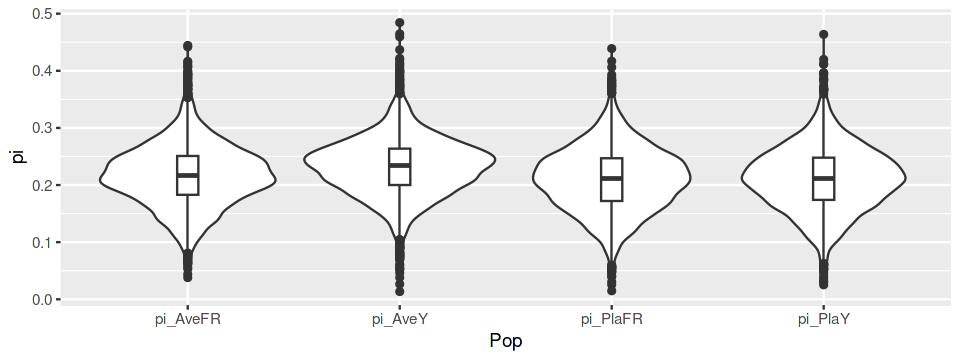

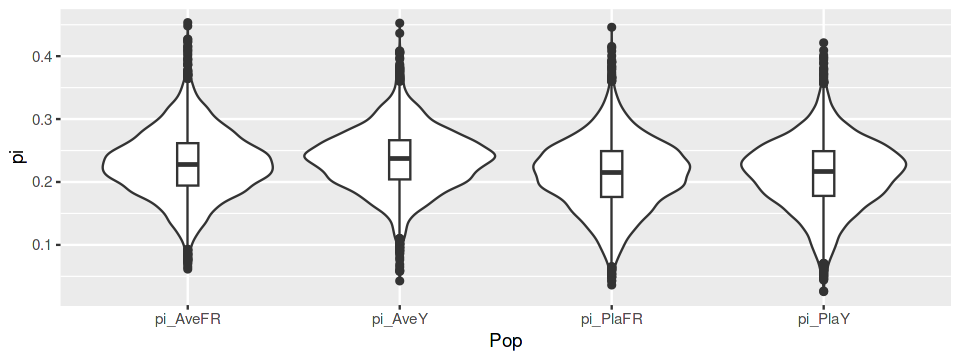

In [1246]:
options(repr.plot.height=3, repr.plot.width=8)

datPi_chr1 = datPi[chrom=='Chr1']
datPi_chr2 = datPi[chrom=='Chr2']
datPi_chr3 = datPi[chrom=='Chr3']
datPi_chr4 = datPi[chrom=='Chr4']
datPi_chr5 = datPi[chrom=='Chr5']
datPi_chr6 = datPi[chrom=='Chr6']
datPi_chr7 = datPi[chrom=='Chr7']
datPi_chr8 = datPi[chrom=='Chr8']

plot_pi_vioplot = function(chromDat){
    chromDat[,2:5] %>% gather(key='Pop', value='pi') %>%
            ggplot(aes(x=Pop, y=pi)) +
                geom_violin() + #geom_jitter() 
                geom_boxplot(width=0.1)
}

plot_pi_vioplot(datPi_chr1)
plot_pi_vioplot(datPi_chr2)
plot_pi_vioplot(datPi_chr3)
plot_pi_vioplot(datPi_chr4)
plot_pi_vioplot(datPi_chr5)
plot_pi_vioplot(datPi_chr6)
plot_pi_vioplot(datPi_chr7)
plot_pi_vioplot(datPi_chr8)

## Correlations

In [1252]:
dat = dat %>% mutate(rec_mean = (rec_PlaM+rec_PlaY+rec_AveM+rec_AveY)/4, 
                     rec_Pla = (rec_PlaM+rec_PlaY)/2, 
                     rec_Ave = (rec_AveM+rec_AveY)/2
                    )
str(dat)

Classes ‘data.table’ and 'data.frame':	47375 obs. of  37 variables:
 $ chrom_start_end: chr  "Chr1_10000001_10010000" "Chr1_1000001_1010000" "Chr1_100001_110000" "Chr1_10001_20000" ...
 $ chrom          : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ windowStart    : int  10000001 1000001 100001 10001 10010001 10020001 10030001 10040001 10050001 10060001 ...
 $ windowEnd      : int  10010000 1010000 110000 20000 10020000 10030000 10040000 10050000 10060000 10070000 ...
 $ windowMid      : num  10005000 1005000 105000 15000 10015000 ...
 $ rec_sites      : int  243 607 139 126 253 419 328 106 267 335 ...
 $ rec_PlaM       : num  20.6 53 28.4 35.9 10.9 ...
 $ rec_PlaY       : num  22.5 66.7 19.4 48.9 36.4 ...
 $ rec_AveM       : num  61.2 53.2 13.3 55.2 19.6 ...
 $ rec_AveY       : num  25.5 51.6 22.3 19.8 14.7 ...
 $ windowID       : int  1001 101 11 2 1002 1003 1004 1005 1006 1007 ...
 $ scaffold       : chr  "Chr1" "Chr1" "Chr1" "Chr1" ...
 $ start          : int  10000001 1000001 100001 10

In [1253]:
cor(dat[,c(35:37,17:32)], use="na.or.complete", method="spearman")

,rec_mean,rec_Pla,rec_Ave,pi_AveFR,pi_AveY,pi_PlaFR,pi_PlaY,dxy_AveFR_AveY,dxy_AveFR_PlaFR,dxy_AveFR_PlaY,dxy_AveY_PlaFR,dxy_AveY_PlaY,dxy_PlaFR_PlaY,Fst_AveFR_AveY,Fst_AveFR_PlaFR,Fst_AveFR_PlaY,Fst_AveY_PlaFR,Fst_AveY_PlaY,Fst_PlaFR_PlaY
rec_mean,1.00000000,0.9505124,0.95223013,0.2562179501,0.133399239,0.38457879,0.388403370,0.07144942,0.302310678,0.29456224,0.07255630,0.06865048,0.38591852,-0.29516732,-0.23016854,-0.265416352,-0.3650879067,-0.374808264,-0.084353748
rec_Pla,0.95051235,1.0000000,0.81410461,0.2664577915,0.137202049,0.38493598,0.386320610,0.11131162,0.310792525,0.30191215,0.11547052,0.11037970,0.38416135,-0.23200696,-0.20819308,-0.241424189,-0.3171397631,-0.330329996,-0.108581518
rec_Ave,0.95223013,0.8141046,1.00000000,0.2249515171,0.120543256,0.35152751,0.357487125,0.02803073,0.268732549,0.26278982,0.02597763,0.02356404,0.35499540,-0.33088191,-0.23027137,-0.264883748,-0.3803155487,-0.386087286,-0.051420863
pi_AveFR,0.25621795,0.2664578,0.22495152,1.0000000000,0.465126613,0.66328986,0.640307673,0.72721575,0.894880039,0.88525191,0.63147163,0.62604091,0.66917069,-0.07074960,0.02312797,0.042469191,-0.0001218037,0.002834011,-0.009857194
pi_AveY,0.13339924,0.1372020,0.12054326,0.4651266134,1.000000000,0.32351604,0.310024108,0.76861326,0.422314067,0.41491331,0.73266140,0.72872351,0.32402746,0.09980861,-0.02948926,-0.007847894,0.1526353306,0.156931035,-0.037472872
pi_PlaFR,0.38457879,0.3849360,0.35152751,0.6632898622,0.323516045,1.00000000,0.891552877,0.41868924,0.877850255,0.83747912,0.52754172,0.49711696,0.96934465,-0.17474080,-0.17478572,-0.116006613,-0.2781264089,-0.236840460,-0.016373632
pi_PlaY,0.38840337,0.3863206,0.35748712,0.6403076729,0.310024108,0.89155288,1.000000000,0.39225605,0.818139883,0.86710658,0.47348240,0.51501314,0.96834366,-0.19187865,-0.13260851,-0.171120288,-0.2606975283,-0.291543777,-0.007419082
dxy_AveFR_AveY,0.07144942,0.1113116,0.02803073,0.7272157533,0.768613259,0.41868924,0.392256053,1.00000000,0.619463609,0.61182854,0.91913057,0.90950123,0.41920742,0.36309532,0.06668218,0.110072476,0.3530050396,0.353834978,-0.018659344
dxy_AveFR_PlaFR,0.30231068,0.3107925,0.26873255,0.8948800387,0.422314067,0.87785025,0.818139883,0.61946361,1.000000000,0.96821253,0.63582084,0.61569143,0.87148628,-0.10717897,0.07689057,0.075460281,-0.0983905867,-0.087555750,0.006183241
dxy_AveFR_PlaY,0.29456224,0.3019121,0.26278982,0.8852519087,0.414913308,0.83747912,0.867106584,0.61182854,0.968212528,1.00000000,0.61358921,0.63614060,0.87775511,-0.10789289,0.06532630,0.098880279,-0.0930554433,-0.090952208,0.023256563


In [1188]:
cor(dat[,c(7:10,17:32)], use="na.or.complete", method="spearman")

all_correlation = cor(dat[,c(7:10,17:32)], use="na.or.complete", method="spearman")
write.table(all_correlation, file='./all_cor.tsv', row.names = F, col.names = T, sep='\t')

,rec_PlaM,rec_PlaY,rec_AveM,rec_AveY,pi_AveFR,pi_AveY,pi_PlaFR,pi_PlaY,dxy_AveFR_AveY,dxy_AveFR_PlaFR,dxy_AveFR_PlaY,dxy_AveY_PlaFR,dxy_AveY_PlaY,dxy_PlaFR_PlaY,Fst_AveFR_AveY,Fst_AveFR_PlaFR,Fst_AveFR_PlaY,Fst_AveY_PlaFR,Fst_AveY_PlaY,Fst_PlaFR_PlaY
rec_PlaM,1.00000000,0.75229522,0.72274896,0.708668361,0.2710109946,0.136516377,0.38499737,0.378576776,0.126788038,0.311999576,0.30645249,0.13170934,0.12887138,0.38182386,-0.20322319,-0.21446089,-0.200783242,-0.2924697899,-0.284804386,-0.090388286
rec_PlaY,0.75229522,1.00000000,0.72317430,0.713474041,0.2360633981,0.125976356,0.34429455,0.353231001,0.088544613,0.278897573,0.26804986,0.09136685,0.08477730,0.34623175,-0.23040375,-0.17394227,-0.247826665,-0.3018002388,-0.333431463,-0.110994688
rec_AveM,0.72274896,0.72317430,1.00000000,0.731041147,0.2208425625,0.125602687,0.32126892,0.324204445,0.061092120,0.246643851,0.23996616,0.06788738,0.06467228,0.32271878,-0.27025332,-0.24676204,-0.274800079,-0.2862390267,-0.294199283,-0.056123158
rec_AveY,0.70866836,0.71347404,0.73104115,1.000000000,0.2041122976,0.105293922,0.33768700,0.345966537,-0.005366771,0.259127302,0.25450028,-0.01538773,-0.01692692,0.34279497,-0.35069869,-0.18246017,-0.220650183,-0.4191150805,-0.423350270,-0.038440776
pi_AveFR,0.27101099,0.23606340,0.22084256,0.204112298,1.0000000000,0.465126613,0.66328986,0.640307673,0.727215753,0.894880039,0.88525191,0.63147163,0.62604091,0.66917069,-0.07074960,0.02312797,0.042469191,-0.0001218037,0.002834011,-0.009857194
pi_AveY,0.13651638,0.12597636,0.12560269,0.105293922,0.4651266134,1.000000000,0.32351604,0.310024108,0.768613259,0.422314067,0.41491331,0.73266140,0.72872351,0.32402746,0.09980861,-0.02948926,-0.007847894,0.1526353306,0.156931035,-0.037472872
pi_PlaFR,0.38499737,0.34429455,0.32126892,0.337686995,0.6632898622,0.323516045,1.00000000,0.891552877,0.418689237,0.877850255,0.83747912,0.52754172,0.49711696,0.96934465,-0.17474080,-0.17478572,-0.116006613,-0.2781264089,-0.236840460,-0.016373632
pi_PlaY,0.37857678,0.35323100,0.32420444,0.345966537,0.6403076729,0.310024108,0.89155288,1.000000000,0.392256053,0.818139883,0.86710658,0.47348240,0.51501314,0.96834366,-0.19187865,-0.13260851,-0.171120288,-0.2606975283,-0.291543777,-0.007419082
dxy_AveFR_AveY,0.12678804,0.08854461,0.06109212,-0.005366771,0.7272157533,0.768613259,0.41868924,0.392256053,1.000000000,0.619463609,0.61182854,0.91913057,0.90950123,0.41920742,0.36309532,0.06668218,0.110072476,0.3530050396,0.353834978,-0.018659344
dxy_AveFR_PlaFR,0.31199958,0.27889757,0.24664385,0.259127302,0.8948800387,0.422314067,0.87785025,0.818139883,0.619463609,1.000000000,0.96821253,0.63582084,0.61569143,0.87148628,-0.10717897,0.07689057,0.075460281,-0.0983905867,-0.087555750,0.006183241
